# Práctica 1: Boletín de ejercicios

## Procesamiento de Imagen, Vídeo y Audio

- **Nombre**: Andrés Lires Saborido

- **Correo electrónico**: andres.lires@udc.es

- **Grupo**: 1.1

- **Curso**: 2024/2025

### Importación de todas las librerías necesarias

Todas las librerías y funciones que son necesarias para la práctica se importan al principio del código, evitando así la repetición de importaciones en cada celda. Es fundamental ejecutar esta celda antes de cualquier otra para asegurar que todas las funciones y librerías estén disponibles para su uso posterior.

In [1]:
import skimage.io as io
import numpy as np
import matplotlib.pyplot as plt
from skimage import img_as_float, img_as_ubyte, img_as_int, img_as_bool, dtype_limits, data, img_as_ubyte, exposure
from skimage.color import rgb2lab, rgb2hsv, lab2rgb
from skimage.util import random_noise
import scipy.ndimage as ndi
from skimage import measure
from skimage.filters import threshold_local, threshold_otsu, threshold_triangle, threshold_isodata
from skimage import feature
from skimage import morphology
from skimage.draw import disk

### 1. Entrada, salida y representación de imágenes

####  Ejercicio 1.1.- Leer y visualizar imágenes


1. Lea la imagen *'lena.png'* (Figura 1); llamémosle lena1. Escriba por pantalla su
tamaño (`shape`), sus valores mínimo y máximo, y su tipo. Visualice la imagen.

Tamaño de la image: (512, 512, 3)
Valores mínimo y máximo: 3 | 255
Tipo: uint8


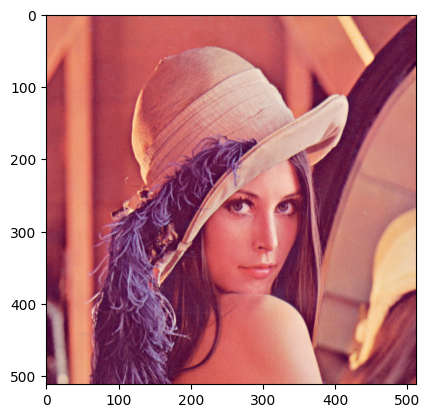

In [3]:
# Leemos la imagen
lena1 = io.imread('lena.png')
# Imprimimos su tamaño
print('Tamaño de la image:', lena1.shape)
# Valores mínimos y máximos de la imagen
print('Valores mínimo y máximo:', lena1.min(),'|', lena1.max())
# Tipo
print('Tipo:', lena1.dtype)

# Mostramos la imagen
plt.imshow(lena1)
plt.show()

2. Lea la imagen *'lena.png'*, usando el parámetro *'asgray=True'*; llamémosle lena2.
Escriba por pantalla su tamaño, sus valores mínimo y máximo, y su tipo. Visualice la imagen, consiguiendo que se vea en escala de grises.

Tamaño de la imagen: (512, 512)
Valores mínimo y máximo: 0.07254666666666666 | 0.9654356862745097
Tipo: float64


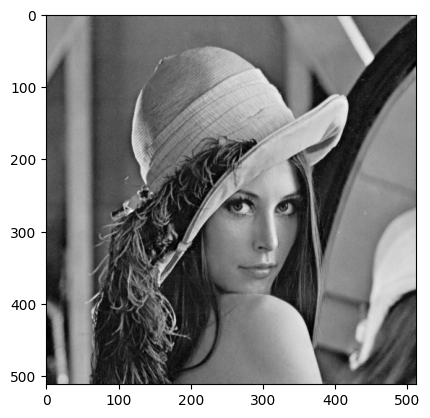

In [4]:
# Leemos la imagen
lena2 = io.imread('lena.png', as_gray=True)
# Imprimimos su tamaño
print('Tamaño de la imagen:', lena2.shape)
# Valores mínimos y máximos de la imagen
print('Valores mínimo y máximo:', lena2.min(), '|', lena2.max())
# Tipo
print('Tipo:', lena2.dtype)

# Mostramos la imagen
plt.imshow(lena2, cmap='gray')
plt.show()

- **Conclusión**: 

    Al utilizar el parámetros *as_gray = True*, se convierte al formato float64 y los valores de los píxeles pasan a estar en el rango $[0, 1]$.

    Para visualizar en escala de grises se utiliza el parámetro *cmap='gray'* en la función *imshow* de matplotlib.

3. Divida el valor de la imagen lena2 por 2 y súmele 0,25; llamémosle lena3 al resultado. Escriba por pantalla sus valores mínimo y máximo. Visualice en subfiguras anexas lena2 y lena3, usando escala de grises, y consiguiendo que las diferencias de brillo sean apreciables visualmente.

Valores mínimo y máximo: 0.2862733333333333 | 0.7327178431372549


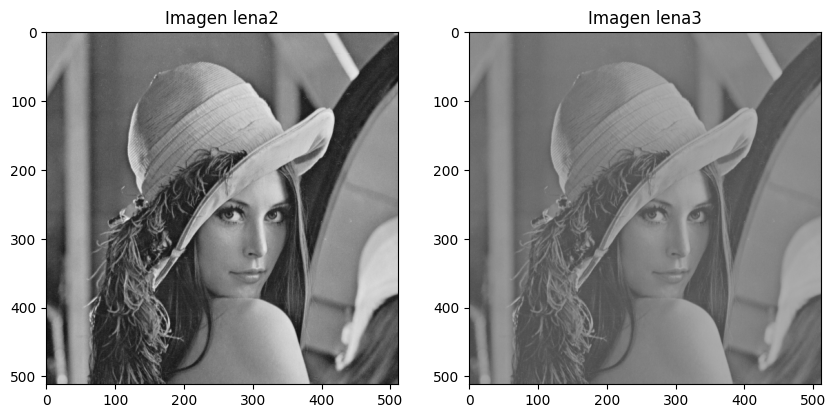

In [5]:
lena3 = lena2 / 2 + 0.25
print('Valores mínimo y máximo:', lena3.min(), '|', lena3.max())

# Mostramos las imágenes
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(lena2, cmap='gray', vmin = 0, vmax = 1)
ax[0].set_title('Imagen lena2')
ax[1].imshow(lena3, cmap='gray', vmin = 0, vmax = 1)
ax[1].set_title('Imagen lena3')
plt.show()

- **Conclusión**: 

    La imagen _lena3_ tiene menor contraste que _lena2_, hay menos diferencia en el gris de las zonas claras y las oscuras. Como vimos antes, al cargar la imagen en escala de grises, el tipo de dato es float64 (rango 0-1). Al dividir por dos estamos comprimiendo la escala de grises (los negros se hacen un poco más negros y los blancos se hacen mucho más oscuros). En un primer lugar estaríamos moviendo los valores a un rango aproximado de $0 - 0.5$. Con la segunda operación, suma de $0.25$, simplemente desplazamos los valores del histograma, es decir viendo este rango comprimido con grises más claros, en un rango aproximado de $0.25 - 0.75.$

    Visualmente, las zonas más claras serán algo más oscuras y las zonas oscuras serán algo más claras.

####  Ejercicio 1.2.- Escribir imágenes en disco

1. Guarde las imágenes lena2 y lena3 del Ejercicio 1.1, en los ficheros *lena2.png* y *lena3.png*, respectivamente, de la carpeta resultados. Asegúrese de que la diferencia de intesidades es apreciable en las imágenes guardadas (con un visor externo, o volviendolas a leer).

Valores mínimo y máximo de lena2_res: 18 | 246
Valores mínimo y máximo de lena3_res: 73 | 187


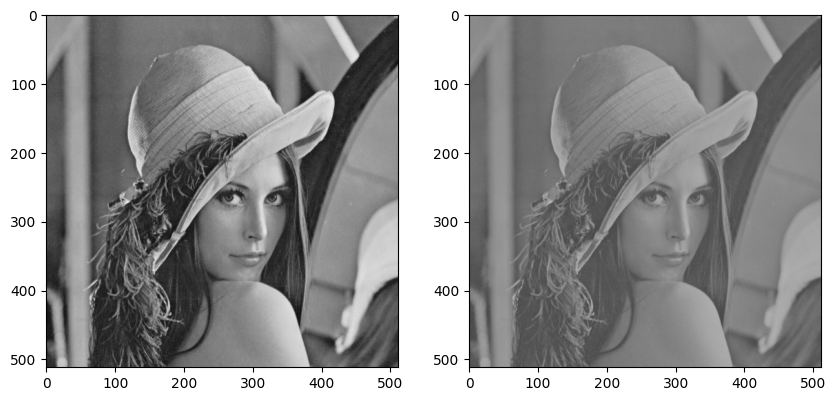

In [6]:
# Para el guardado de las imágenes es necesario tranformarlas a tipo unit8
io.imsave('resultados/lena2.png', img_as_ubyte(lena2)) 
io.imsave('resultados/lena3.png', img_as_ubyte(lena3))

lena2_res = io.imread('resultados/lena2.png')
lena3_res = io.imread('resultados/lena3.png')

# Valores mínimo y máximo de las imágenes guardadas en la carpeta resultados
print('Valores mínimo y máximo de lena2_res:', lena2_res.min(), '|', lena2_res.max())
print('Valores mínimo y máximo de lena3_res:', lena3_res.min(), '|', lena3_res.max())

# Mostramos las imágenes guardadas en la carpeta resultados
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(lena2_res, cmap='gray', vmin = 0, vmax = 255) # 255 porque es uint8
ax[1].imshow(lena3_res, cmap='gray', vmin = 0, vmax = 255) # 255 porque es uint8
plt.show()

- **Conclusión**: 

    Como se puede ver en los valores mínimo y máximo y en las imágenes mostradas, se sigue viendo la diferencia de intensidades tras el guardado de las imágenes, aunque el rango ahora sea $[0-255]$ al convertirse a uint8 para poder guardarlas.

2. Repita la operación anterior, pero multiplicando antes las imágenes por 10, y almacenando los resultados en *lena2b.png* y *lena3b.png*, respectivamente. ¿Qué ocurre y por qué? ¿Cómo debemos hacer para que las diferencias en las imágenes se puedan almacenar?

In [16]:
lena2b = lena2 * 10
lena3b = lena3 * 10

print('Valores mínimo y máximo de lena2b:', lena2b.min(), '|', lena2b.max())
print('Valores mínimo y máximo de lena3b:', lena3b.min(), '|', lena3b.max())

# Código utilizado anteriormente que da error:
### io.imsave('resultados/lena2b.png', img_as_ubyte(lena2b))
### io.imsave('resultados/lena3b.png', img_as_ubyte(lena3b))

Valores mínimo y máximo de lena2b: 0.7254666666666666 | 9.654356862745097
Valores mínimo y máximo de lena3b: 2.8627333333333334 | 7.327178431372548


- **Conclusión**:

    Si repetimos exactamente la operación anterior pero multiplicando por 10, el código de guardado de las imágenes nos da un error. Concretamente el error se corresponde con que las imágenes modificadas no están dentro del rango válido $(-1, 1)$. El valor de cada pixel será mayor que estos límites y no se podrá converitr a uint8 con `img_as_ubyte` para guardarlas.

    Código que provoca error:

    ```python
    io.imsave('resultados/lena2b.png', img_as_ubyte(lena2b))
    io.imsave('resultados/lena3b.png', img_as_ubyte(lena3b))
    ```

    Para poder solucionar esto, es necesario normalizar las imágenes, es decir, hacer que los valores de los píxeles estén dentro del rango $[0, 1]$ para poder guardarlas.

Valores mínimo y máximo de lena2b_res: 19 | 255
Valores mínimo y máximo de lena3b_res: 100 | 255


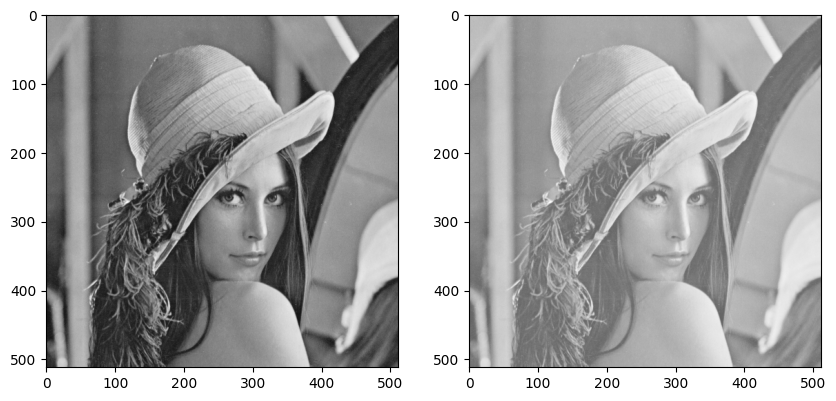

In [17]:
# Normalizamos al rango [0, 1] para poder guardar la imagen
lena2b_norm = lena2b / lena2b.max()
lena3b_norm = lena3b / lena3b.max()

# Guardamos las imágenes pasando a uint8 (0-255)
io.imsave('resultados/lena2b.png', img_as_ubyte(lena2b_norm)) 
io.imsave('resultados/lena3b.png', img_as_ubyte(lena3b_norm))

# Leemos las imágenes guardadas en la carpeta resultados
lena2b_res = io.imread('resultados/lena2b.png')
lena3b_res = io.imread('resultados/lena3b.png')

# Valores mínimo y máximo de las imágenes guardadas en la carpeta resultados
print('Valores mínimo y máximo de lena2b_res:', lena2b_res.min(), '|', lena2b_res.max())
print('Valores mínimo y máximo de lena3b_res:', lena3b_res.min(), '|', lena3b_res.max())

# Mostramos las imágenes guardadas en la carpeta resultados
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(lena2b_res, cmap='gray', vmin = 0, vmax = 255)
ax[1].imshow(lena3b_res, cmap='gray', vmin = 0, vmax = 255)
plt.show()

- **Aclaración**:

    Si quisieramos mantener la diferencia entre las imágenes exactamente igual dividiríamos entre 10 antes de guardar, pero esto sería exactamente lo mismo que el ejecicio anterior. 

    Para normalizar las imágenes dividimos entre el valor máximo de la imagen, de forma que entra en el rango $[0,1]$.

- **Conclusión**:

    Al multiplicar por 10, aunque luego se normalicen las imágenes, el resultado es más claro, ya que el histograma se expande. No es lo mismo que si hicieramos una suma, que la normalización desharía el cambio por completo.

#### Ejercicio 1.3.- Enteros, Flotantes y Booleanos

In [7]:
def intensity_gradient(size=(100, 100), dtype=np.uint8, values=(0, 255)):
    rows, cols = size
    mn, mx = values
    result = np.linspace(mn, mx, rows*cols).reshape(rows, cols)
    return result.astype(dtype)

1. Cree tres imágenes de degradado, de tamaño $100 × 100$, y:
    - A: tipo *np.float64*, y valores de 0.1 a 0.9.
    - B: tipo *np.uint8*, y valores de 25 a 230.
    - C: tipo *np.int32*, y valores de -230 a 230.

In [8]:
gradient_A = intensity_gradient(size=(100, 100), dtype=np.float64, values=(0.1, 0.9))
gradient_B = intensity_gradient(size=(100, 100), dtype=np.uint8, values=(25, 230))
gradient_C = intensity_gradient(size=(100, 100), dtype=np.int32, values=(-230, 230))

 2. Visualice las tres imágenes, en escala de grises y sin normalizar, y reporte su valor
 mínimo y máximo.

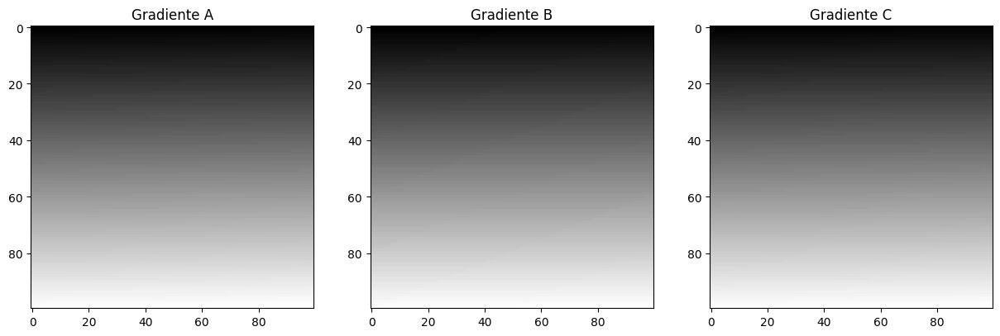

Valores mínimo y máximo de A: 0.1 | 0.9
Valores mínimo y máximo de B: 25 | 230
Valores mínimo y máximo de C: -230 | 230


In [11]:
# Mostramos las imágenes
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].imshow(gradient_A, cmap='gray')
ax[0].set_title('Gradiente A')
ax[1].imshow(gradient_B, cmap='gray')
ax[1].set_title('Gradiente B')
ax[2].imshow(gradient_C, cmap='gray')
ax[2].set_title('Gradiente C')
plt.show()

# --- Descomentar para visualizar sin que la función normalice por defecto ---
# ----------------------------------------------------------------------------
# fig, ax = plt.subplots(1, 3, figsize=(15, 5))
# ax[0].imshow(gradient_A, cmap='gray', vmin = 0, vmax = 1)
# ax[0].set_title('Gradiente A')
# ax[1].imshow(gradient_B, cmap='gray', vmin = 0, vmax = 255)
# ax[2].imshow(gradient_C, cmap='gray', vmin = np.iinfo(np.int32).min, vmax = np.iinfo(np.int32).max)
# ax[2].set_title('Gradiente C')

print('Valores mínimo y máximo de A:', gradient_A.min(), '|', gradient_A.max())
print('Valores mínimo y máximo de B:', gradient_B.min(), '|', gradient_B.max())
print('Valores mínimo y máximo de C:', gradient_C.min(), '|', gradient_C.max())

- **Aclaración**:

    Al no establecer los límites vmin y vmax en la función, el mínimo de cada imagen será establecido como negro y el máximo como blanco, es por esto que la visualización de las imágenes es la misma para todas (aunque no normaliczamos los valores la propia función hace una normalización para la visualización). Poderíamos establecer estos límites como el mínimo y el máximo de cada tipo de dato con el código comentado.



- **Conclusión**: 

    No hay problemas con los valores negativos porque no establecemos vmin y vmax, por lo que la función por defecto normaliza la escala de grises a este rango, poniendo el -230 como negro y el 230 como blanco. 

    - Si definieramos de la siguiente forma:

        ```python
        plt.imshow(gradient_C, cmap='gray', vmin=0, vmax=255)
        ```

        La parte de la imagen de valores negativos se vería completamente negra.

    - Si definieramos de la siguiente forma:

        ```python
        plt.imshow(gradient_C, cmap='gray', vmin = np.iinfo(np.int32).min, vmax = np.iinfo(np.int32).max)
        ```

        El mínimo del tipo de dato se visualizaría como negro y el máximo del tipo de dato se vería como blanco, por lo que en este caso se perdería la visualizaión del degradado ya que -230 y 230 es un rango muy pequeño y todos los valores serían muy proximos para el amplio rango del tipo int32.
 


3. Explore el resultado de las funciones `img_as_float`, `img_as_uint8`, `img_as_int` e
`img_as_bool` de skimage sobre las tres imágenes anteriores, ası́ como la salida de
la función `skimage.dtype_limits` aplicada sobre las imágenes de entrada y salida.
Explique lo que ocurre.

- **Aclaración**: 

    La función `img_as_uint8` <u>no existe en la librería skimage</u>, las opciones disponibles son `img_as_ubyte` y `img_as_uint`. La primera convierte a uint8 y la segunda a uint16, por lo que utilizamos `img_as_ubyte` para la conversión a uint8.

c:\Users\andre\Documents\3GCED\PIVA\PIVA-Practicas\piva\Lib\site-packages\skimage\util\dtype.py:576: UserWarning: Downcasting int32 to uint8 without scaling because max value 230 fits in uint8
  return _convert(image, np.uint8, force_copy)
c:\Users\andre\Documents\3GCED\PIVA\PIVA-Practicas\piva\Lib\site-packages\skimage\util\dtype.py:552: UserWarning: Downcasting int32 to int16 without scaling because max value 230 fits in int16
  return _convert(image, np.int16, force_copy)


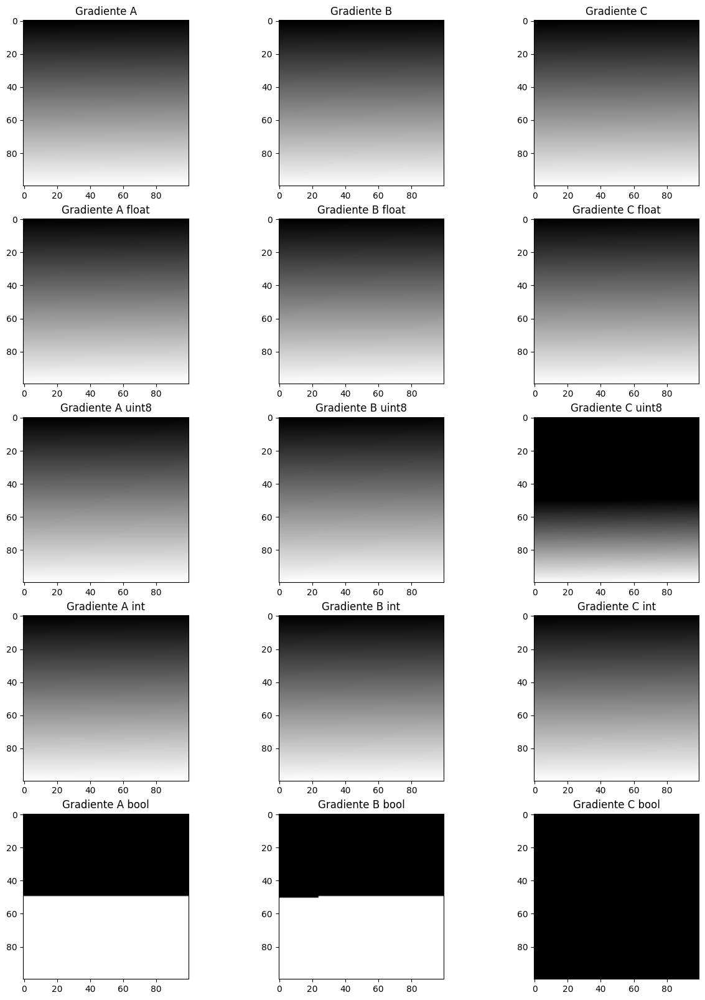

Limites A (float64): (-1, 1)
Limites B (uint8): (0, 255)
Limites C (int32): (-2147483648, 2147483647)

Limites A float: (-1, 1)
Limites B float: (-1, 1)
Limites C float: (-1, 1)

Limites A uint8: (0, 255)
Limites B uint8: (0, 255)
Limites C uint8: (0, 255)

Limites A int: (-32768, 32767)
Limites B int: (-32768, 32767)
Limites C int: (-32768, 32767)

Limites A bool: (False, True)
Limites B bool: (False, True)
Limites C bool: (False, True)


In [12]:
gradients = [gradient_A, gradient_B, gradient_C]

gradients_float = [img_as_float(g) for g in gradients]
gradients_uint8 = [img_as_ubyte(g) for g in gradients] # Función para convertir a uint8
gradients_int = [img_as_int(g) for g in gradients]
gradients_bool = [img_as_bool(g) for g in gradients]

# Mostramos las imágenes
fig, ax = plt.subplots(5, 3, figsize=(15, 20))
for i in range(3):
    ax[0, i].imshow(gradients[i], cmap='gray')
    ax[0, i].set_title('Gradiente ' + chr(65+i))
    ax[1, i].imshow(gradients_float[i], cmap='gray')
    ax[1, i].set_title('Gradiente ' + chr(65+i) + ' float')
    ax[2, i].imshow(gradients_uint8[i], cmap='gray')
    ax[2, i].set_title('Gradiente ' + chr(65+i) + ' uint8')
    ax[3, i].imshow(gradients_int[i], cmap='gray')
    ax[3, i].set_title('Gradiente ' + chr(65+i) + ' int')
    ax[4, i].imshow(gradients_bool[i], cmap='gray')
    ax[4, i].set_title('Gradiente ' + chr(65+i) + ' bool')
plt.show()

# Entrada y salida de la función dtype_limits
print('Limites A (float64):', dtype_limits(gradient_A))
print('Limites B (uint8):', dtype_limits(gradient_B))
print('Limites C (int32):', dtype_limits(gradient_C))
print('')
print('Limites A float:', dtype_limits(gradients_float[0]))
print('Limites B float:', dtype_limits(gradients_float[1]))
print('Limites C float:', dtype_limits(gradients_float[2]))
print('')
print('Limites A uint8:', dtype_limits(gradients_uint8[0]))
print('Limites B uint8:', dtype_limits(gradients_uint8[1]))
print('Limites C uint8:', dtype_limits(gradients_uint8[2]))
print('')
print('Limites A int:', dtype_limits(gradients_int[0]))
print('Limites B int:', dtype_limits(gradients_int[1]))
print('Limites C int:', dtype_limits(gradients_int[2]))
print('')
print('Limites A bool:', dtype_limits(gradients_bool[0]))
print('Limites B bool:', dtype_limits(gradients_bool[1]))
print('Limites C bool:', dtype_limits(gradients_bool[2]))


- **Aclaraciones**:

    - Los warnings que aparecen en la conversión desde int32 a uint8 y int16 indican que se está reduciendo ("downcasting") el tipo de dato sin aplicar un escalado automático de los valores. Esto ocurre porque los valores máximos de la imagen original (en este caso, 230) entran perfectamente en los rangos del nuevo tipo (uint8 va de 0 a 255; int16 de -32768 a 32767). Al no escalar los valores, no se aprovecha todo el rango dinámico del nuevo tipo, lo cual podría afectar a la visualización. En nuestro caso, al no establecer vmin y vmax, la función `imshow` normaliza la imagen por lo que la visualización no se ve afectada.

    - La función `imshow` de matplotlib, por defecto, normaliza la imagen a un rango de $[0, 1]$ para los tipos de datos flotantes y a $[0, 255]$ para los enteros. Esto significa que si la imagen tiene valores fuera de estos rangos, se convertirán a estos límites a la hora de la visualización y el mínimo de la imagen concreta será el negro y el máximo será el blanco 

    - Tal y como se expresó anteriormente, en nuestra visualización dejamos que la función `imshow` normalice la imagen(sin establecer vmin y vmax) de forma que los valores mínimo y máximo de cada imagen ocupen todo el rango dinámico. Si establecemos los valores vmin y vmax como el mínimo y máximo de cada tipo de dato, las visualizaciones serían totalmente distintas.


- **Conclusión**:

    Las funciones utilizadas sirven para cambiar el tipo de dato de la imagen

    - En cuanto a las imágenes de salida, la mayoría de cambios en el tipo de dato no afectan al resultado visual de la imagen (teniendo en cuenta que se visualiza con la normalización citada). Sin embargo, vemos que la imagen de tipo int32 al convertirla a uint8 y a bool da resultados diferentes. 

        - En el caso de uint8, al tratarse de un tipo con un rango positivo, los valores negativos $(-230-0)$ se convierten en negros, viendose la parte superior de la imagen en negro con respecto al degradado de las demas de la fila. 
    
        - En el caso del booleano, en vez de verse media imagen blanca (1) y media imagen negra (0), toda la imagen está ocupada por el color negro. En la documentación de la función se expresa calaramente: "_The upper half of the input dtype’s positive range is True, and the lower half is False. All negative values (if present) are False_" y en este caso la mitad del tipo int32 sería 16384 y el valor máximo es 230.

    - En cuanto a los límites de entrada, el tipo de dato en el degradado A (*float64*) permitiría valores dentro de un rango de $(-1,1)$. Los valores en B (*uint8*) están dentro del rango (0, 255) siendo $2^8-1 = 255$. El 0 representa el negro puro y 255 el blanco. En el caso de C (*int32*) este rango va desde $-(2^{32}/{2})-1$ a $(2^{32}/{2})-1 = (-2147483648, 2147483647)$.

    - En cuanto a los límites de las salidas, con la transformación a float el rango numérico del tipo de dato es $(-1,1)$, a unit8 sería $(0, 255)$, en el caso de int $(-32768, 32767)$ y en bool es $True$ (blanco) o $False$ (negro).

#### Ejercicio 1.4 - Indexación

Considerando las imágenes _data.brick()_ y _data.astronaut()_, convertidas a números flotantes en un rango apropiado:

In [13]:
# Convertimos las imágenes a números flotantes
brick = data.brick()
brick_float = img_as_float(brick)

astronaut = data.astronaut()
astronaut_float = img_as_float(astronaut)

1. Sobre una copia de brick, asigne un valor de intensidad "blanco puro", a la ventana
definida por las filas 100 a 150, y las columnas 20 a 120. Visualice el resultado, su
valor máximo, su valor mínimo y el tipo.

Valores mínimo y máximo antes de asignar el "blanco puro": 0.24705882352941178 | 0.8117647058823529


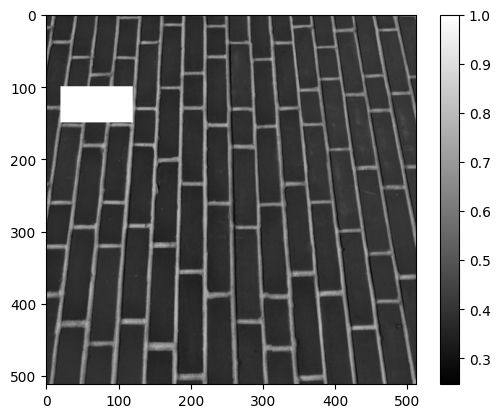

Valores mínimo y máximo: 0.24705882352941178 | 1.0
Tipo: float64


In [14]:
brick_copy = brick_float.copy()
print('Valores mínimo y máximo antes de asignar el "blanco puro":', brick_copy.min(), '|', brick_copy.max())

# Asignamos un valor de intensidad "blanco puro" a la ventana definida
brick_copy[100:150, 20:120] = 1

# Mostramos la imagen
plt.imshow(brick_copy, cmap='gray')
plt.colorbar()
plt.show()

# Valores mínimo y máximo de la imagen
print('Valores mínimo y máximo:', brick_copy.min(), '|', brick_copy.max())

# Tipo
print('Tipo:', brick_copy.dtype)

2. Cree una máscara binaria (llamémosle brickmsk) que valga 1 en las posiciones donde
brick sea mayor que el 50% del rango dinámico y 0 en el resto. Visualice el resultado,
así como su valor máximo, su valor mínimo y el tipo.

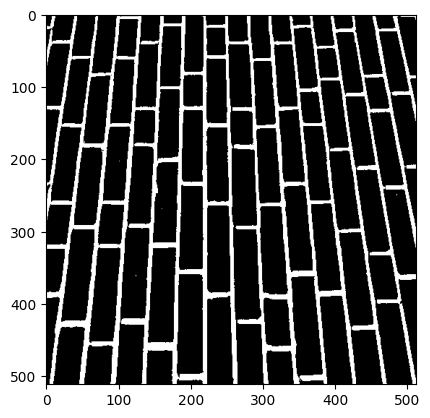

Valores mínimo y máximo: False | True
Tipo: bool


In [15]:
# Creamos la máscara binaria a partir de la imagen original (sin el "blanco puro")
brickmsk = brick_float > 0.5 # El 50% del rango dinámico es 0.5

# Mostramos la imagen
plt.imshow(brickmsk, cmap='gray')
plt.show()

# Valores mínimo y máximo de la imagen y tipo
print('Valores mínimo y máximo:', brickmsk.min(), '|', brickmsk.max())
print('Tipo:', brickmsk.dtype)

- **Aclaración:**

    Con una simple comparación obtenemos la máscara binaria, ya que los puntos que cumplen la condición son True (1) y los que no False(0). La comparación se hace sobre 0.5 ya que el rango dinámico de la imagen es $[0, 1]$. Hacer esta comparación en vez de una transformación numérica hace que la imagen se convierta a tipo bool. Si queremos mantener el tipo como numérico (entero), podemos multiplicar por 1.0.
    ```python
    brickmsk = (brick_float > 0.5)*1
    ```

    Tambien podemos utilizar el siguiente código para obtener la máscara binaria:
    ```python
    brickmsk = np.where(brick_float > 0.5, 1, 0)
    ```


- **Conclusión:**

    Estamos convirtiendo aquellos valores que están por encima de 0.5 en True y aquellos que están por debajo en False. Los blancos y grises claros se convierten en blanco puro y los grises oscuros y negros se convierten en negro puro, ya que True se codifica como 1 y False como 0

3. Modifique los valores de una copia de astronaut para tomen un valor [r,g,b] aleatorio en las posiciones indicadas por la máscara _brickmsk_

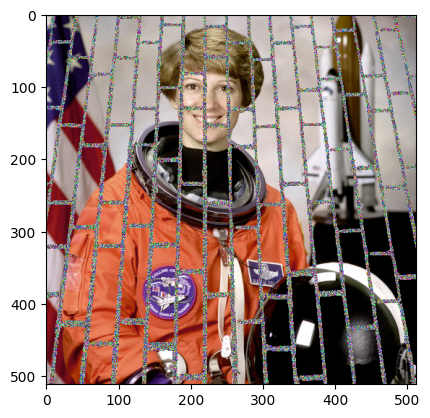

In [16]:
astronaut_copy = astronaut_float.copy()

# Utilizando la máscara brickmsk
for fila in range(astronaut_copy.shape[0]):
    for columna in range(astronaut_copy.shape[1]):
        if brickmsk[fila, columna]==1:
            # Asignamos un valor aleatorio entre 0 y 1 a cada canal de color (RGB)
            astronaut_copy[fila, columna] = np.random.rand(3) 

# Mostramos la imagen
plt.imshow(astronaut_copy)
plt.show()

4. Usando una copia de astronaut, visualice, en cuatro subfiguras, cada uno de sus canales RGB, en escala de grises, junto con la imagen en color.

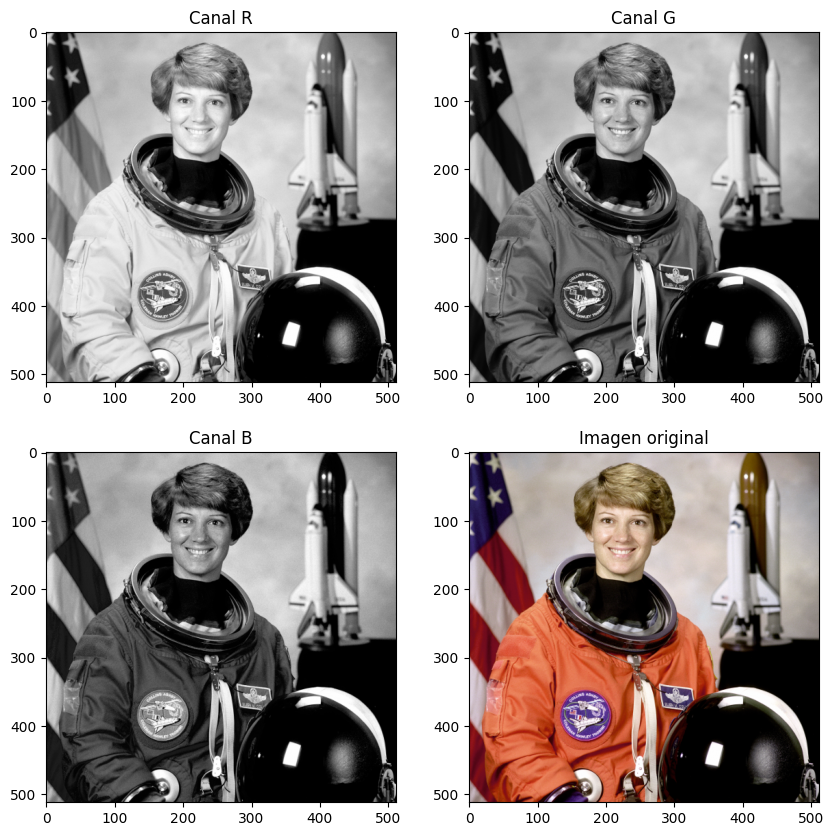

In [33]:
# astronaut_float es la imagen original
astronaut_4 = astronaut_float.copy()

# Mostramos las imágenes
fig, ax = plt.subplots(2, 2, figsize=(10, 10))
ax[0, 0].imshow(astronaut_4[:,:,0], cmap='gray')
ax[0, 0].set_title('Canal R')
ax[0, 1].imshow(astronaut_4[:,:,1], cmap='gray')
ax[0, 1].set_title('Canal G')
ax[1, 0].imshow(astronaut_4[:,:,2], cmap='gray')
ax[1, 0].set_title('Canal B')
ax[1, 1].imshow(astronaut_4)
ax[1, 1].set_title('Imagen original')
plt.show()

- **Conclusión**: 

    La imagen en color tiene 3 valores correspondientes a la intensidad de cada canal (R,G,B), estamos visualizando estos valores de intensidad por separado en escala de grises. Los grises claros significarán que en la imagen original, esa componente tiene un valor alto de intensidad. Podemos analizar esto fijandonos en los colores de la bandera y como se visualiza cada canal.

5. Usando la función `skimage.draw.diskb`, obtenga las coordinadas de un círculo en una posición aleatoria del espacio 512×512, y radio 20. Modifique la imagen resultante del apartado (c) para que los valores del canal verde en las posiciones del círculo sean 100% del rango dinámico, dejando el resto de valores sin cambiar.Visualize el resultado.

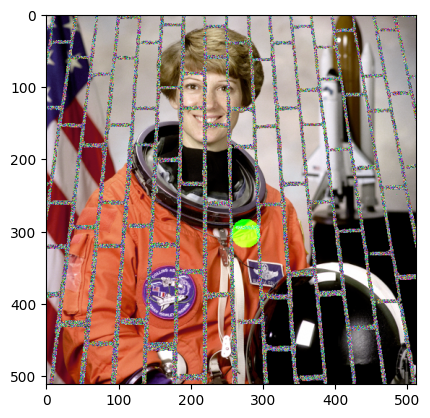

In [19]:
# Coordenadas del círculo
rr, cc = disk((np.random.randint(0,512), np.random.randint(0,512)), 20, shape=(512, 512))

# Trabajamos sobre la imagen astronaut_copy (la del apartado (c))
astronaut_copy2 = astronaut_copy.copy()
astronaut_copy2[rr, cc, 1] = 1 # Canal verde

# Mostramos la imagen
plt.imshow(astronaut_copy2)
plt.show()

- **Aclaración**:

    Este ejercicio se realiza sobre la imagen resultante del apartado (c). Se crea una nueva copia de la imagen *astronaut_copy* que llamamos *astronaut_copy2* de forma que si se ejecuta varias veces la celda no se sobreescriba la imagen del apartado (c) y se pueda ver un solo círculo verde en la imagen cambiando de posición cada vez que se ejecute la celda. 

- **Conclusión**: 

    Estamos marcando el canal verde como máximo en la zona de la circunferencia pero dejando los otros 2 canales con los valores originales, es por eso que no se ve un círculo uniforme del mismo color, sino que según la zona de la imagen, el color resultante de la combinación RGB será diferente.

### 2. Transformación del espacio de color

#### Ejercicio 2.1.- Espacios de color

Supongamos que queremos segmentar la vasculatura de la imagen *data.retina()*, y segmentar la mariposa de la imagen *butterfly.jpg*. Considerando cada una de estas imágenes:

Text(0.5, 1.0, 'Butterfly')

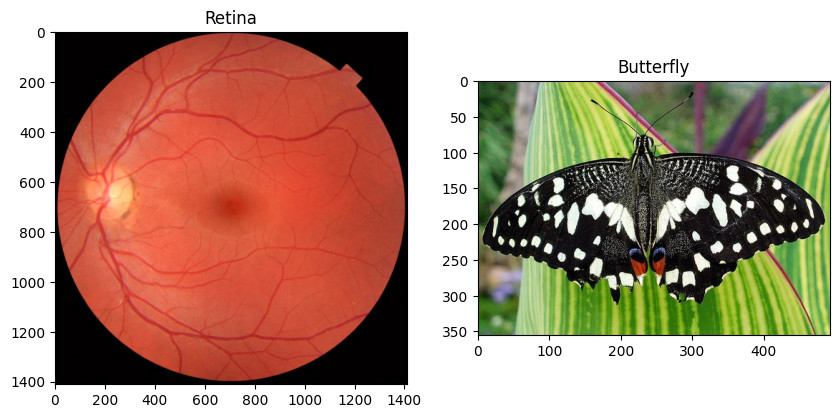

In [49]:
retina = data.retina()
butterfly = io.imread('butterfly.jpg')

# Mostramos las imágenes
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(retina)
ax[0].set_title('Retina')
ax[1].imshow(butterfly)
ax[1].set_title('Butterfly')

1. Muestre en una cuadrícula de 3×3 de subfiguras: los tres canales de RGB en escala de grises, los tres canales de CITE-Lab en escala de grises, y los tres canales de
HSV en escala de grises. Use los títulos de las figuras para indicar el nombre del canal y su rango de valores.

Text(0.5, 1.0, 'V (0-1)')

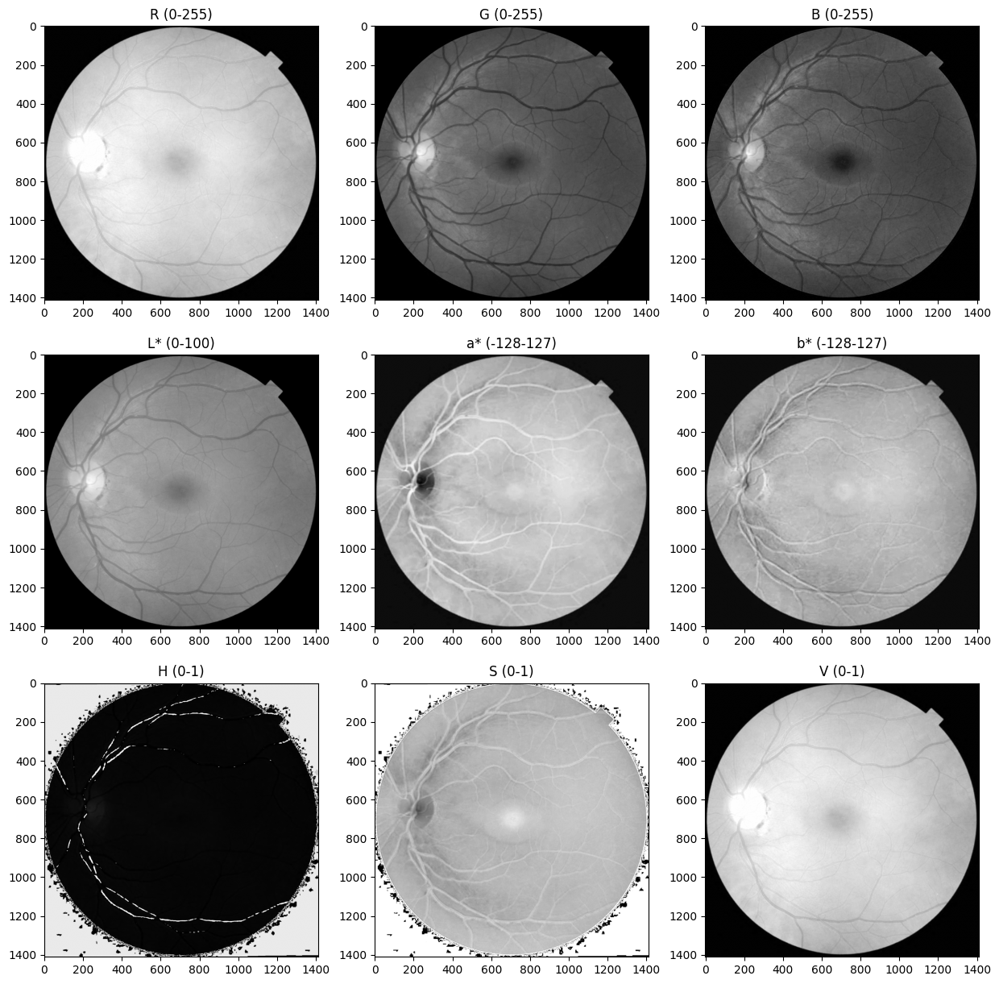

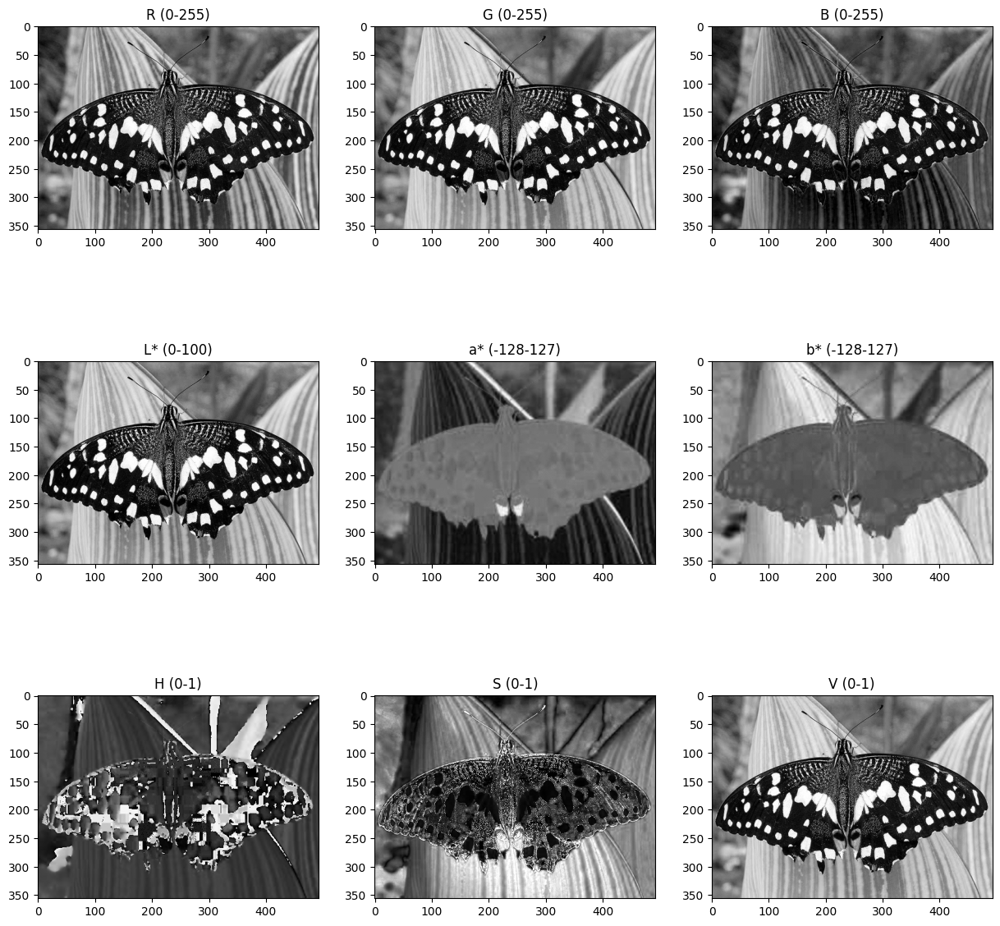

In [50]:
retina_lab = rgb2lab(retina)
retina_hsv = rgb2hsv(retina)

butterfly_lab = rgb2lab(butterfly)
butterfly_hsv = rgb2hsv(butterfly)

# Mostramos las imágenes
fig, ax = plt.subplots(3, 3, figsize=(15, 15))
ax[0, 0].imshow(retina[:,:,0], cmap='gray') 
ax[0, 0].set_title('R (0-255)')
ax[0, 1].imshow(retina[:,:,1], cmap='gray')
ax[0, 1].set_title('G (0-255)')
ax[0, 2].imshow(retina[:,:,2], cmap='gray')
ax[0, 2].set_title('B (0-255)')
ax[1, 0].imshow(retina_lab[:,:,0], cmap='gray')
ax[1, 0].set_title('L* (0-100)')
ax[1, 1].imshow(retina_lab[:,:,1], cmap='gray')
ax[1, 1].set_title('a* (-128-127)')
ax[1, 2].imshow(retina_lab[:,:,2], cmap='gray')
ax[1, 2].set_title('b* (-128-127)')
ax[2, 0].imshow(retina_hsv[:,:,0], cmap='gray')
ax[2, 0].set_title('H (0-1)')
ax[2, 1].imshow(retina_hsv[:,:,1], cmap='gray')
ax[2, 1].set_title('S (0-1)')
ax[2, 2].imshow(retina_hsv[:,:,2], cmap='gray')
ax[2, 2].set_title('V (0-1)')

# Mostramos las imágenes
fig, ax = plt.subplots(3, 3, figsize=(15, 15))
ax[0, 0].imshow(butterfly[:,:,0], cmap='gray')
ax[0, 0].set_title('R (0-255)')
ax[0, 1].imshow(butterfly[:,:,1], cmap='gray')
ax[0, 1].set_title('G (0-255)')
ax[0, 2].imshow(butterfly[:,:,2], cmap='gray')
ax[0, 2].set_title('B (0-255)')
ax[1, 0].imshow(butterfly_lab[:,:,0], cmap='gray')
ax[1, 0].set_title('L* (0-100)')
ax[1, 1].imshow(butterfly_lab[:,:,1], cmap='gray')
ax[1, 1].set_title('a* (-128-127)')
ax[1, 2].imshow(butterfly_lab[:,:,2], cmap='gray')
ax[1, 2].set_title('b* (-128-127)')
ax[2, 0].imshow(butterfly_hsv[:,:,0], cmap='gray')
ax[2, 0].set_title('H (0-1)')
ax[2, 1].imshow(butterfly_hsv[:,:,1], cmap='gray')
ax[2, 1].set_title('S (0-1)')
ax[2, 2].imshow(butterfly_hsv[:,:,2], cmap='gray')
ax[2, 2].set_title('V (0-1)')



- **Aclaración**: 

    Utilizando las funciones de la librería Skimage, el rango de salida de HSV es de [0, 1]

2. Observando los resultados: ¿Qué canal es más apropiado para la segmentación objetivo? Razone la respuesta.

- **Conclusión**:

    - Para la imagen del ojo, en RGB los canales verde y azul nos ofrecen una discriminación bastante clara de las venas de la retina. Para $Lab$ el canal L (lightness) nos ofrece una discriminación clara de las venas de la retina. En HSV el canal S (saturation) es el que da una segmentación más apropiada, pero no es tan clara como en los otros espacios de color. 

    - En cuanto a la imagen de la mariposa, en el espacio de color RGB no destacamos ningun canal sobre el otro ya que el color blanco y negro de la mariposa, todos los canales presentan un valor parecido para cada canal. El contorno de este insecto se aprecia claramente en el canal b* (con un mayor contraste respecto al fondo) para el caso de CITE-Lab y por último, para el espacio de color HSV, el canal más apropiado sería el V (value). Estas conclusiones tienen en cuenta la característica de estar tratando con una mariposa blanca y negra en un fondo de color verde, y probablemente no serían aplicables a otras mariposas.

####  Ejercicio 2.2.- Canal de color arbitrario

1. Haga una función *rand_channel* que, tomando como entrada una imagen de tres canales, obtenga como salida una imagen de un solo canal que resulta de la combinación lineal aleatoria de los tres canales.

    Es decir, si la imagen de entrada I es una matriz $N × M × 3$, y $W$ es un vector de 3 pesos aleatorios tal que $\sum W_i = 1^a$, lo que buscamos es la matriz de salida $O$, de $N × M$ elementos, que resulta de hacer producto escalar entre $I$ y $W$ a lo largo de la tercera dimensión de $I$ (e.g. con `np.dotb` o `np.matmulc`).

In [51]:
def rand_channel(image):
    W = np.random.rand(3)
    W /= W.sum() # Comprobamos que la suma de los pesos sea 1

    return np.dot(image, W)

 2. Utilice la función `rand_channel` para visualizar 6 canales aleatorios, usando como entrada las imágenes del Ejercicio 2.1.

    ¿Es alguno de estos canales aleatorios ”mejor” que cualquiera de los espacios de color del Ejercicio 2.1 para alguno de los casos? Razone la respuesta.

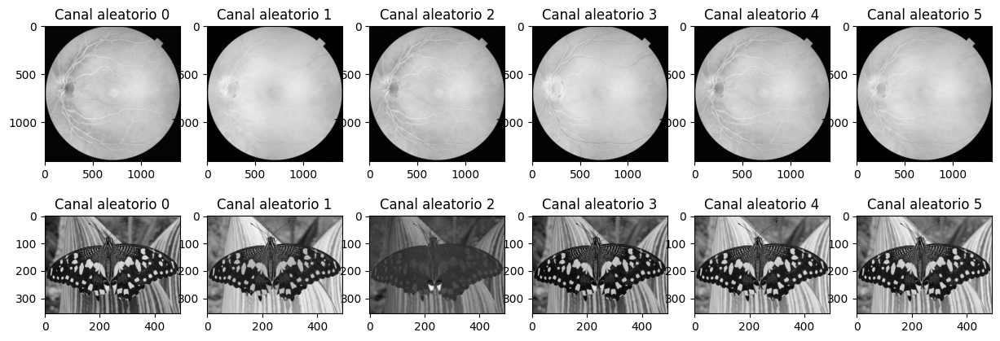

In [58]:
fig, ax = plt.subplots(2, 6, figsize=(15, 5))
for i in range(6):
    ax[0, i].imshow(rand_channel(retina_lab), cmap='gray')
    ax[1, i].imshow(rand_channel(butterfly_lab), cmap='gray')
    ax[0, i].set_title('Canal aleatorio ' + str(i))
    ax[1, i].set_title('Canal aleatorio ' + str(i))

plt.show()

- **Conclusión:**

    La creación de canales aleatorios no nos ofrece una segmentación clara de las imágenes. Para cada imagen, los diferentes canales aleatorios creados son muy similares entre ellos y ninguno resulta ser mejor que los canales seleccionados en el ejercicio 2.1. Las venas de la retina quizás se aprecian algo mejor en algunos de los canales aleatorios que en los de HSV, pero tenemos canales de mayor discriminación en el ejercicio 2.1

### 3. Histogramas y ajustes de luminosidad y contraste

####  Ejercicio 3.1.- Ajuste de contraste global

Considerando las imagenes *data.text()* y *data.page()*, represéntelas en escala de gris junto con su histograma. Compare los resultados de las siguientes técnicas de ajuste de contraste global. Visualice los resultados, junto con sus histogramas.

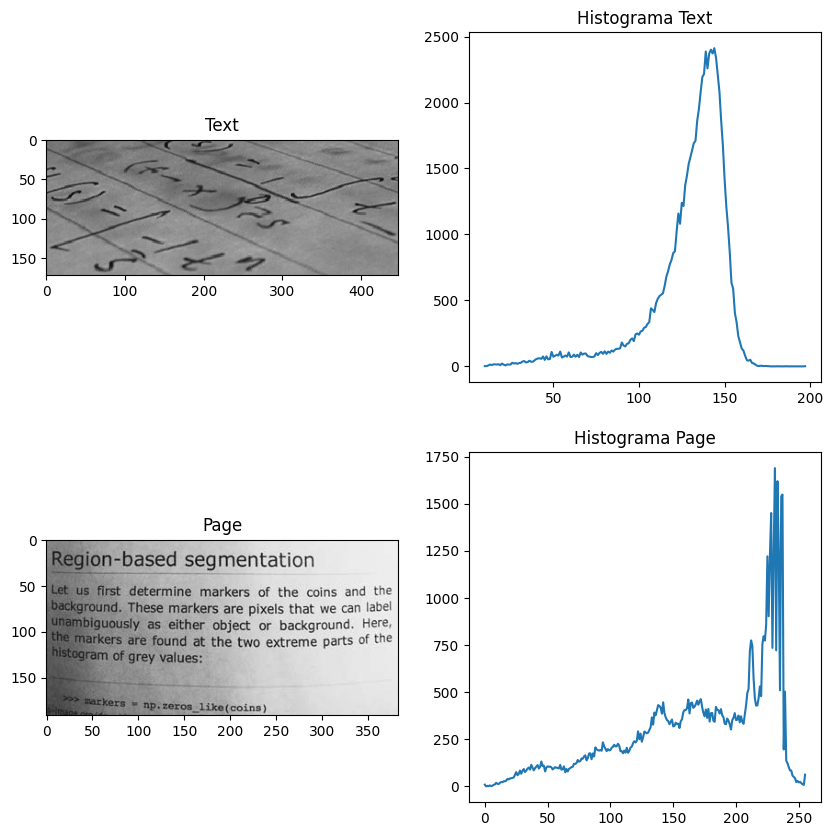

In [20]:
text = data.text()
page = data.page()

# Histograma de la imagen text
hist_text, bins_text = exposure.histogram(text)
# Histograma de la imagen page
hist_page, bins_page = exposure.histogram(page)

# Mostramos las imágenes y sus histogramas
fig, ax = plt.subplots(2, 2, figsize=(10, 10))
ax[0, 0].imshow(text, cmap='gray', vmin = 0, vmax = 255)
ax[0, 0].set_title('Text')
ax[0, 1].plot(bins_text, hist_text)
ax[0, 1].set_title('Histograma Text')
ax[1, 0].imshow(page, cmap='gray', vmin = 0, vmax = 255)
ax[1, 0].set_title('Page')
ax[1, 1].plot(bins_page, hist_page)
ax[1, 1].set_title('Histograma Page')
plt.show()

1. **Modificación lineal del rango dinámico.** Usando la función `rescale_intensity`, y expandiendo el histograma para que ocupe todo el rango dinámico disponible.

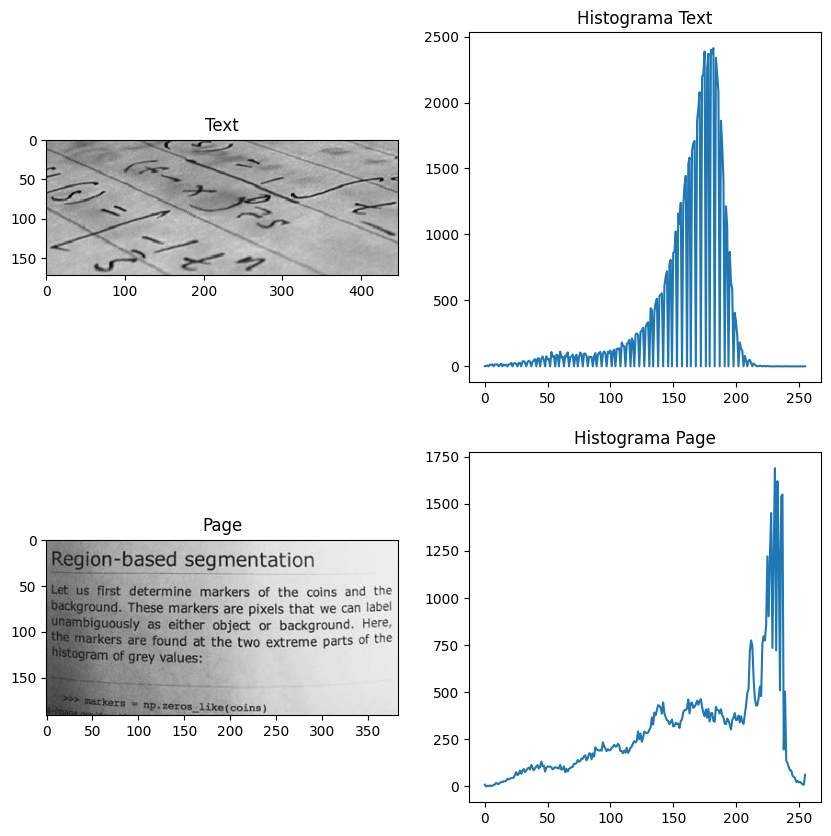

In [21]:
# Reesclamos las imagenes para que ocupen todo el rango dinámico
text_res = exposure.rescale_intensity(text, in_range='image', out_range='dtype')
page_res = exposure.rescale_intensity(page, in_range='image', out_range='dtype')

# Histograma de la imagen text_res
hist_text_res, bins_text_res = exposure.histogram(text_res)
# Histograma de la imagen page_res
hist_page_res, bins_page_res = exposure.histogram(page_res)

# Mostramos las imágenes y sus histogramas
fig, ax = plt.subplots(2, 2, figsize=(10, 10))
ax[0, 0].imshow(text_res, cmap='gray', vmin=0, vmax=255)
ax[0, 0].set_title('Text')
ax[0, 1].plot(bins_text_res, hist_text_res)
ax[0, 1].set_title('Histograma Text')
ax[1, 0].imshow(page_res, cmap='gray', vmin=0, vmax=255)
ax[1, 0].set_title('Page')
ax[1, 1].plot(bins_page_res, hist_page_res)
ax[1, 1].set_title('Histograma Page')
plt.show()

2. **Window level contrast enhancement**. Usando la función `rescale_intensity` y seleccionando un rango de entrada a mano que permita maximizar el contraste entre texto y fondo.

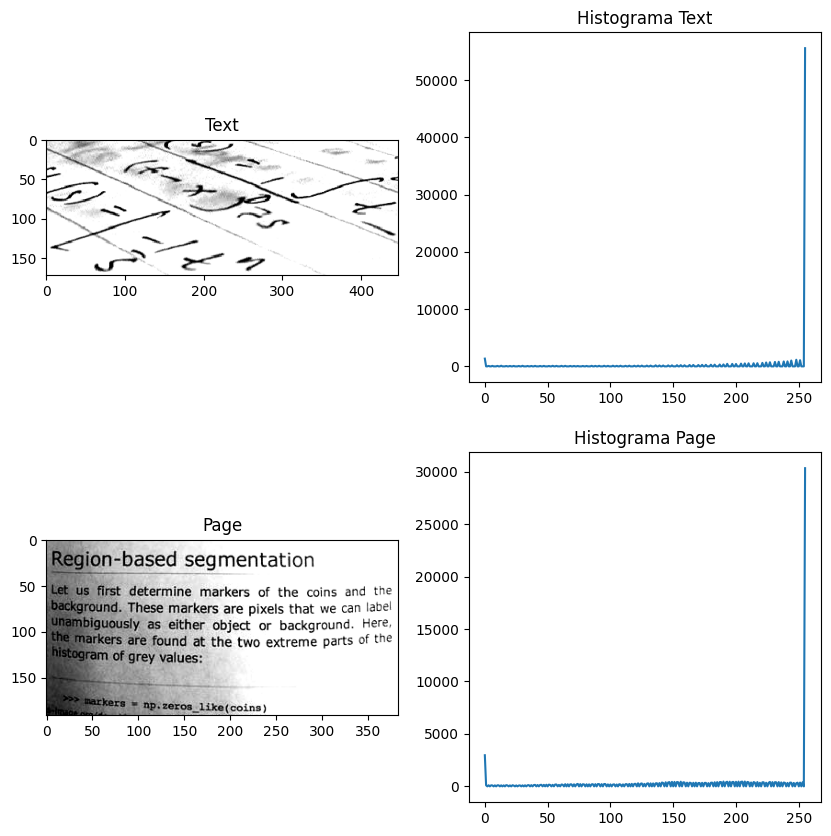

In [22]:
# Window level contrast enhancement con rescale_intensity

text_res_wl = exposure.rescale_intensity(text, in_range=(50, 125), out_range='dtype')
page_res_wl = exposure.rescale_intensity(page, in_range=(50, 200), out_range='dtype')

# Histograma de la imagen text_res_wl
hist_text_res_wl, bins_text_res_wl = exposure.histogram(text_res_wl)
# Histograma de la imagen page_res_wl
hist_page_res_wl, bins_page_res_wl = exposure.histogram(page_res_wl)

# Mostramos las imágenes y sus histogramas
fig, ax = plt.subplots(2, 2, figsize=(10, 10))
ax[0, 0].imshow(text_res_wl, cmap='gray', vmin=0, vmax=255)
ax[0, 0].set_title('Text')
ax[0, 1].plot(bins_text_res_wl, hist_text_res_wl)
ax[0, 1].set_title('Histograma Text')
ax[1, 0].imshow(page_res_wl, cmap='gray', vmin=0, vmax=255)
ax[1, 0].set_title('Page')
ax[1, 1].plot(bins_page_res_wl, hist_page_res_wl)
ax[1, 1].set_title('Histograma Page')
plt.show()

- **Comentario**: 

    En la imagen _page_ la zona de la izquierda es bastante más oscura que la de la derecha lo cual provoca una dificultad que quizás se pueda solucionar con un ajuste de contraste adaptativo

3. **Ajuste Gamma**. Usando la función `adjust_gamma` y seleccionando un valor de gamma apropiado que maximice el contraste entre texto y fondo.

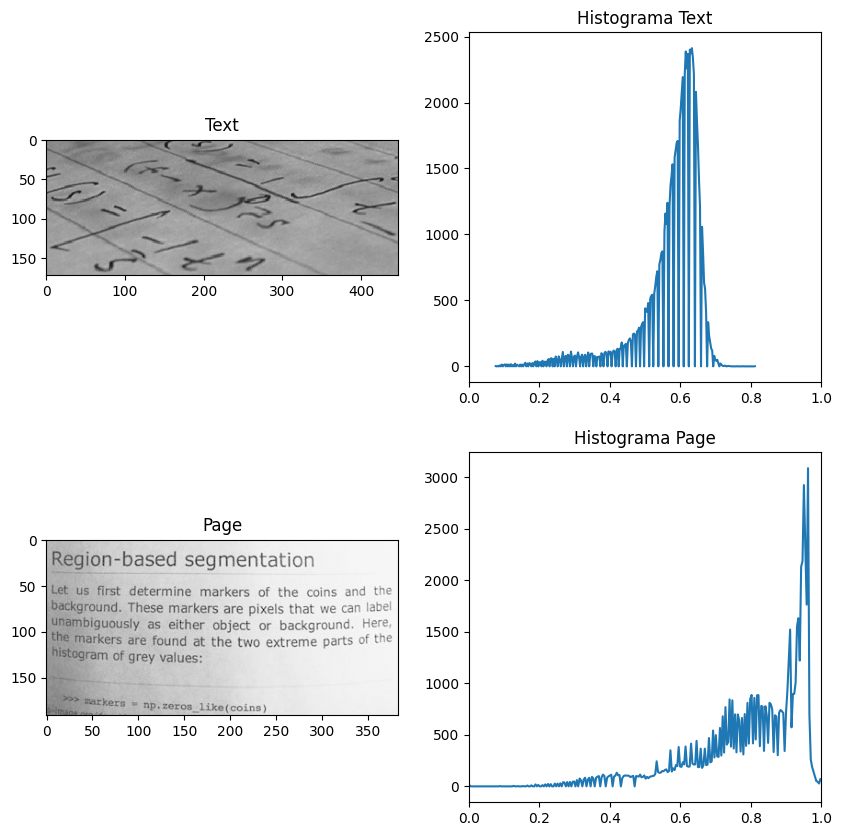

In [23]:
# Ajuste gamma usando la función adjust_gamma
text_gamma = exposure.adjust_gamma(text/255, gamma=0.8)
page_gamma = exposure.adjust_gamma(page/255, gamma=0.5)   

# Histograma de la imagen text_gamma
hist_text_gamma, bins_text_gamma = exposure.histogram(text_gamma)
# Histograma de la imagen page_gamma
hist_page_gamma, bins_page_gamma = exposure.histogram(page_gamma)

# Mostramos las imágenes y sus histogramas
fig, ax = plt.subplots(2, 2, figsize=(10, 10))
ax[0, 0].imshow(text_gamma, cmap='gray', vmin=0, vmax=1)
ax[0, 0].set_title('Text')
ax[0, 1].plot(bins_text_gamma, hist_text_gamma)
ax[0, 1].set_xlim(0, 1)
ax[0, 1].set_title('Histograma Text')
ax[1, 0].imshow(page_gamma, cmap='gray', vmin=0, vmax=1)
ax[1, 0].set_title('Page')
ax[1, 1].plot(bins_page_gamma, hist_page_gamma)
ax[1, 1].set_xlim(0, 1)
ax[1, 1].set_title('Histograma Page')
plt.show()

4. **Ajuste logarítmico**. Usando la función `adjust_log` y seleccionando unos parámetros que maximicen el contraste entre texto y fondo.

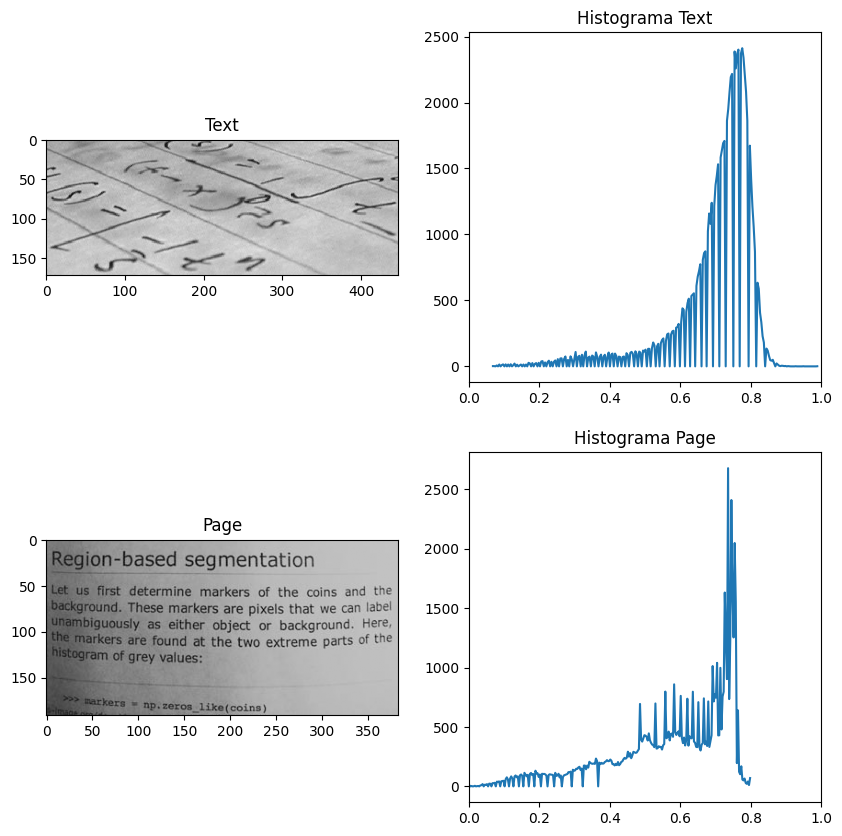

In [24]:
# Ajuste logarítmico usando la función adjust_log
text_log = exposure.adjust_log(text/255, gain=1.2)
page_log = exposure.adjust_log(page/255, gain=0.8)

# Histograma de la imagen text_log
hist_text_log, bins_text_log = exposure.histogram(text_log)
# Histograma de la imagen page_log
hist_page_log, bins_page_log = exposure.histogram(page_log)

# Mostramos las imágenes y sus histogramas
fig, ax = plt.subplots(2, 2, figsize=(10, 10))
ax[0, 0].imshow(text_log, cmap='gray', vmin=0, vmax=1)
ax[0, 0].set_title('Text')
ax[0, 1].plot(bins_text_log, hist_text_log)
ax[0, 1].set_xlim(0, 1)
ax[0, 1].set_title('Histograma Text')
ax[1, 0].imshow(page_log, cmap='gray', vmin=0, vmax=1)
ax[1, 0].set_title('Page')
ax[1, 1].plot(bins_page_log, hist_page_log)
ax[1, 1].set_xlim(0, 1)
ax[1, 1].set_title('Histograma Page')
plt.show()

5. **Ecualización del histograma**. Usando la función `equalize_hist`.

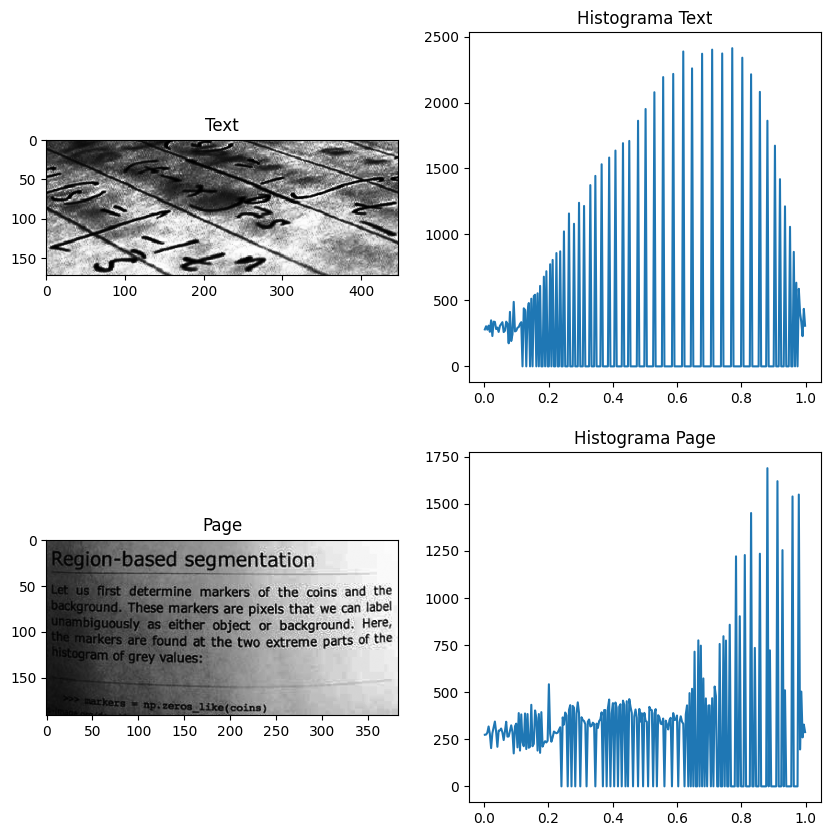

In [25]:
# Ecualización de histograma usando la función equalize_hist
text_eq = exposure.equalize_hist(text)
page_eq = exposure.equalize_hist(page)

# Histograma de la imagen text_eq
hist_text_eq, bins_text_eq = exposure.histogram(text_eq)
# Histograma de la imagen page_eq
hist_page_eq, bins_page_eq = exposure.histogram(page_eq)

# Mostramos las imágenes y sus histogramas
fig, ax = plt.subplots(2, 2, figsize=(10, 10))
ax[0, 0].imshow(text_eq, cmap='gray', vmin=0, vmax=1)
ax[0, 0].set_title('Text')
ax[0, 1].plot(bins_text_eq, hist_text_eq)
ax[0, 1].set_title('Histograma Text')
ax[1, 0].imshow(page_eq, cmap='gray', vmin=0, vmax=1)
ax[1, 0].set_title('Page')
ax[1, 1].plot(bins_page_eq, hist_page_eq)
ax[1, 1].set_title('Histograma Page')
plt.show()

 Discuta los beneficios o inconvenientes de cada una de las técnicas.


- **Conclusión:**

    - **Modificación lineal del rango dinámico**: Se expande el histograma para que ocupe todo el rango dinámico disponible. De esta forma, en _text_, como no había valores en el rango 170-255, se expande a ocupar todo el rango. El histograma se expande desplazandose la zona de mayor frecuencia a la derecha, por lo que la imagen se ve más clara. En el caso de page, no se aprecian cambios significativos porque el valor mínimo y máximo ya ocupaban casi todo el rango.

    - **Window level contrast enhancement**: Se selecciona a mano el rango de entrada para maximizar el contraste entre texto y fondo. El rango definido se expande hasta ocupar de 0 a 255 y aquellos valores menores o mayores de la ventana elegida se convierten a negro y blanco respectivamente. 
    Consiste en modificar el contraste entorno a unos valores de gris concretos. Esto funciona relativamente bien en la imagen de _text_ porque el fondo es de un nivel de gris bastante uniforme por lo que podemos escoger un rango de forma que los no incluídos se conviertan a blanco y negro, diferenciandose bien texto y fondo. En el caso de _page_, hacemos algo similar pero los resultados no son tan buenos por la caractarística de que la imagen es mas oscura en un lado que en otro.

    - **Ajuste Gamma**: El ajuste Gamma aumenta el contraste en las zonas claras. Con un valor menor que 1 hace que los valores oscuros se aclaren. En estos casos logramos que el fondo se aclare volviendose los grises casi blancos pero a cambio de que el texto (negro) también se vea más claro.

    - **Ajuste logarítmico**: El ajuste logaritmico es bastante útil cuando el fondo, como en el caso de _page_ es desigual en cuanto a grises. Las zonas oscuras se expanden y los valores altos se comprimen.

    - **Ecualización del histograma**: La ecualización del histograma no nos ofrece buenos resultados en este caso. Esto se debe a que la ecualización del histograma reparte los valores más frecuentes. En esta imagen destacan más los valores de fondo que los del texto, por lo que la ecualización no nos ofrece una mejora en la visualización de la imagen. Los diferentes grises del fondo (valores con mayor frecuencia) se intentan diferenciar, perdiendose la claridad del texto

####  Ejercicio 3.2.- Ajuste de contraste adaptativo

 Considerando las imagenes *data.text()* y *data.page()*, represéntelas en escala de gris junto con su histograma. Compare los resultados de las siguientes técnicas de ajuste de contraste local. Visualice los resultados, junto con su histograma.

1. **Ecualización adaptativa del histograma** . Usando la función `equalize_adapthist`. Explore el efecto del parámetro *kernel_size*. ¿Como influye en el resultado?

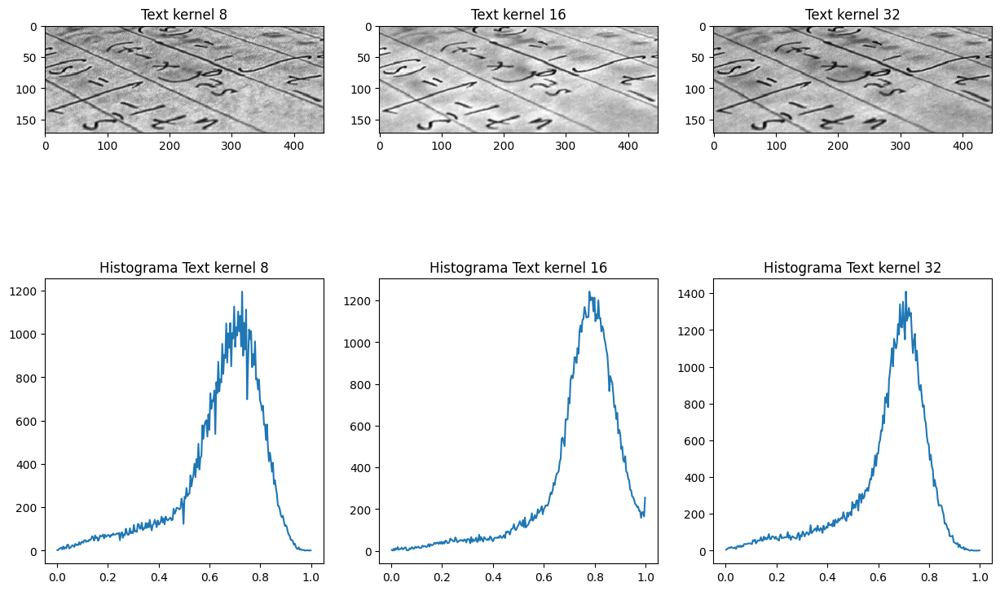

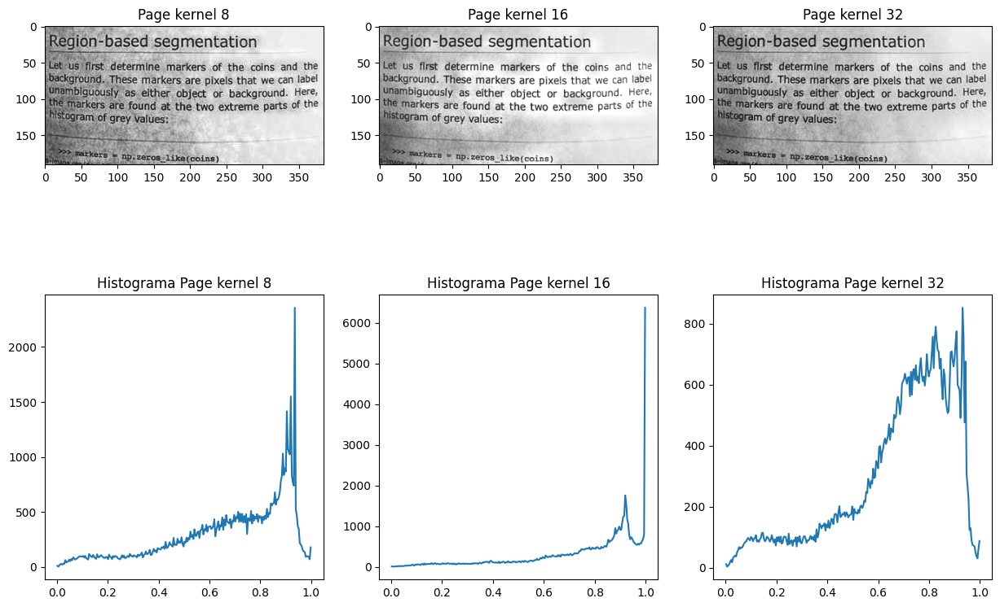

In [26]:
text_adapthist_8 = exposure.equalize_adapthist(text, kernel_size=8) # Por defecto cogería 1/8 de ancho y 1/8 de alto como tamaño de la ventana
text_adapthist_16 = exposure.equalize_adapthist(text, kernel_size=16)
text_adapthist_32 = exposure.equalize_adapthist(text, kernel_size=32)
page_adapthist_8 = exposure.equalize_adapthist(page, kernel_size=8)
page_adapthist_16 = exposure.equalize_adapthist(page, kernel_size=16)
page_adapthist_32 = exposure.equalize_adapthist(page, kernel_size=32)

# Histogramas 
hist_text_adapthist_8, bins_text_adapthist_8 = exposure.histogram(text_adapthist_8)
hist_text_adapthist_16, bins_text_adapthist_16 = exposure.histogram(text_adapthist_16)
hist_text_adapthist_32, bins_text_adapthist_32 = exposure.histogram(text_adapthist_32)
hist_page_adapthist_8, bins_page_adapthist_8 = exposure.histogram(page_adapthist_8)
hist_page_adapthist_16, bins_page_adapthist_16 = exposure.histogram(page_adapthist_16)
hist_page_adapthist_32, bins_page_adapthist_32 = exposure.histogram(page_adapthist_32)

# Mostramos las imágenes y sus histogramas
fig, ax = plt.subplots(2, 3, figsize=(15, 10))
ax[0, 0].imshow(text_adapthist_8, cmap='gray', vmin=0, vmax=1)
ax[0, 0].set_title('Text kernel 8')
ax[0, 1].imshow(text_adapthist_16, cmap='gray', vmin=0, vmax=1)
ax[0, 1].set_title('Text kernel 16')
ax[0, 2].imshow(text_adapthist_32, cmap='gray', vmin=0, vmax=1)
ax[0, 2].set_title('Text kernel 32')
ax[1, 0].plot(bins_text_adapthist_8, hist_text_adapthist_8)
ax[1, 0].set_title('Histograma Text kernel 8')
ax[1, 1].plot(bins_text_adapthist_16, hist_text_adapthist_16)
ax[1, 1].set_title('Histograma Text kernel 16')
ax[1, 2].plot(bins_text_adapthist_32, hist_text_adapthist_32)
ax[1, 2].set_title('Histograma Text kernel 32')
plt.show()

fig, ax = plt.subplots(2, 3, figsize=(15, 10))
ax[0, 0].imshow(page_adapthist_8, cmap='gray', vmin=0, vmax=1)
ax[0, 0].set_title('Page kernel 8')
ax[0, 1].imshow(page_adapthist_16, cmap='gray', vmin=0, vmax=1)
ax[0, 1].set_title('Page kernel 16')
ax[0, 2].imshow(page_adapthist_32, cmap='gray', vmin=0, vmax=1)
ax[0, 2].set_title('Page kernel 32')
ax[1, 0].plot(bins_page_adapthist_8, hist_page_adapthist_8)
ax[1, 0].set_title('Histograma Page kernel 8')
ax[1, 1].plot(bins_page_adapthist_16, hist_page_adapthist_16)
ax[1, 1].set_title('Histograma Page kernel 16')
ax[1, 2].plot(bins_page_adapthist_32, hist_page_adapthist_32)
ax[1, 2].set_title('Histograma Page kernel 32')
plt.show()

- **Conclusión**:

    En general la ecualización adaptativa obtiene mejores resultados que la ecualización global, especialmente en la segunda imagen donde, como comentamos anteriormente, hay una zona muy oscura en la parte izquierda de la imagen original.

    El tamaño del kernel define el tamaño de la ventana que se utiliza para calcular la ecualización adaptativa del histograma, es decir el segmento de píxeles que se utilizan para cada cálculo. Un kernel más grande nos dará una solución con cambios más suave ya que hace el cálculo de la ecualización se hace con más píxeles, mientras que un kernel más pequeño nos dará una ecualización más localizada. Si el valor del kernel es muy pequeño se pueden producir efectos de ruido en la imagen pero si es muy grande estaríamos perdiendo los beneficios de la ecualización adaptativa.

 2. **Control adaptativo de contraste**. Implemente una función que realice el control adaptativo de contraste lineal visto en clase. Puede usar la función `local_mean_std`, definida a continuación, para calcular las medias y desviaciones típicas locales.
 ¿Cómo influye el parámetro sigma en el resultado?

In [27]:
def local_mean_std(image, sigma=20):
    # Compute the local mean and std using Gaussians
    image = image.astype(np.float64)
    local_mean = ndi.gaussian_filter(image, sigma, mode='mirror')
    local_std = ndi.gaussian_filter(image**2, sigma, mode='mirror')
    local_std-= local_mean**2
    local_std = np.sqrt(local_std) + np.finfo(np.float64).eps
    return local_mean, local_std

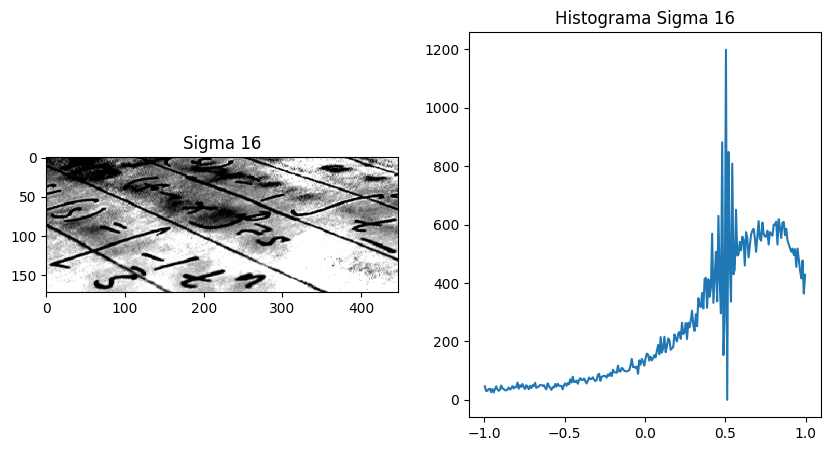

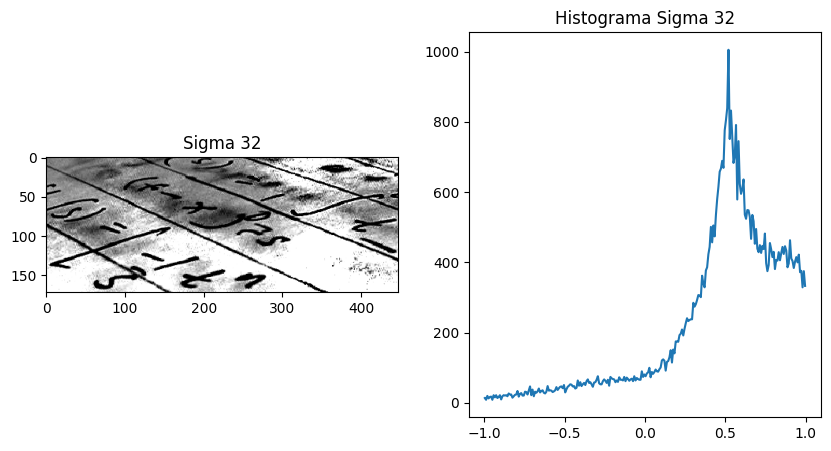

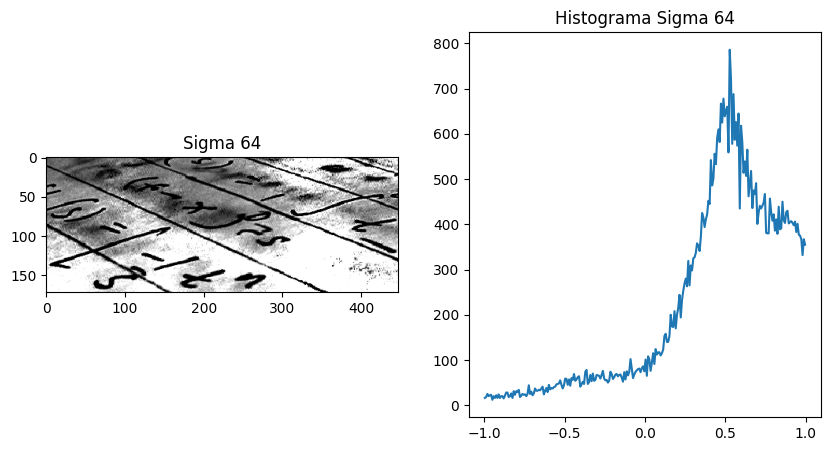

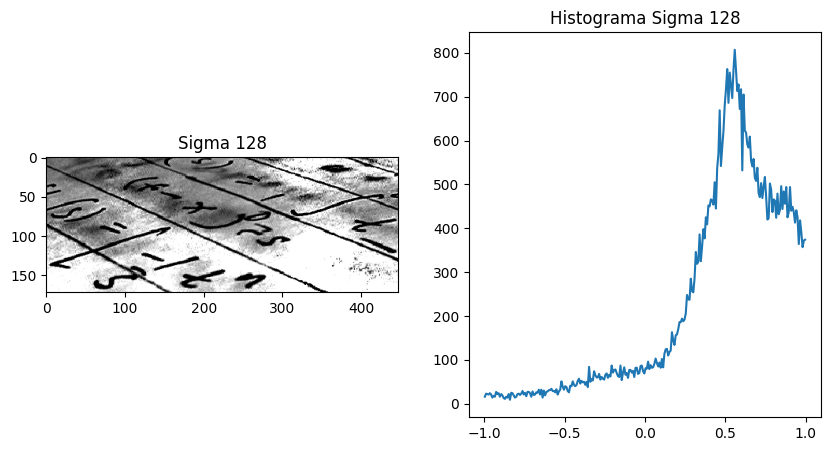

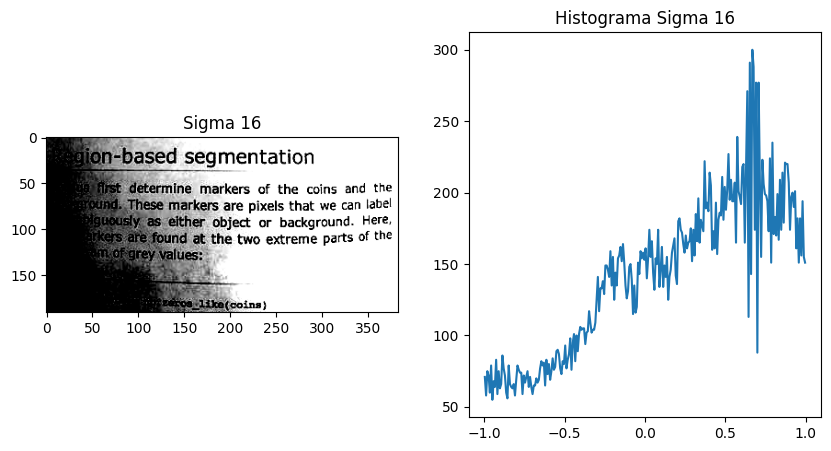

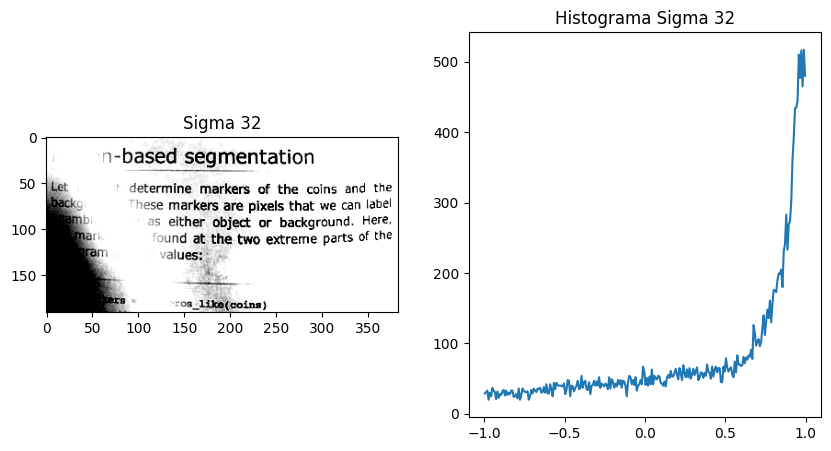

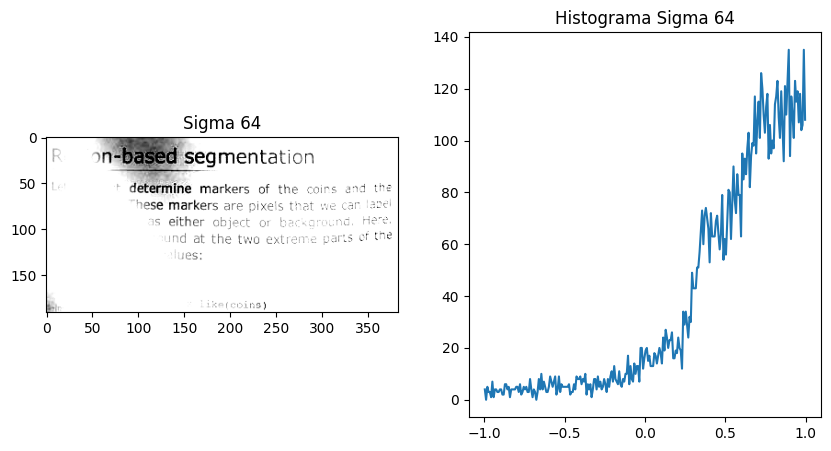

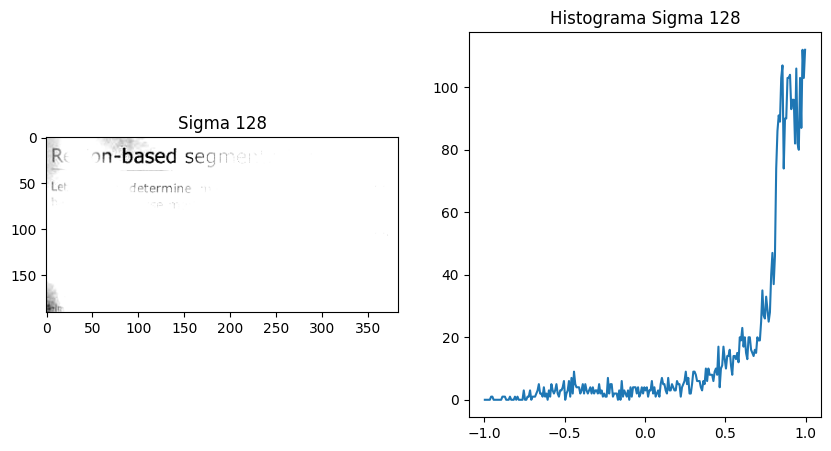

In [31]:
def control_adaptativo_contraste(image, sigmas):
    for sigma in sigmas:
        k1 = 1
        k2 = 1
        local_mean, local_std = local_mean_std(image, sigma)
        image = k1 * np.abs(local_mean/local_std)*(image - np.mean(image)) + k2 * np.mean(image)

        # Histograma de la imagen
        hist, bins = exposure.histogram(image, nbins=256, source_range='dtype')
        
        # Subplot
        fig, ax = plt.subplots(1, 2, figsize=(10, 5))
        ax[0].imshow(image, cmap='gray', vmin=0, vmax=1)
        ax[0].set_title('Sigma ' + str(sigma))
        ax[1].plot(bins, hist)
        ax[1].set_title('Histograma Sigma ' + str(sigma))
        plt.show()

control_adaptativo_contraste(text/255, [16, 32, 64, 128])
control_adaptativo_contraste(page/255, [16, 32, 64, 128])

- **Conclusión:** 

    El valor de sigma indica el tamaño de la ventana que se utiliza para calcular cada contraste local. Con un valor grande, se utiliza un área mayor y puede provocar una adaptación mas suave en toda la imagen. Un valor más pequeño se centra en áreas de menor tamaño, lograndose una adaptación más precisa en zonas concretas, preservando los detalles.

Discuta los beneficios o inconvenientes de estas técnicas con respecto a los métodos globales.

- **Beneficios:**

    - Control de detalles locales en áreas específicas.

- **Inconvenientes:**

    - Mayor complejidad computacional.
    - La elección de parámetros (kernel_size y sigma) es crítica y puede ser complicada.
    - Pueden sobre-enfatizar el ruido en áreas pequeñas.

####  Ejercicio 3.3.- Ajuste de contraste en color

Considere las imagenes de ejemplo *data.retina()* y *data.colorwheel()*. Apliqueles ecualización de histograma, mostrando los histogramas de entrada y salida para cada canal RGB por separado. ¿Por qué cambia la tonalidad? ¿Cómo podríamos hacer para ecualizar la luminosidad sin cambiar la tonalidad? Visualice ejemplos.

c:\Users\andre\Documents\3GCED\PIVA\PIVA-Practicas\piva\Lib\site-packages\skimage\_shared\utils.py:445: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


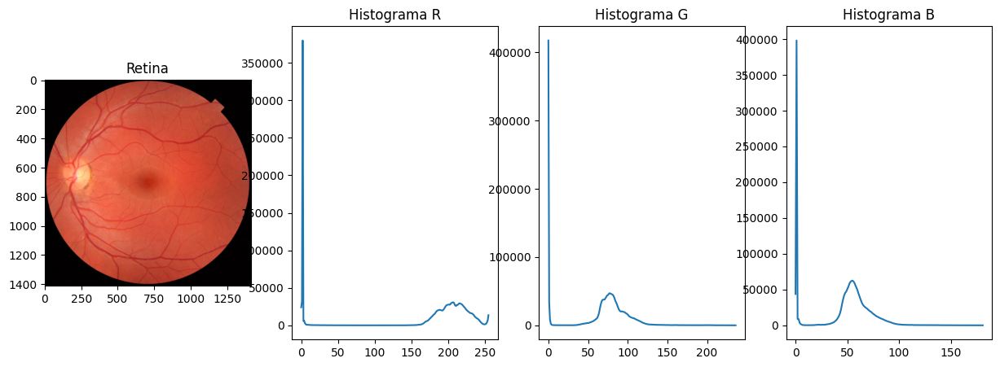

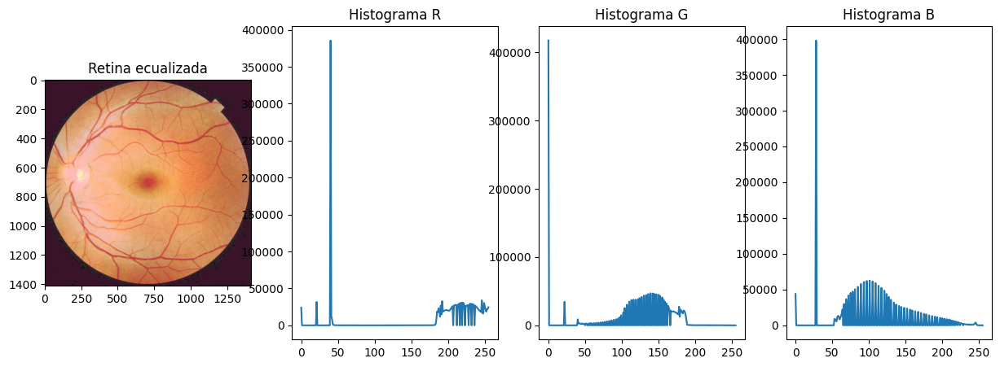

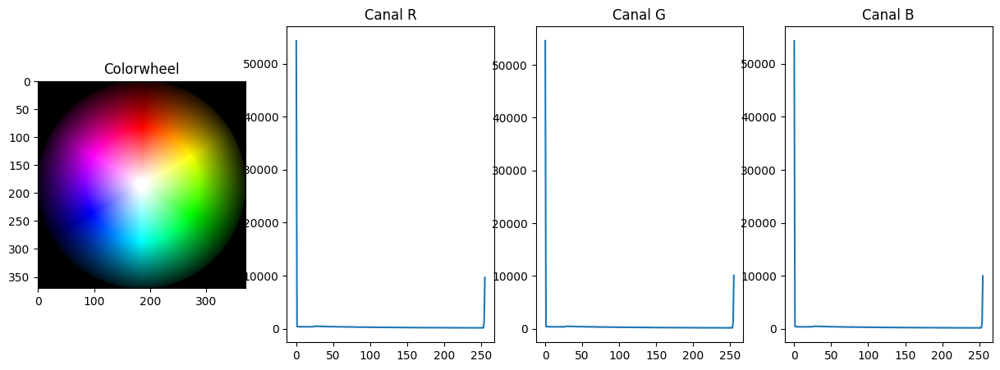

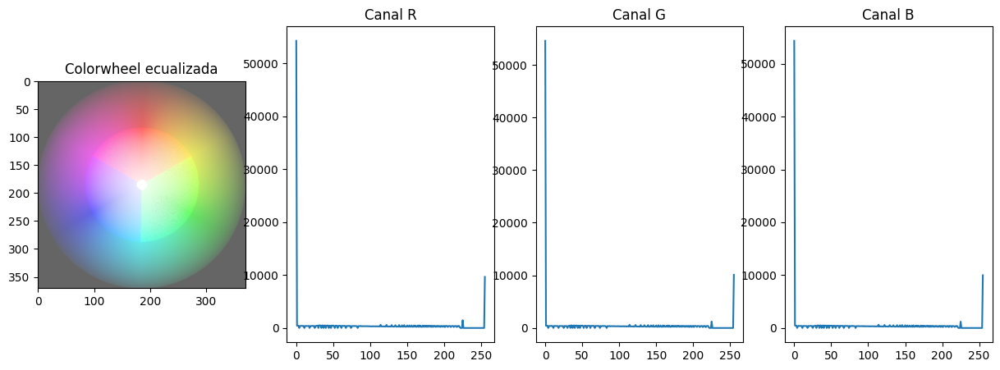

In [33]:
retina = data.retina()
colorwheel = data.colorwheel()

colores = ['R', 'G', 'B']
# Calculamos el histograma de la imagen retina para cada canal
hist_retina = [exposure.histogram(retina[:,:,i], )[0] for i in range(3)]

# Mostramos la imagen y sus histogramas
fig, ax = plt.subplots(1, 4, figsize=(15, 5))
ax[0].imshow(retina)
ax[0].set_title('Retina')
for i in range(3):
    ax[i+1].plot(hist_retina[i])
    ax[i+1].set_title('Histograma ' + colores[i])

# Ecualizamos el histograma de la imagen retina
retina_eq = exposure.equalize_hist(retina)

# Calculamos el histograma de la imagen retina_eq para cada canal
hist_retina_eq = [exposure.histogram(retina_eq[:,:,i], )[0] for i in range(3)]

# Mostramos la imagen y sus histogramas
fig, ax = plt.subplots(1, 4, figsize=(15, 5))
ax[0].imshow(retina_eq)
ax[0].set_title('Retina ecualizada')
for i in range(3):
    ax[i+1].plot(hist_retina_eq[i])
    ax[i+1].set_title('Histograma ' + colores[i])


# Calculamos el histograma de la imagen colorwheel para cada canal
hist_colorwheel = [exposure.histogram(colorwheel[:,:,i], )[0] for i in range(3)]

# Mostramos la imagen y sus histogramas
fig, ax = plt.subplots(1, 4, figsize=(15, 5))
ax[0].imshow(colorwheel)
ax[0].set_title('Colorwheel')
for i in range(3):
    ax[i+1].plot(hist_colorwheel[i])
    ax[i+1].set_title('Canal ' + colores[i])
plt.show()

# Ecualizamos el histograma de la imagen colorwheel
colorwheel_eq = exposure.equalize_hist(colorwheel)

# Calculamos el histograma de la imagen colorwheel_eq para cada canal
hist_colorwheel_eq = [exposure.histogram(colorwheel_eq[:,:,i], )[0] for i in range(3)]

# Mostramos la imagen y sus histogramas
fig, ax = plt.subplots(1, 4, figsize=(15, 5))
ax[0].imshow(colorwheel_eq)
ax[0].set_title('Colorwheel ecualizada')
for i in range(3):
    ax[i+1].plot(hist_colorwheel_eq[i])
    ax[i+1].set_title('Canal ' + colores[i])
plt.show()

- **Conclusión**:

    La tonalidad cambia porque la ecualización del histograma se realiza por separado en cada canal RGB. Se realiza una redistribución de los valores de intensidad de cada uno de los canales, lo que provoca que los colores cambien.

    Si queremos ecualizar la luminosidad sin cambiar la tonalidad, podemos convertir la imagen a un espacio de color que separe la luminosidad de la tonalidad, como por ejemplo el espacio de color Lab. En este espacio de color, la luminosidad se encuentra en el canal L y la tonalidad en los canales a y b. Podemos ecualizar el canal L.

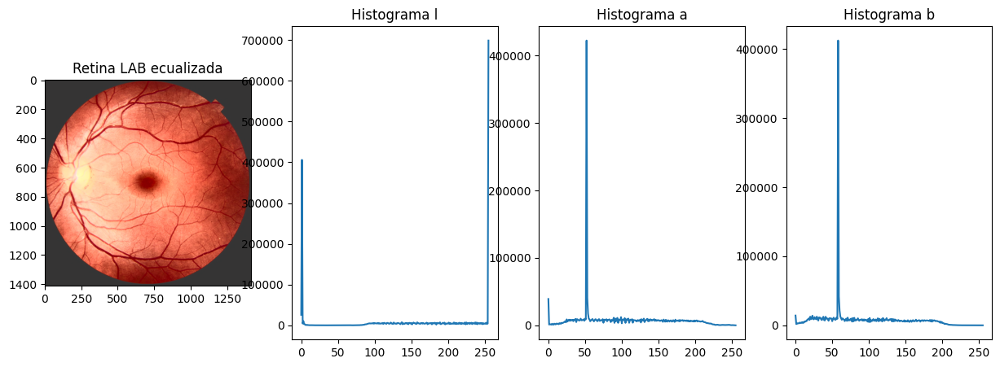

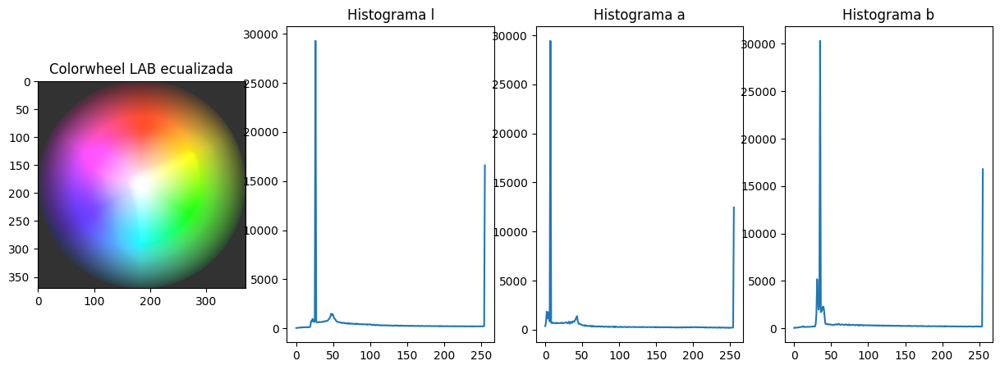

In [34]:
colores = ['l', 'a', 'b']
# Convertimos la imagen retina a espacio de color LAB
retina_lab = rgb2lab(retina)

# Ecualizamos el histograma del canal L de la imagen retina en el espacio de color LAB
retina_lab_eq = retina_lab.copy()
retina_lab_eq[:,:,0] = exposure.equalize_hist(retina_lab[:,:,0])*100

# Volver a RGB
retina_lab_eq = lab2rgb(retina_lab_eq)

# Calculamos el histograma de la imagen ecualizada para cada canal
hist_retina_lab_eq = [exposure.histogram(retina_lab_eq[:,:,i], )[0] for i in range(3)]

# Mostramos la imagen y sus histogramas
fig, ax = plt.subplots(1, 4, figsize=(15, 5))
ax[0].imshow(retina_lab_eq)
ax[0].set_title('Retina LAB ecualizada')
for i in range(3):
    ax[i+1].plot(hist_retina_lab_eq[i])
    ax[i+1].set_title('Histograma ' + colores[i])
plt.show()

# Convertimos la imagen colorwheel a espacio de color LAB
colorwheel_lab = rgb2lab(colorwheel)

# Ecualizamos el histograma del canal L de la imagen colorwheel en el espacio de color LAB
colorwheel_lab_eq = colorwheel_lab.copy()
colorwheel_lab_eq[:,:,0] = exposure.equalize_hist(colorwheel_lab[:,:,0])*100

# Volver a RGB
colorwheel_lab_eq = lab2rgb(colorwheel_lab_eq)

# Calculamos el histograma de la imagen ecualizada para cada canal
hist_colorwheel_lab_eq = [exposure.histogram(colorwheel_lab_eq[:,:,i], )[0] for i in range(3)]

# Mostramos la imagen y sus histogramas
fig, ax = plt.subplots(1, 4, figsize=(15, 5))
ax[0].imshow(colorwheel_lab_eq)
ax[0].set_title('Colorwheel LAB ecualizada')
for i in range(3):
    ax[i+1].plot(hist_colorwheel_lab_eq[i])
    ax[i+1].set_title('Histograma ' + colores[i]) 
plt.show()

- **Conclusión:** 

    Ahora la ecualización de la luminosidad se realiza en el canal L, por lo que no se produce un cambio en la tonalidad de la imagen. Hay mayor contraste entre las zonas claras y oscuras de la imagen, de la retina obteniendo mayor detalle pero sin cambiar los colores de la imagen original como se ve en la imagen de la rueda de colores.

### 4. Filtrado espacial y eliminación de ruido

#### Ejercicio 4.1.- Filtro de medias

1. Implemente una función que permita hacer un **filtrado de medias** sobre una imagen de entrada usando operaciones de convolución. La función debe tener la siguiente cabecera:

    ```python
    def box_filter(image, size=3, mode='nearest'):
    """Perform a mean filter using a square footprint of given size
    Keyword arguments:
    image-- the input image
    size-- the size of the box filter
    mode-- the convolution mode for boundary management
    """"
    ...
    return ...
    ```

In [70]:
def box_filter(image, size=3, mode='nearest'):
    """
    Perform a mean filter using a square footprint of given size
    Keyword arguments:
    image-- the input image
    size-- the size of the box filter
   mode-- the convolution mode for boundary management
    """
 
    # Creamos el kernel
    kernel = np.ones((size, size))
    kernel /= kernel.sum()
    
    # Aplicamos el filtro
    return ndi.convolve(image, kernel, mode=mode)

2. Visualice el resultado de aplicar la funcion `box_filter` sobre la imagen *data.coins()*, usando diferentes tamaños de ventana

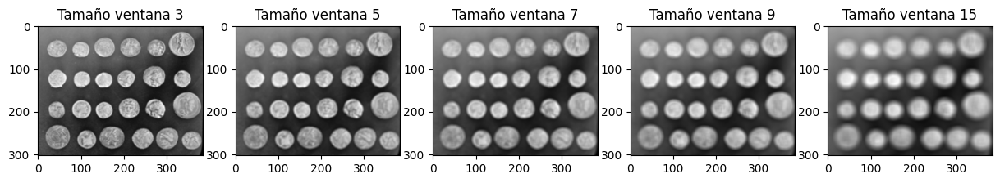

In [71]:
coins = data.coins()

# Tamaños de las ventanas
sizes = [3, 5, 7, 9, 15]

# Represntamos las imágenes aplicando el filtro de la media con diferentes tamaños de ventana
fig, ax = plt.subplots(1, 5, figsize=(15, 10))
for i, size in enumerate(sizes):
    coins_filtered = box_filter(coins, size=size)
    ax[i].imshow(coins_filtered, cmap='gray')
    ax[i].set_title('Tamaño ventana ' + str(size))


- **Conclusión**:

    Cuanto mayor es el tamaño de ventana, más se difuminan los detalles de la imagen, se pierde en un primer momento el detalle del interior de las monedas y conforme se va aumentando el tamaño, las monedas se convierten en manchas claras.

#### Ejercicio 4.2.- Eliminación de ruido: estudio comparativo

Para la imagen *data.camera()* (en escala de grises):
 1. Altere la imagen con **ruido blanco Gaussiano aditivo**. Seleccione dos valores para el parámetro de varianza (uno alto y otro bajo), de forma que el ruido sea apreciablemente diferente entre ambos, y con respecto a la imagen original, pero sin perder toda la información de la imagen. Visualice los resultados.

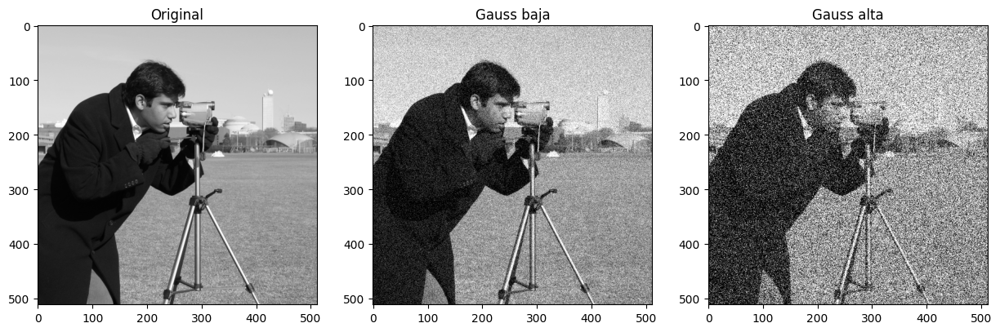

In [35]:
camera = data.camera()

camera_gauss_baja = random_noise(camera, mode='gaussian', var=0.01)
camera_gauss_alta = random_noise(camera, mode='gaussian', var=0.1)

# Mostramos las imágenes
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].imshow(camera, cmap='gray')
ax[0].set_title('Original')
ax[1].imshow(camera_gauss_baja, cmap='gray')
ax[1].set_title('Gauss baja')
ax[2].imshow(camera_gauss_alta, cmap='gray')
ax[2].set_title('Gauss alta')
plt.show()

 2. Altere la imagen con **ruido "sal y pimienta"**. Seleccione dos valores para el parámetro de cantidad (uno bajo y otro alto), de forma que el ruido sea apreciablemente diferente entre ambos, y con respecto a la imagen original, pero sin perder toda la información de la imagen. Visualice los resultados.

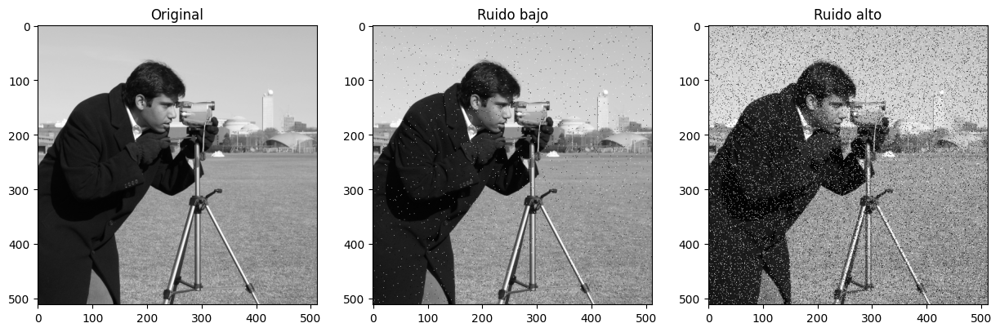

In [36]:
# Añadimos ruido sal y pimienta a la imagen
# amount es la proporción de píxeles que se van a modificar
camera_noisy_baja = random_noise(camera, mode='s&p', amount=0.01)
camera_noisy_alta = random_noise(camera, mode='s&p', amount=0.1)


# Representamos las imágenes con ruido sal y pimienta
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].imshow(camera, cmap='gray')
ax[0].set_title('Original')
ax[1].imshow(camera_noisy_baja, cmap='gray')
ax[1].set_title('Ruido bajo')
ax[2].imshow(camera_noisy_alta, cmap='gray')
ax[2].set_title('Ruido alto')
plt.show()

3. Escriba un código que aplique los filtros `ndi.gaussian_filter` y `ndi.median_filter` a la imagen original, y a las resultantes de los apartados (a) y (b), mostrando los resultados de forma ordenada

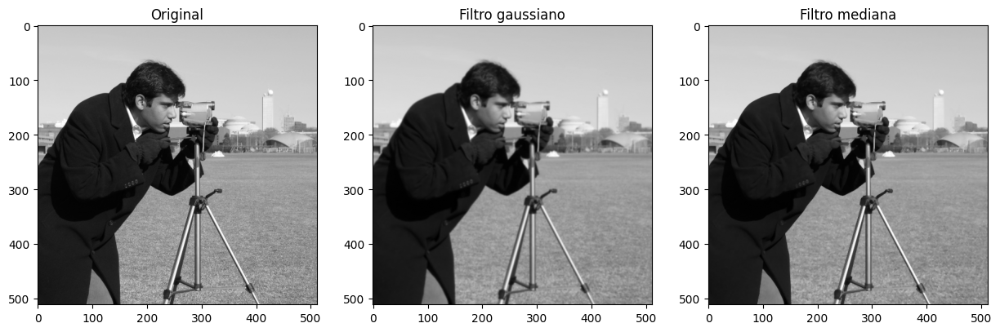

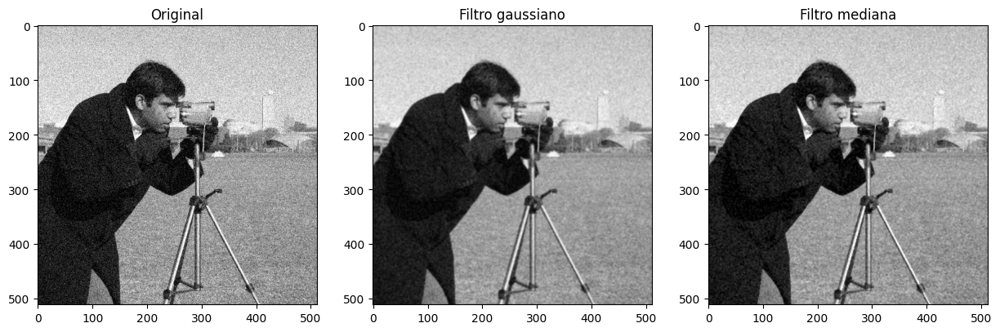

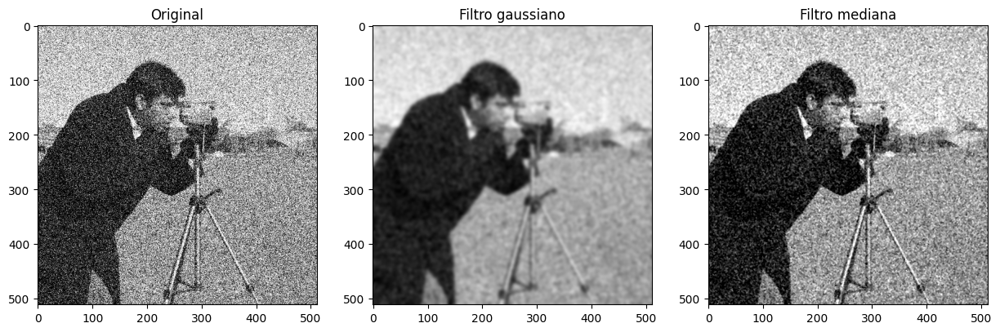

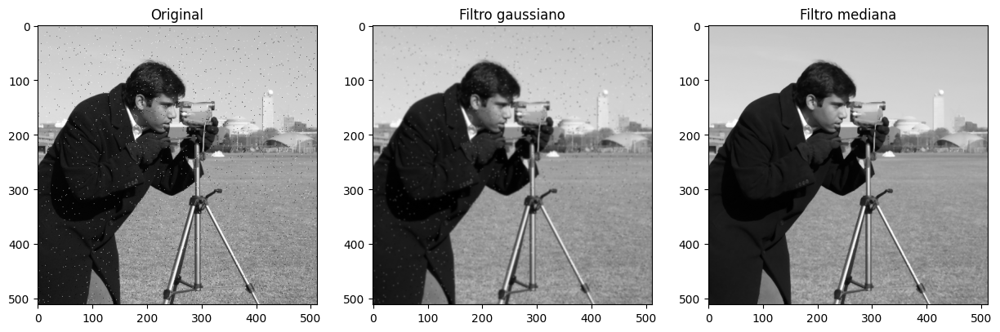

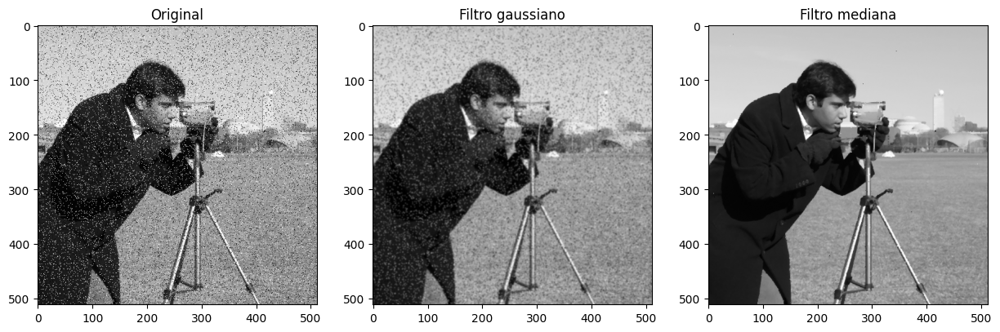

In [37]:
# Función que aplica los filtros ndi.gaussian_filter y ndi.median_filter a una imagen
def filtros(image, sigma=1, size=3):
    # Aplicamos el filtro gaussiano
    image_gaussian = ndi.gaussian_filter(image, sigma)
    # Aplicamos el filtro de la mediana
    image_median = ndi.median_filter(image, size=3)
    # Mostramos las imágenes
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    ax[0].imshow(image, cmap='gray')
    ax[0].set_title('Original')
    ax[1].imshow(image_gaussian, cmap='gray')
    ax[1].set_title('Filtro gaussiano')
    ax[2].imshow(image_median, cmap='gray')
    ax[2].set_title('Filtro mediana')
    plt.show()

# Aplicamos los filtros y decimos q imagen es cada una
filtros(camera)
filtros(camera_gauss_baja)
filtros(camera_gauss_alta, sigma=3, size = 5)
filtros(camera_noisy_baja)
filtros(camera_noisy_alta)

- **Aclaración**: 

    El primer bloque de imágenes se corresponde con la imagen original, el 2 y 3 con las imágenes de ruido gaussiano (bajo y alto) y las últimas 2 con ruido S&P (bajo y alto)

4. Explore el efecto de los parámetros de tamaño (*size* y *sigma*, según el caso) en los resultados del apartado (c), mostrando ejemplos representativos.

Aplicamos filtros a la imagen con ruido Sal y Pimienta


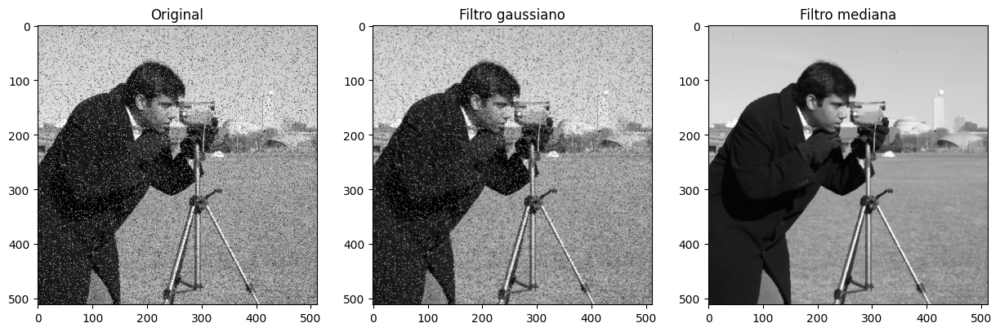

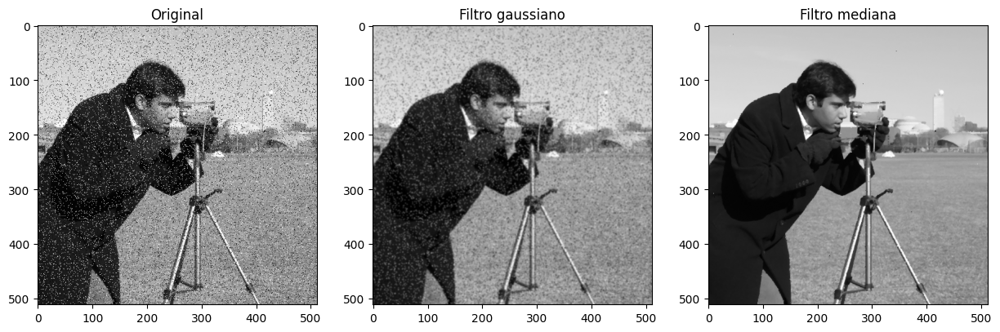

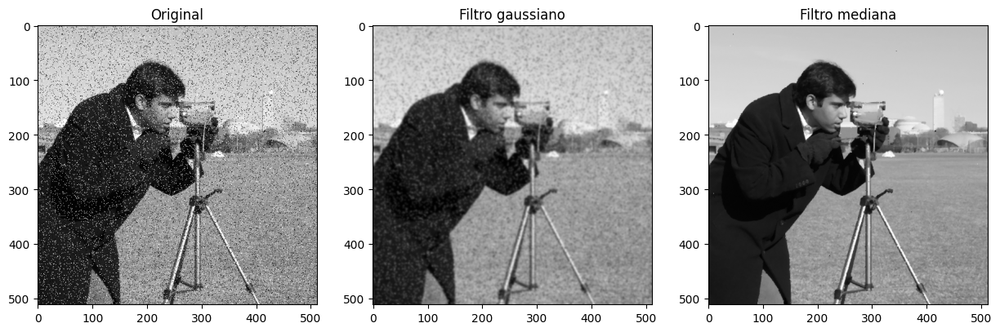

In [38]:
sigma_size = [(0.5, 1), (1, 2), (1.5, 3)]
print('Aplicamos filtros a la imagen con ruido Sal y Pimienta')
for sigma, size in sigma_size:
    filtros(camera_noisy_alta, sigma=sigma, size=size)

Aplicamos los filtros a la imagen con ruido gaussiano


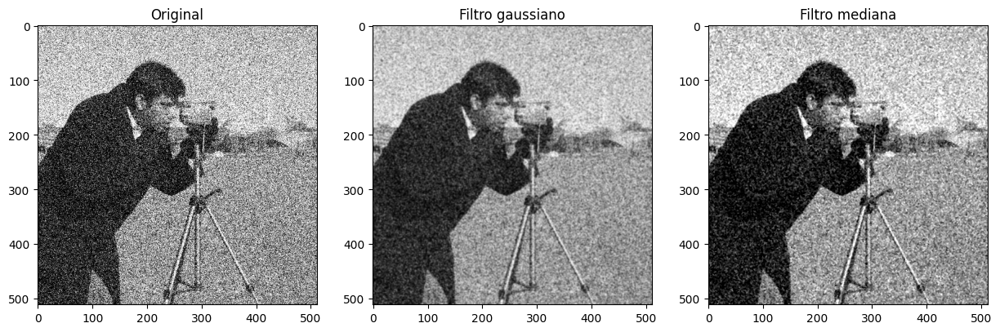

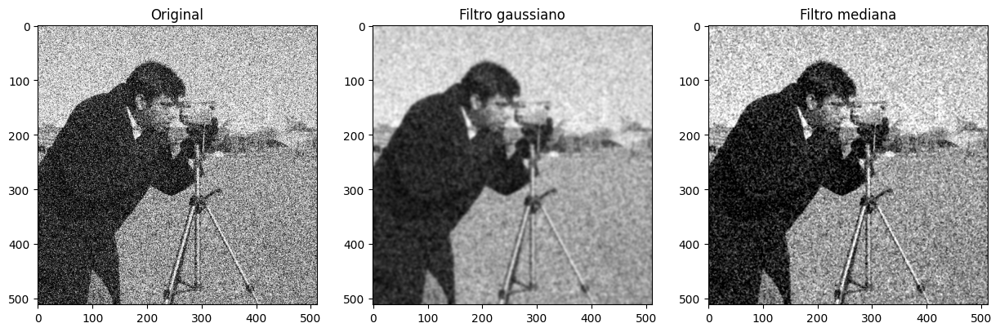

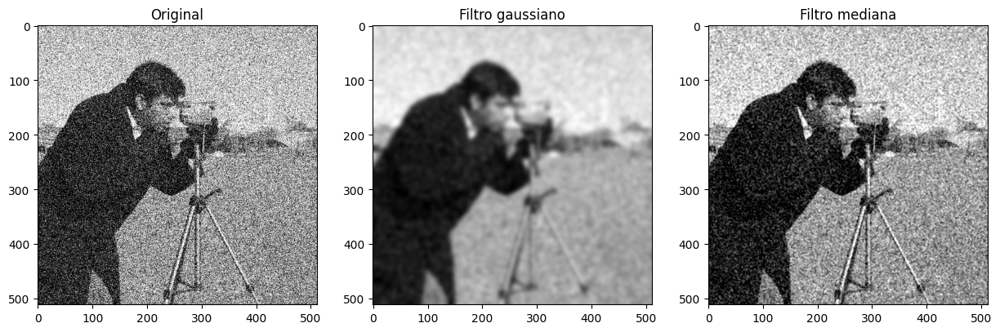

In [39]:
sigma_size = [(1, 1), (2, 2), (4, 3)]
print('Aplicamos los filtros a la imagen con ruido gaussiano')
for sigma, size in sigma_size:
    filtros(camera_gauss_alta, sigma=sigma, size=size)

Discuta las ventajas e inconvenientes de cada uno de los filtros comparados a la vista de los resultados, teniendo en cuenta como afectan sus parámetros.

- **Conclusión:**
    - El filtro gaussiano, aplicado a las imágenes con ruído sal y pimienta no logra mejorar de manera clara la calidad de la imágen, y aun en el caso del ruído gaussiano, no logra unos resultados demasiados interesantes si el sigma del filtro es bajo. Es necesario aumentar bastante el valor de sigma para que se reduzca el ruído, pero a cambio de perder detalles en la imagen. Esto se debe a que estamos probando solo con la imágen con un nivel de ruído alto. En el caso de la imagen con bajo ruido gaussiano es más sencillo encontrar un valor de sigma que mejore la imagen.

    - El filtro de la mediana, en cambio, logra reducir el ruído S&P de manera más eficiente, sin perder detalles en la imagen. En el caso del ruído sal y pimienta, cualquier valor de size de los probados logra eliminar el ruído. 
    Sin embargo, si la imagen tiene ruído gaussiano, el filtro de la mediana no logra eliminarlo de manera eficiente, las mejoras aún con valores altos de size no son significativas.

    Cabe destacar que este estudio del efecto de los parámetros se ha realizado sobre las imágenes con más ruido. En las imágenes con menos ruído, los resultados son más claros pero es importante no emplear valores muy altos de `size` o `sigma` que suavizarían en exceso la imagen

### 5. Operadores morfológicos

#### Ejercicio 5.1.- Morfología binaria

 Aplique las siguientes operaciones morfológicas a la imagen morph256.png (Figura 2), utilizando elementos estructurantes cuadrados (*morphology.square*) y circulares (*morphology.disk*) de tamaños 5, 10 y 15:
 - **Erosión**: *morphology.erosion*
 - **Dilatación**: *morphology.dilation*
 - **Apertura**: *morphology.opening*
 - **Cierre**: *morphology.closing*

1. Visualice los resultados de forma ordenada.

2. ¿Qué diferencias se aprecian?

C:\Users\andre\AppData\Local\Temp\ipykernel_15720\3237552048.py:7: FutureWarning: `square` is deprecated since version 0.25 and will be removed in version 0.27. Use `skimage.morphology.footprint_rectangle` instead.
  square = morphology.square(size)


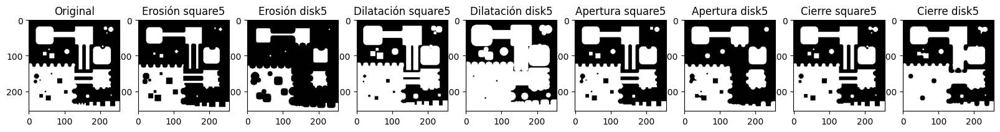

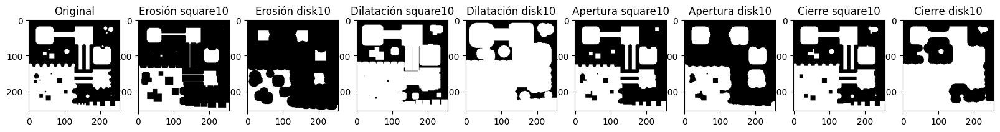

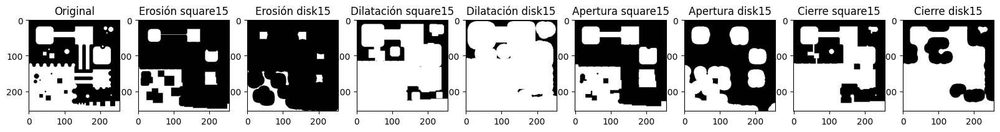

In [40]:
# Cargamos la imagen
morph = io.imread('morph256.png', as_gray=True)

# Creamos una función que aplique las operaciones morfológicas
def operaciones_morfologicas(image, size):
    # Elemento estructurante cuadrado
    square = morphology.square(size)
    # Elemento estructurante circular
    disk = morphology.disk(size)
    # Erosión
    erosion_square = morphology.erosion(image, square)
    erosion_disk = morphology.erosion(image, disk)
    # Dilatación
    dilation_square = morphology.dilation(image, square)
    dilation_disk = morphology.dilation(image, disk)
    # Apertura
    opening_square = morphology.opening(image, square)
    opening_disk = morphology.opening(image, disk)
    # Cierre
    closing_square = morphology.closing(image, square)
    closing_disk = morphology.closing(image, disk)
    # Mostramos las imágenes
    fig, ax = plt.subplots(1, 9, figsize=(20, 5))
    ax[0].imshow(image, cmap='gray')
    ax[0].set_title('Original')
    ax[1].imshow(erosion_square, cmap='gray')
    ax[1].set_title('Erosión square'+str(size))
    ax[2].imshow(erosion_disk, cmap='gray')
    ax[2].set_title('Erosión disk'+str(size))
    ax[3].imshow(dilation_square, cmap='gray')
    ax[3].set_title('Dilatación square'+str(size))
    ax[4].imshow(dilation_disk, cmap='gray')
    ax[4].set_title('Dilatación disk'+str(size))
    ax[5].imshow(opening_square, cmap='gray')
    ax[5].set_title('Apertura square'+str(size))
    ax[6].imshow(opening_disk, cmap='gray')
    ax[6].set_title('Apertura disk'+str(size))
    ax[7].imshow(closing_square, cmap='gray')
    ax[7].set_title('Cierre square'+str(size))
    ax[8].imshow(closing_disk, cmap='gray')
    ax[8].set_title('Cierre disk'+str(size))
    plt.show()


# Aplicamos las operaciones morfológicas
operaciones_morfologicas(morph, 5)
operaciones_morfologicas(morph, 10)
operaciones_morfologicas(morph, 15)


- **Conclusión:**

    En el código anterior estamos aplicando diferentes operaciones mediante elementos estructurantes de 2 formas distintas y de diferentes tamaños.

    En cuanto a las **operaciones**, la <u>erosión</u> encoge las zonas claras y aumenta las partes negras, realiza la operación de OR (podemos razonarlo de forma que se coge un lapiz en el centro del EE y se recorre el objeto con el EE tocando el contorno por dentro). Es decir, si el elemento estructurante cabe dentro de la mancha blanca (objeto pequeño) este se eliminará. La operación de <u>dilatación</u> hace lo contrario, aumenta el tamaño de los objetos (color blanco) ya que realiza la operación AND, es decir añade al objeto (blanco) todos los puntos del fondo que tocan el borde de un objeto (con el razonamiento del lapiz, se recorrería el contorno por fuera). La <u>apertura</u> es una erosión seguida de una dilatación, que elimina pequeños objetos (según el tamaño del EE) en los que cabe el elemento estructurante y  pequeños salientes pero mantiene los tamaños originales de los objetos más grandes ya que la dilatación recupera lo anteriormente erosionado (si no se ha eliminado completamente). El <u>cierre</u> es una dilatación seguida de una erosión, que elimina manchas negras pequeñas, el razonamiento es análogo a la dilatación pero trabajando sobre el fondo en vez de el objeto. Tiende a cerrar pequeños huecos en los objetos y a unir objetos cercanos.

    En cuanto a la **forma** de los elementos estructurantes, el cuadrado hace que los bordes de las imágenes transformadas se mantengan más rectos mientras que el kernel circular produce que los cambios se suavicen mas en cuanto a la forma, siendo los bordes de la imagen transformada más redondeados. Concretamente, esta suavidad dependerá de las formas de la imagen original. Si estamos dilatando por ejemplo una concavidad con un elemento estructurante circular, la concavidad se rellenará de forma más suave que si lo hiciéramos con un elemento estructurante cuadrado (el lapiz en el EE formará una curva en el ángulo concavo).

    El **tamaño** del elemento estructurante afecta al mayor o menor cambio con respecto a la imagen original. Un tamaño mayor del elemento estructurante produce un mayor cambio en la imagen ya que eliminará partes del objeto o partes del fondo (según la operación) an la que el EE quepa.


#### Ejercicio 5.2.- Morfología en escala de grises

Repita los resultados del ejercicio 5.1 con la imagen *data.camera()*. Visualice los resultados de forma ordenada y explique que efecto tiene cada uno de los operadores.

C:\Users\andre\AppData\Local\Temp\ipykernel_10232\3783410931.py:7: FutureWarning: `square` is deprecated since version 0.25 and will be removed in version 0.27. Use `skimage.morphology.footprint_rectangle` instead.
  square = morphology.square(size)


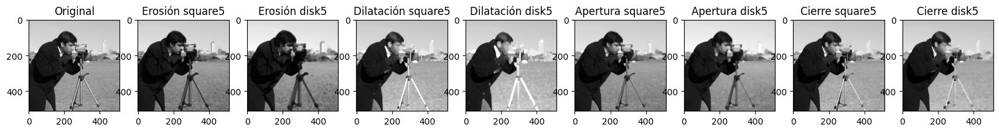

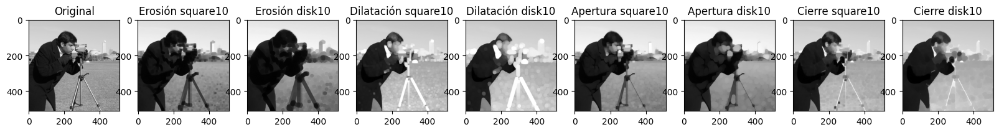

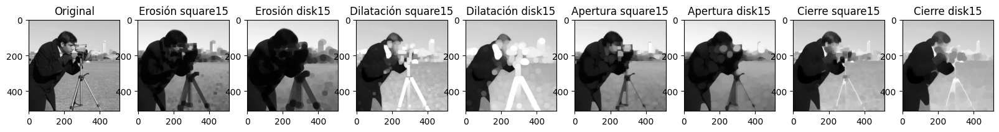

In [78]:
camera = data.camera()

# Aplicamos los filtros morfológicos a la imagen camera
operaciones_morfologicas(camera, 5)
operaciones_morfologicas(camera, 10)
operaciones_morfologicas(camera, 15)

- **Conclusión:**

    Cada operación y cada elemento estructurante logra un efecto distinto en la imagen transformada.

    Al igual que comentamos en el ejercicio anterior, las operaciones de erosión y dilatación en escala de grises se comportan de manera similar a las operaciones en binario. La erosión marca los píxeles como el valor mínimo de los vecinos y la dilatación como el máximo. 

    - En la imagen, la erosión reduce el tamaño de los objetos claros (en nuestro caso el fondo) y la dilatación los aumenta. Es por esto que observamos que en la erosión la figura humana ve incrementado su tamaño (lo negro domina sobre lo blanco y la cara por ejemplo tiende a desaparecer y convertirse en negro) mientras que en la dilatación, lo blanco domina sobre lo claro, y son las partes blancas las que aumentan su tamaño. Como característica, el trípode contiene zonas claras y oscuras, por lo que en la erosión se elimina la parte clara (ya que es menor que cualquier tamaño del elemento estructurante) y en la dilatación pasa al contrario, el trípode se ve blanco.

    - En cuanto a la apertura y el cierre, la apertura elimina pequeños objetos claro (la cara del hombre se oscurece). Los elementos se mantienen iguales si el tamaño es grande (fondo), lo que hace que la apertura nos ayude a diferenciar el fondo de la imagen (zona grande clara) de  la figura humana y la camara (partes mayoritariamente oscuras con pequeñas zonas blancas que se eliminan). El cierre, por otro lado, elimina manchas negras pequeñas o puntas finas oscuras, suavizandolas (esquina de la chaqueta) y la imagen resultante se ve más clara, destacando menos la camara y el trípode.

    Obivamente, el tamaño del elemento estructurante es crucial en estas operaciones, según si cabe o no en las zonas claras u oscuras (elimina o no elimina la zona). El comportamiento según la forma del elemento estructurante es similar al razonado en el caso binario.

### 6. Operadores de derivada y detención de bordes

#### Ejercicio 6.1.- Visualización de filtros efectivos

1. Cree una **imagen *delta*** de 101 × 101 pixels y tipo flotante, que tome el valor 0 en todas las posiciones, excepto en la posición central, que tomará el valor 1. La
 convolución de cualquier filtro con esta imagen resultará en el mismo filtro, lo que nos permitirá ver su forma.

In [41]:
delta = np.zeros((101, 101), dtype=np.float64)
delta[50,50] = 1

 2. Use la función `ndi.gaussian_filter` sobre la imagen *delta*, calculando la **primera derivada de Gaussiana** en vertical y horizontal, para valores de sigma de 5, 10 y
 20 pixels. Visualice los resultados, teniendo en cuenta que tendrán valores positivos y negativos.

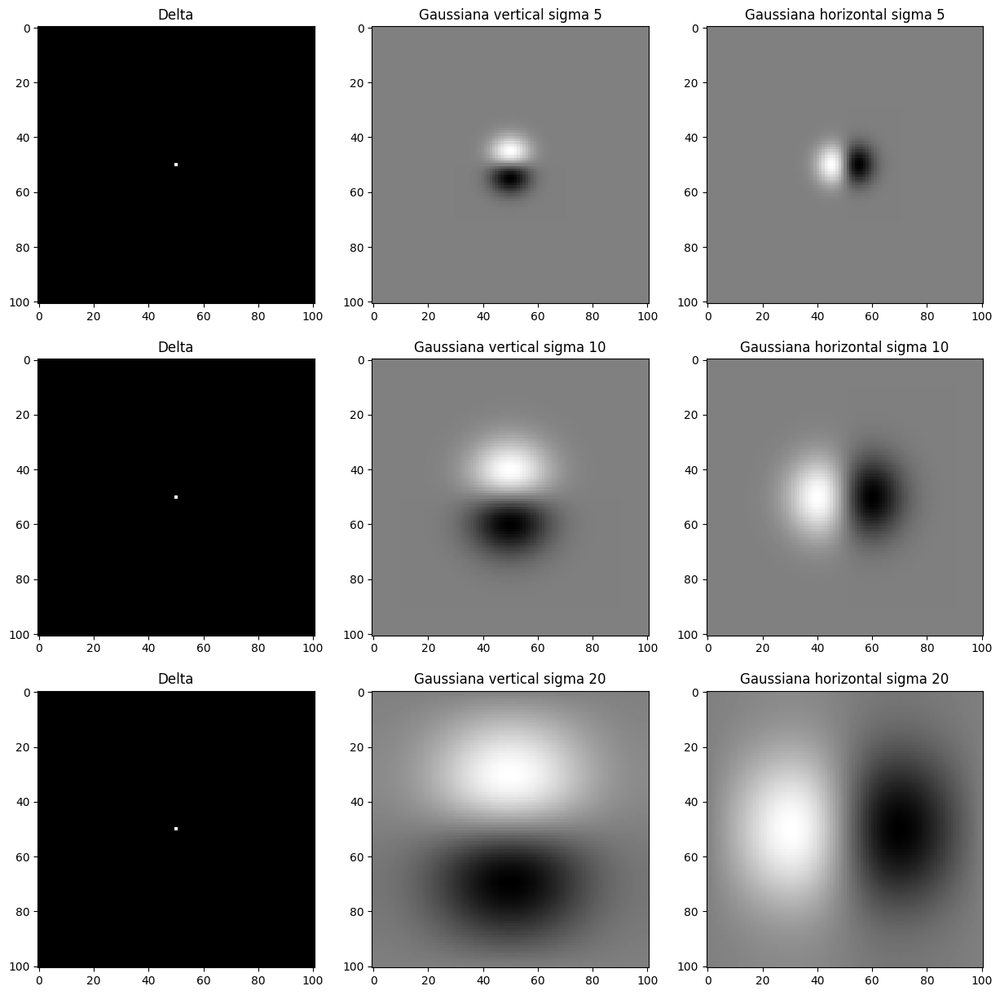

In [42]:
fig, ax = plt.subplots(3, 3, figsize=(15, 15))
for i, sigma in enumerate([5, 10, 20]):
    delta_gaussian_v = ndi.gaussian_filter(delta, sigma , order = (1, 0))
    delta_gaussian_h = ndi.gaussian_filter(delta, sigma, order = (0, 1))

    # Normalizamos al rango [0, 1] teniendo en cuenta que tendra valores positivos y negativos
    delta_gaussian_v = (delta_gaussian_v - delta_gaussian_v.min()) / (delta_gaussian_v.max() - delta_gaussian_v.min())
    delta_gaussian_h = (delta_gaussian_h - delta_gaussian_h.min()) / (delta_gaussian_h.max() - delta_gaussian_h.min())

    ax[i, 0].imshow(delta, cmap='gray')
    ax[i, 0].set_title('Delta')
    ax[i, 1].imshow(delta_gaussian_v, cmap='gray')
    ax[i, 1].set_title('Gaussiana vertical sigma ' + str(sigma))
    ax[i, 2].imshow(delta_gaussian_h, cmap='gray')
    ax[i, 2].set_title('Gaussiana horizontal sigma ' + str(sigma))
    
plt.show()

- **Aclaración**: 

    - Estamos reescalando los valores (pueden estar entre -1 y 1 ya que es una diferencia) al rango [0, 1] por lo que el valor 0 que se correspondía con una diferencia de 0 entre píxeles, ahora se corresponderá con el valor 0.5, el gris claro que ocupa el fondo. En esta representación de las derivadas, diferenciamos de forma visible (blanco o negro) cuando un borde es de cambio de negro a blanco o cuando es de blanco a negro.

        Cabe destacar que el rango es [0, 1] porque estamos trabajando en representación en punto flotante (float64) pero la lógica es la misma si la imagen está en el rango [0, 255], como fue explicado en clase.

    - El sigma indica que filtrado gaussiano se hace antes de calcular la derivada (kernel de diferencias), conforme aumentamos el valor, el suavizado que se hace sobre el punto blanco es mayor y por tanto el borde detectado (derivada) no es una línea definida.





3. Use la función `ndi.gaussian_filter` sobre la imagen delta, calculando la **segunda derivada de Gaussiana** en vertical y horizontal, para valores de sigma de 5, 10 y
 20 pixels. Visualice los resultados, teniendo en cuenta que tendrán valores positivos y negativos.

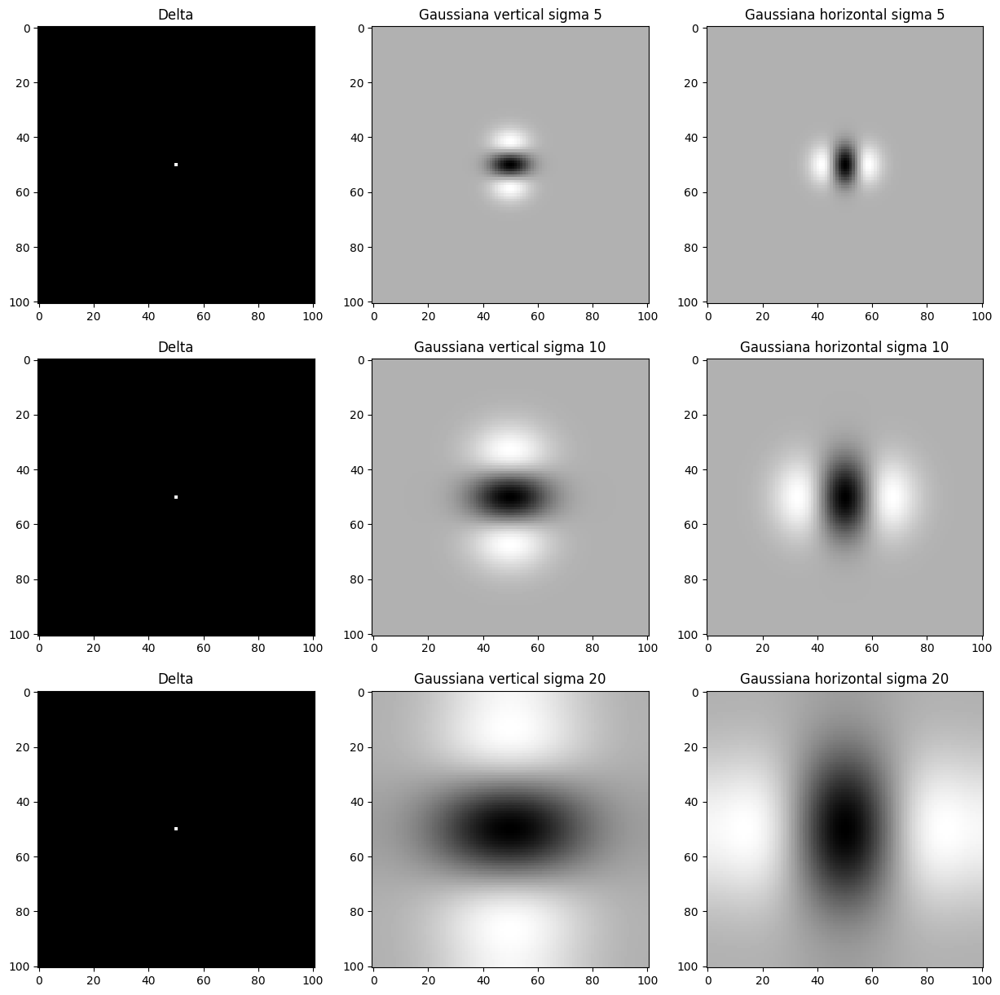

In [ ]:
# Igual pero la segunda derivada
fig, ax = plt.subplots(3, 3, figsize=(15, 15))
for i, sigma in enumerate([5, 10, 20]):
    delta_gaussian_v = ndi.gaussian_filter(delta, sigma , order = (2, 0))
    delta_gaussian_h = ndi.gaussian_filter(delta, sigma, order = (0, 2))
    # Normalizamos al rango [0, 1] teniendo en cuenta que tendra valores positivos y negativos
    delta_gaussian_v = (delta_gaussian_v - delta_gaussian_v.min()) / (delta_gaussian_v.max() - delta_gaussian_v.min())
    delta_gaussian_h = (delta_gaussian_h - delta_gaussian_h.min()) / (delta_gaussian_h.max() - delta_gaussian_h.min())

    ax[i, 0].imshow(delta, cmap='gray')
    ax[i, 0].set_title('Delta')
    ax[i, 1].imshow(delta_gaussian_v, cmap='gray')
    ax[i, 1].set_title('Gaussiana vertical sigma ' + str(sigma))
    ax[i, 2].imshow(delta_gaussian_h, cmap='gray')
    ax[i, 2].set_title('Gaussiana horizontal sigma ' + str(sigma))

plt.show()

- **Aclaración**: 

    La representación se está haciendo igual que en el apartado anterior, reescalando los valores de salida de la función a un rango [0, 1] y discriminandose los valores que eran negativos (negro) de los positivos (blanco).

#### Ejercicio 6.2.- Gradiente, magnitud y orientaciones

Para las imágenes *circles.png*, *circlegrad.png* y *data.camera*:
 1. Estime el gradiente de la imagen calculando sus **derivadas en x e y** para un sigma determinado. Visualice las componentes del gradiente, teniendo en cuenta
 que tendrán valores positivos y negativos.

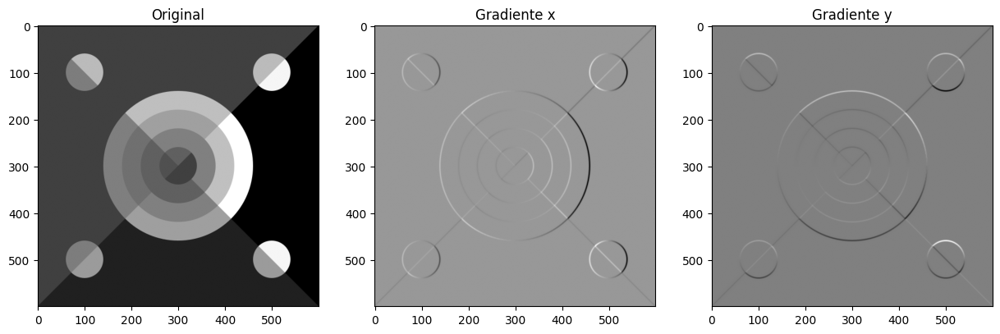

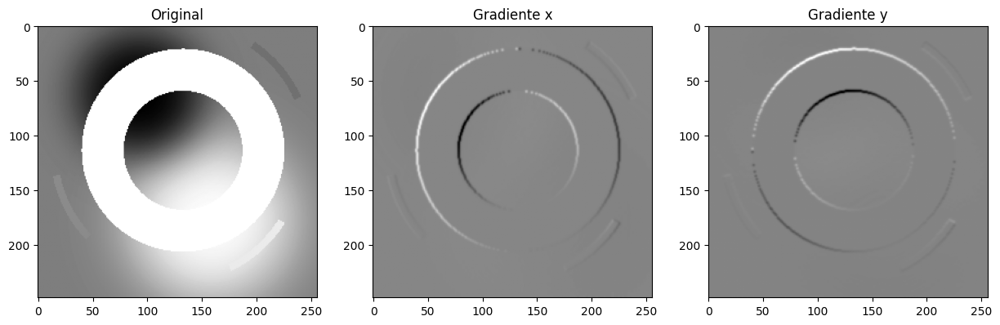

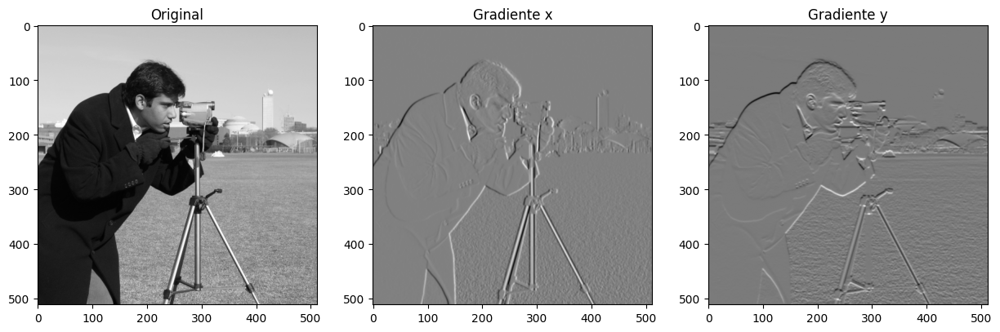

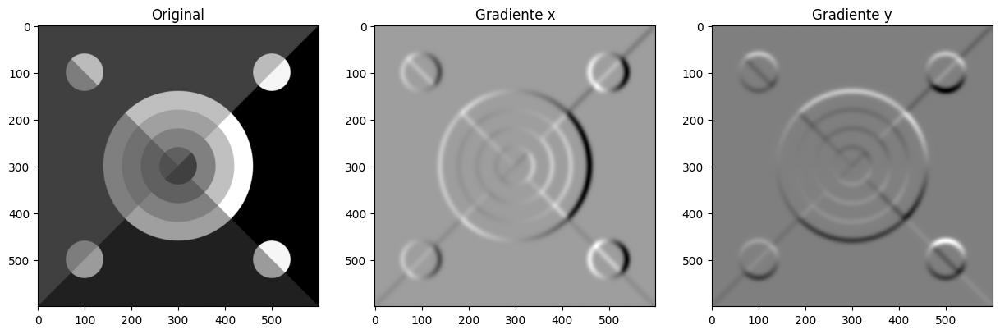

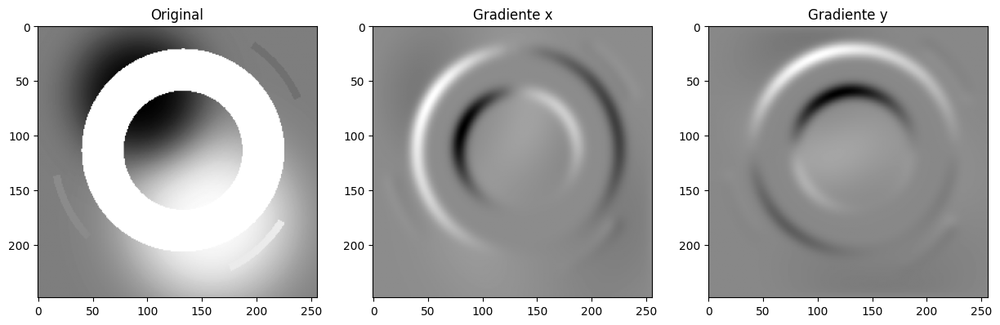

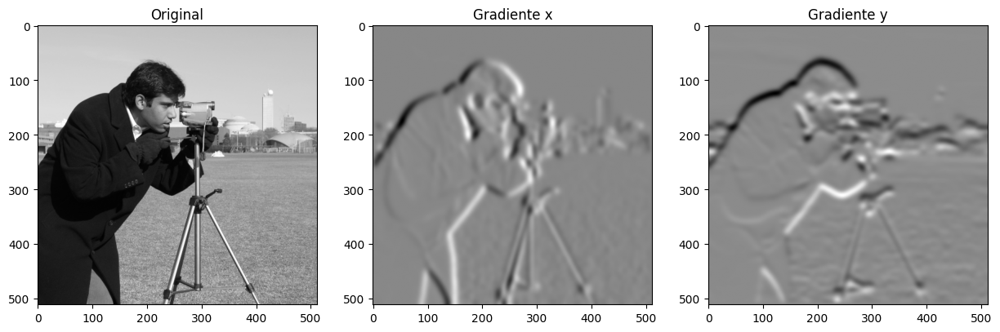

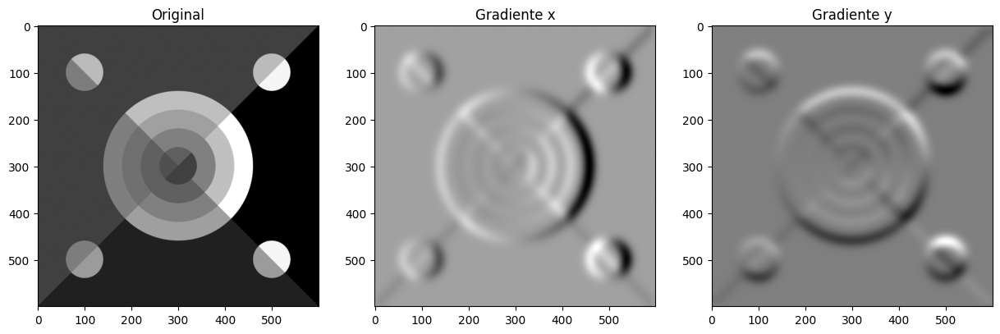

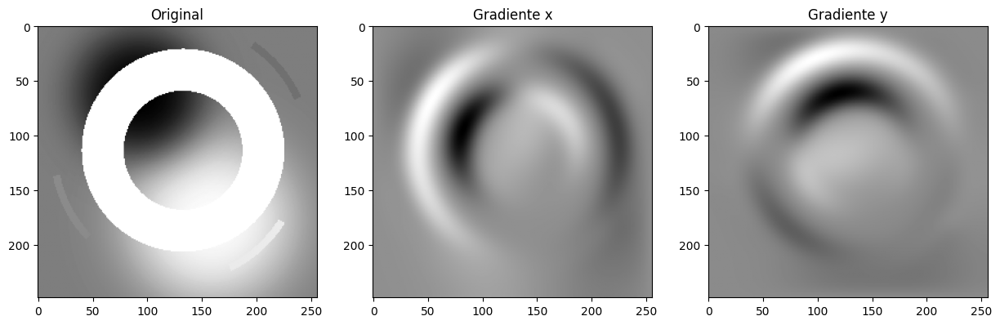

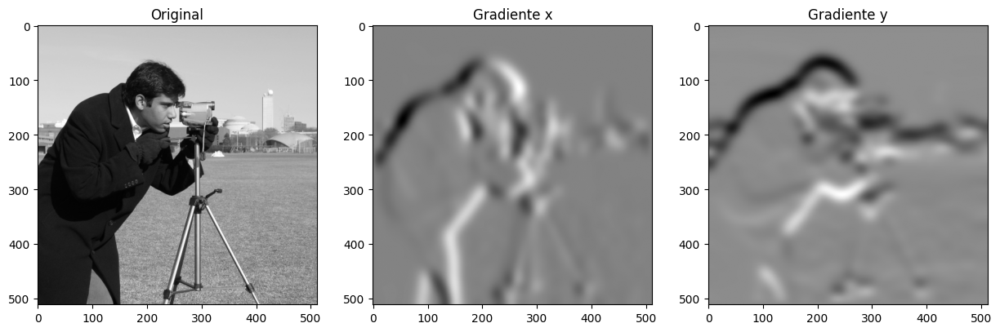

In [82]:
# Cargamos las imágenes todas en el rango [0, 1]
circles = io.imread('circles.png', as_gray=True)
circlegrad = io.imread('circlegrad.png', as_gray=True) / 255
camara = data.camera() / 255

def gradient(image, sigma):
    # Calculamos el gradiente de la imagen
    grad_x = ndi.gaussian_filter(image, sigma, order=(0, 1))
    grad_y = ndi.gaussian_filter(image, sigma, order=(1, 0))
    # Normalizamos al rango [0, 1] teniendo en cuenta que tendra valores positivos y negativos
    grad_x = (grad_x - grad_x.min()) / (grad_x.max() - grad_x.min())
    grad_y = (grad_y - grad_y.min()) / (grad_y.max() - grad_y.min())
    # Mostramos las imágenes
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    ax[0].imshow(image, cmap='gray')
    ax[0].set_title('Original')
    ax[1].imshow(grad_x, cmap='gray')
    ax[1].set_title('Gradiente x')
    ax[2].imshow(grad_y, cmap='gray')
    ax[2].set_title('Gradiente y')
    plt.show()

sigmas = [1, 5, 10]
for sigma in sigmas:
    gradient(circles, sigma)
    gradient(circlegrad, sigma)
    gradient(camara, sigma)

- **Comentario sobre el código**:

    Hemos detectado que indicando `order=(1,0)` en la función `gaussian_filter` al contrario de lo que puede parecer no se obtiene la derivada en x, sino que se obtiene la derivada en y. Esto se debe a que en _Scipy_ el eje 0 se corresponde a las filas (dirección vertical, de arriba a abajo) y el eje 1 corresponde a las columnas (dirección horizontal, de izquierda a derecha).

    Esta característica se debe tener en cuenta en todos los ejercicios de cálculo de derivadas.

- **Aclaración**:

    En este ejercicio se está siguiendo la misma opción de representación de las dos vistas en clase (reescalando para diferenciar los valores negativos y positivos) por lo que las líneas negras se corresponden con pasos de blanco a negro en la imagen original (en la dirección calculada) y las líneas blancas con pasos de negro a blanco.

    La otra opción de representación, no mostrada en este ejercicio, sería representar el valor absoluto de forma que se tratan igual los dos cambios.

    Es importante destacar esta elección, ya que la interpretación de los niveles de gris mostrados depende de esto. La salida de una operación de diferencias puede ser negativa y los píxeles negativos no se pueden representar.

 2. Calcule la **magnitud del gradiente**, y visualice el resultado.


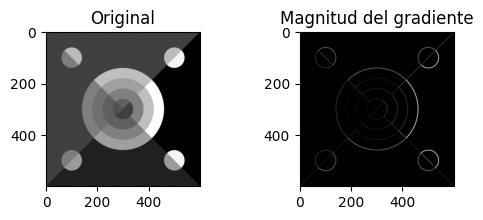

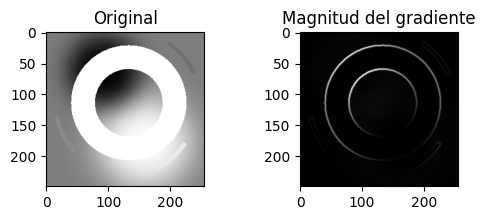

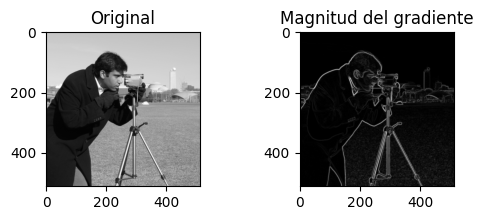

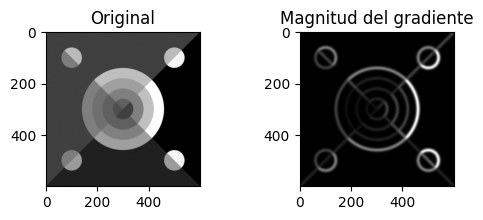

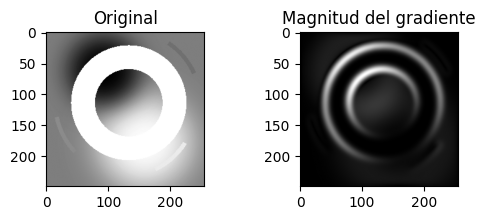

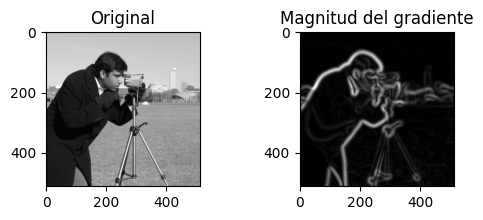

In [83]:
def gradient_magnitude(image, sigma):
    # Calculamos el gradiente de la imagen
    grad_x = ndi.gaussian_filter(image, sigma, order=(0, 1))
    grad_y = ndi.gaussian_filter(image, sigma, order=(1, 0))
    # Calculamos la magnitud del gradiente
    grad_magnitude = np.sqrt(grad_x**2 + grad_y**2)

    # Mostramos las imágenes
    fig, ax = plt.subplots(1, 2, figsize=(6, 2))
    ax[0].imshow(image, cmap='gray')
    ax[0].set_title('Original')
    ax[1].imshow(grad_magnitude, cmap='gray')
    ax[1].set_title('Magnitud del gradiente')
    plt.show()

sigmas = [1, 5]
for sigma in sigmas:
    gradient_magnitude(circles, sigma)
    gradient_magnitude(circlegrad, sigma)
    gradient_magnitude(camara, sigma)


- **Conclusión**: 

    Conforme se aumenta sigma, el suavizado previo al cálculo del gradiente es mayor y por lo tanto se detectan bordes más gruesos, aquellos que no fueron suavizados por la gaussiana. De la misma manera, la línea blanca que representa la magintud es cada vez más gruesa.

3. Calcule la **orientación del gradiente**, usando np.*arctan2*, y visualice el resultado, teniendo en cuenta que estarán en el rango $[−π,π]$.

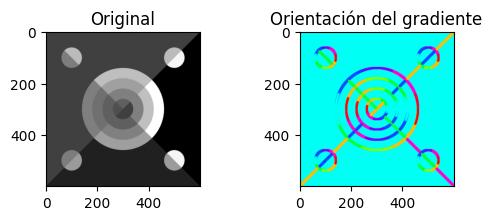

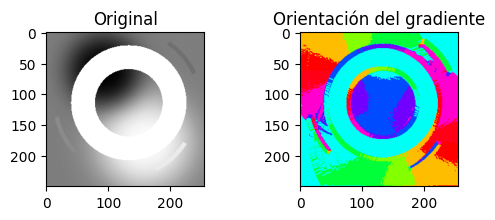

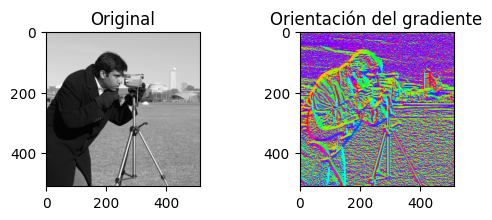

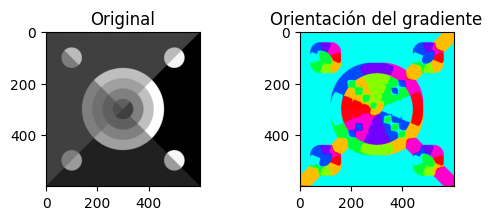

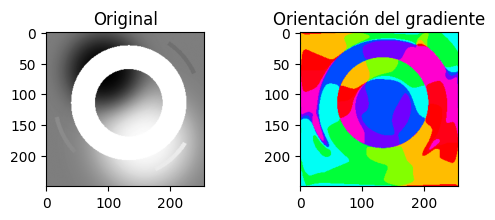

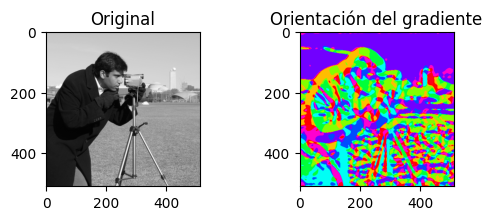

In [84]:
def gradient_orientation(image, sigma):
    # Calculamos el gradiente de la imagen
    grad_x = ndi.gaussian_filter(image, sigma, order=(0, 1))
    grad_y = ndi.gaussian_filter(image, sigma, order=(1, 0))
    # Calculamos la orientación del gradiente
    grad_orientation = np.arctan2(grad_y, grad_x)

    # Discretizamos la orientación del gradiente
    grad_orientation = np.degrees(grad_orientation)
    grad_orientation = np.round((grad_orientation - grad_orientation.min()) / (grad_orientation.max() - grad_orientation.min()) * 8)

    # Mostramos las imágenes
    fig, ax = plt.subplots(1, 2, figsize=(6, 2))
    ax[0].imshow(image, cmap='gray')
    ax[0].set_title('Original')
    # ax[1].imshow(grad_orientation, cmap='gray', vmin=0, vmax=360)
    # Para visualizar con colores usamos cmap='hsv'
    ax[1].imshow(grad_orientation, cmap='hsv', vmin=0, vmax=8)
    ax[1].set_title('Orientación del gradiente')
    plt.show()

sigmas = [1, 5]
for sigma in sigmas:
    gradient_orientation(circles, sigma)
    gradient_orientation(circlegrad, sigma)
    gradient_orientation(camara, sigma)

- **Aclaración**:
    
    El ángulo del gradiente nos proporciona la dirección de mayor cambio. Se discretiza el rango de ángulos continuo [$-\pi$, $\pi$] a un rango discreto con el cual visualizar. En nuestro caso discretizamos los ángulos a $[0, 8]$, es decir cada distinto color representa un rango de 45 grados del ángulo del gradiente. Este valor puede reducirse o aumentarse según cuantas direcciones (valores de ángulo) diferentes se quieran discriminar visualmente.

    Si utilizaramos una discretización a 360 veriamos que en la imagen del círculo, el borde del circulo crea un círculo cromático continuo, cada ángulo es un color. En nuestro caso, el círculo cromático se ve con 8 colores diferentes que cambian cada 45 grados.

    Tambien sería posible la representación en escala de grises.

 ¿Cómo afecta el parámetro *sigma* a los resultados?


- **Conclusión**:

    - Visualmente podemos decir que el valor de sigma afecta al desenfoque de los bordes resaltados, de esta forma al aplicar la operación de gradiente vemos como, cuanto mayor sea el valor de sigma se suaviza más la imagen de entrada y destacan más los bordes gruesos

    - En cuanto a la magnitud, cuanto mayor sea el valor de sigma, más ancha es la línea de los bordes detectados y solo aquellas zonas de un cambio grande de nivel de gris se ven resaltadas, esto se aprecia bien en la imagen *camera*.

    - En las representaciones de la orientación del gradiente, con un sigma pequeño se ven detalles de cambios de gris más pequeños, mientras que con un sigma grande se ven los cambios de gris más grandes. La orientación del gradiente nos indica la dirección del cambio más pronunciado de nivel de gris en cada punto de la imagen.


#### Ejercicio 6.3.- Laplaciano de Gaussiana

Implemente una función que **calcule el Laplaciano usando las segundas derivadas de Gaussiana**. Aplíquelo a las imágenes *circles.png*, *data.camera()* y *delta* (calculada como en el Ejercicio 6.1). Visualice los resultados, teniendo en cuenta que tendrán valores positivos y negativos. 

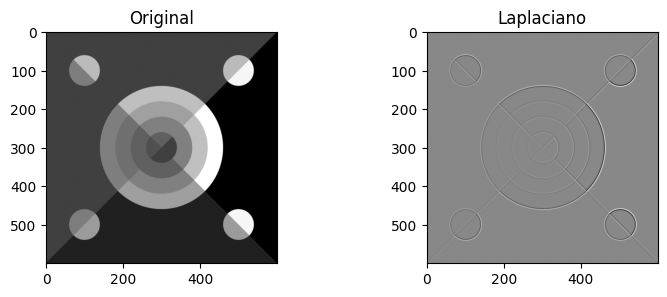

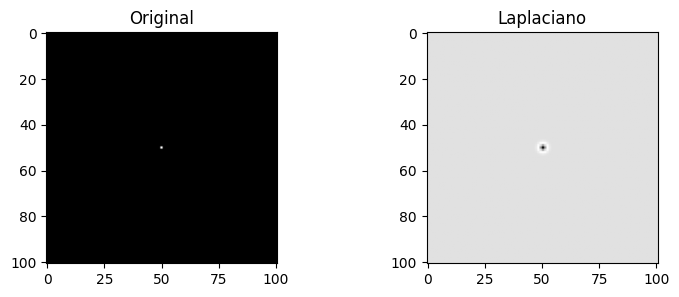

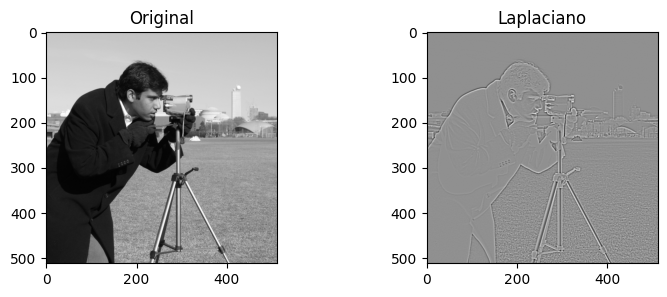

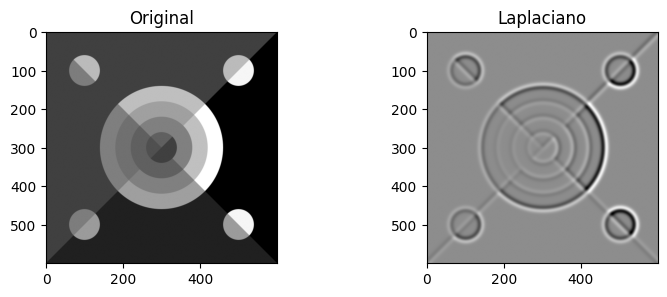

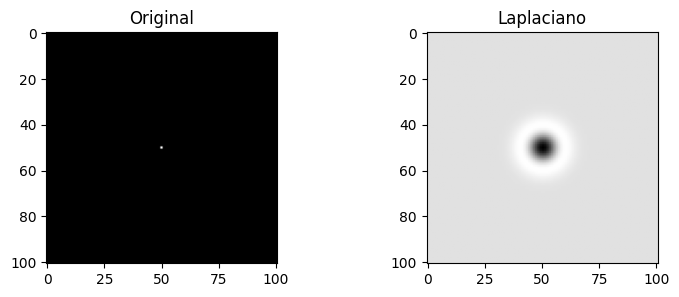

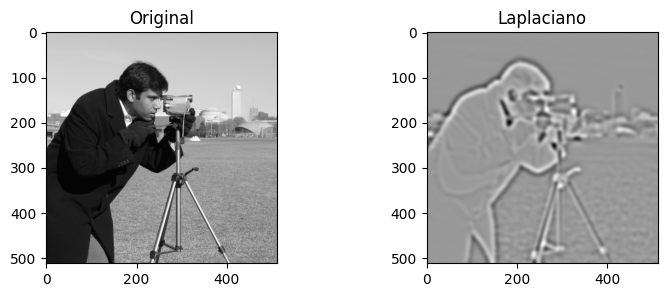

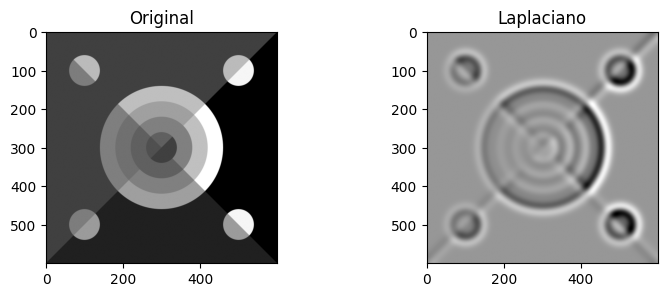

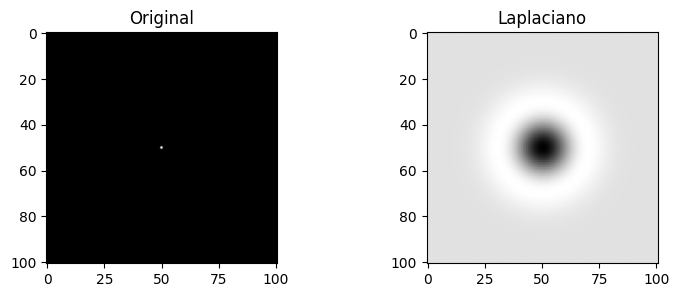

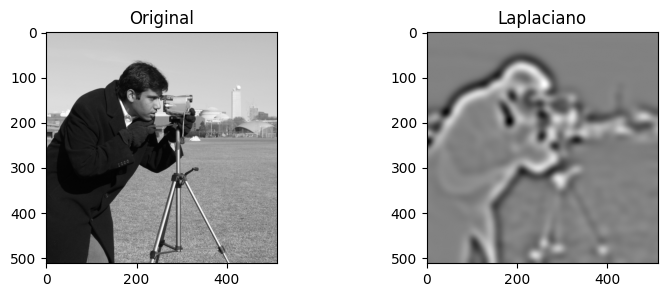

In [85]:
def laplacian_images(image, sigma):
    # Calculamos el laplaciano de la imagen
    laplacian_x = ndi.gaussian_filter(image, sigma, order=(0, 2))
    laplacian_y = ndi.gaussian_filter(image, sigma, order=(2, 0))
    # Normalizamos al rango [0, 1] teniendo en cuenta que tendra valores positivos y negativos
    laplacian_x = (laplacian_x - laplacian_x.min()) / (laplacian_x.max() - laplacian_x.min())
    laplacian_y = (laplacian_y - laplacian_y.min()) / (laplacian_y.max() - laplacian_y.min())
    laplacian = laplacian_x + laplacian_y

    # Mostramos las imágenes
    fig, ax = plt.subplots(1, 2, figsize=(9, 3))
    ax[0].imshow(image, cmap='gray')
    ax[0].set_title('Original')
    ax[1].imshow(laplacian, cmap='gray')
    ax[1].set_title('Laplaciano')

    plt.show()

sigmas = [1, 5, 10]
for sigma in sigmas:
    # Todas son imágenes tipo float64 en el rango [0, 1]
    laplacian_images(circles, sigma)
    laplacian_images(delta, sigma)
    laplacian_images(camara, sigma)

¿Qué caracteriza a los bordes de la imagen en esta representación? 

- **Conclusión**: 
    
    Los bordes de la imagen se caracterizan por combinar valores positivos y negativos en la representación del Laplaciano de Gaussiana, viendose líneas dobles en cada borde. Los valores positivos (trazas negras en la representación del laplaciano) indican un cambio de nivel de gris de claro a oscuro y los valores negativos (líneas blancas) representan cambios de oscuro a claro en la imagen original. A diferencia de un filtro como Sobel, el Laplaciano no es direccional.

    Obviamente, cuando hablamos de valores negativos y positivos, hablamos de la salida del cálculo Laplaciano ya que para poder ser mostrados se reescalan a un rango [0, 1], siendo 0.5 el gris claro que representa la ausencia de cambio de gris en la imagen original.


¿Cómo afecta el parámetro *sigma* a los resultados? 

- **Conclusión**: 
    
    Con un sigma más grande se identifican solo bordes con más cambios, ya que el resto se suavizaron al aplicar un gaussiano con un sigma grande. Los bordes se visualizan más gruesos.

#### Ejercicio 6.4.- Algoritmo de Canny

 Aplique el algoritmo de Canny a las imágenes *circlegrad.png* y *data.coins()*, ajustando su parámetro *sigma* y los umbrales de histéresis, de forma que se obtengan los
 mejores bordes posibles (los bordes del aro y los contornos de las monedas). Visualice los resultados.

Recomendaciones para el ajuste:

- **Umbral bajo**. Manteniendo los dos umbrales iguales, busque un valor lo suficien temente bajo que aparezcan, al menos, todos los bordes requeridos para un *sigma* adecuado (alta sensibilidad, baja especificidad).
 
- **Umbral alto**. Manteniendo los dos umbrales iguales, busque un valor que solo detecte bordes requeridos, aunque no sean todos (alta especificidad, baja sensibilidad).

- **Ajuste fino**. Usando la combinación de umbrales anteriores, realice un ajuste fino, o vuelva a iterar sobre el proceso probando un *sigma* diferente.

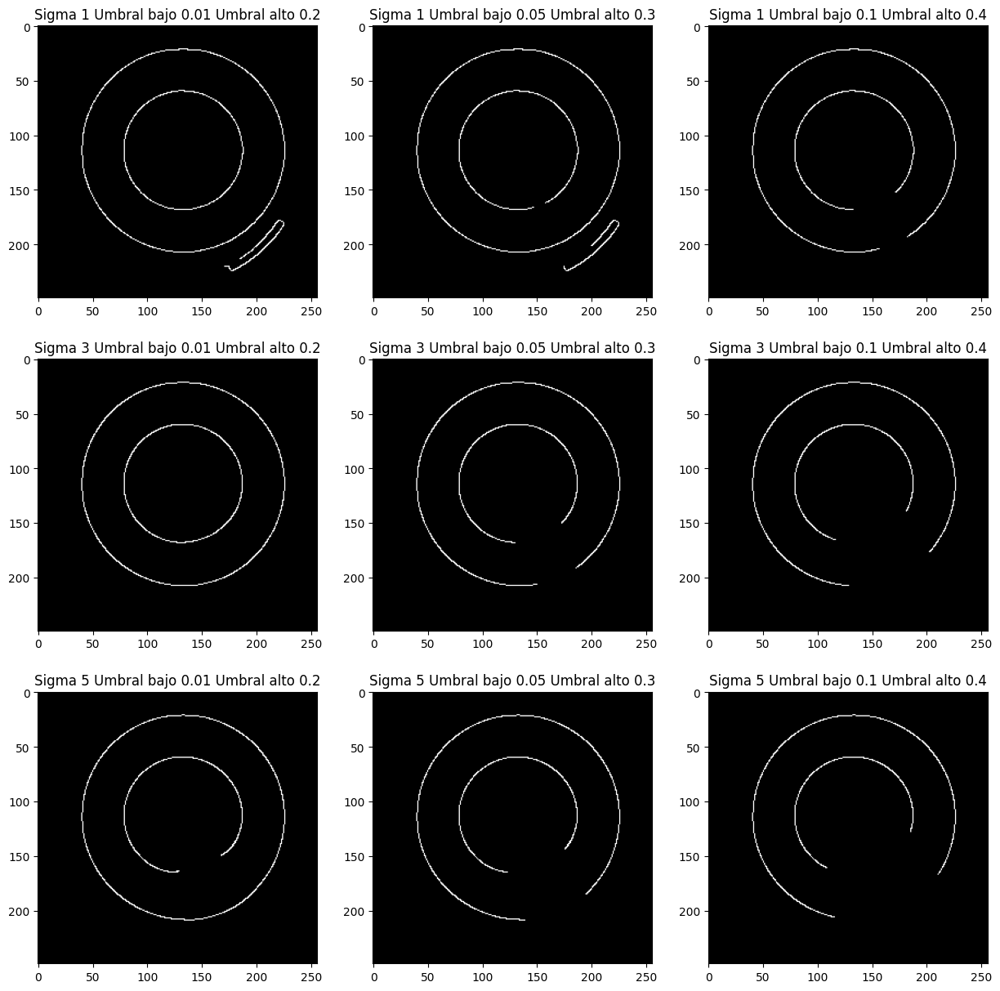

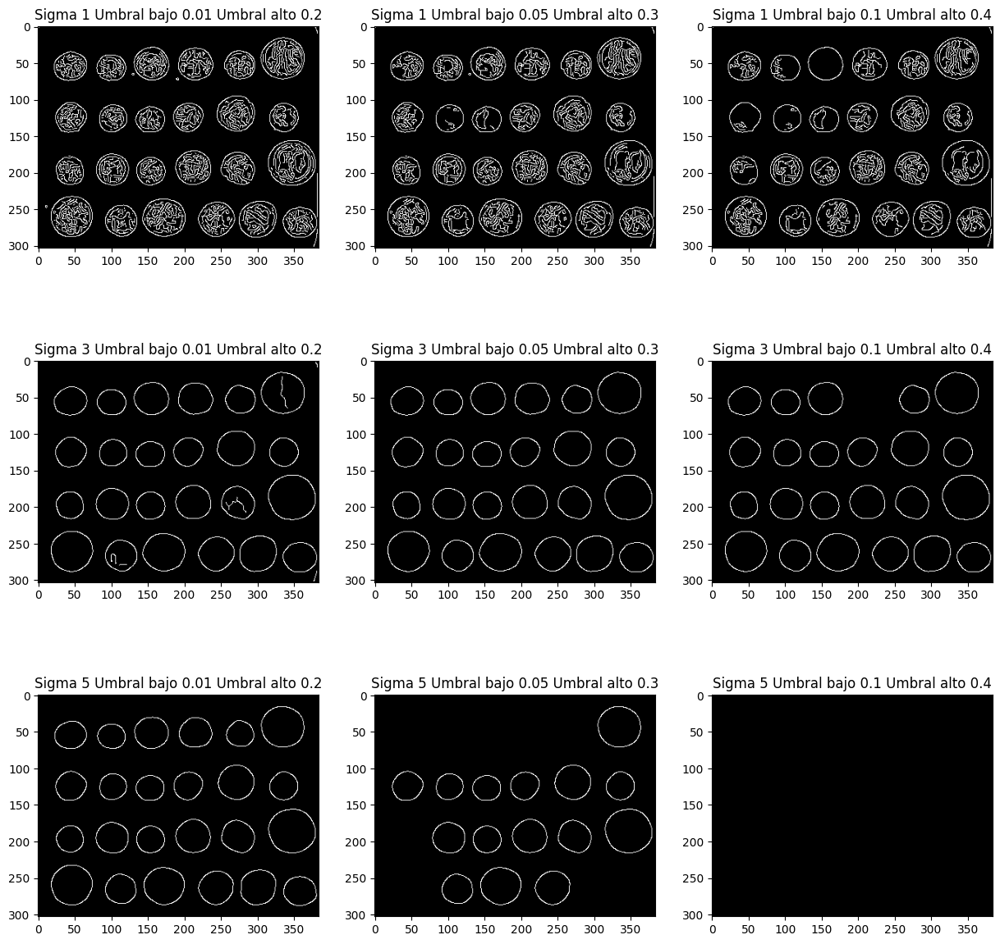

In [86]:
# Cargamos las imágenes convertidas a float64 y en el rango [0, 1]
circlegrad = io.imread('circlegrad.png', as_gray=True) / 255
coins = data.coins() / 255

# Representamos las diferentes combinaciones de sigma y umbrales
def canny_images(image, sigmas, umbrales_bajos, umbrales_altos):
    fig, ax = plt.subplots(len(sigmas), len(umbrales_bajos), figsize=(15, 15))
    for i, sigma in enumerate(sigmas):
        for j, (umbral_bajo, umbral_alto) in enumerate(zip(umbrales_bajos, umbrales_altos)):
            canny = feature.canny(image, sigma=sigma, low_threshold=umbral_bajo, high_threshold=umbral_alto)
            ax[i, j].imshow(canny, cmap='gray')
            ax[i, j].set_title('Sigma ' + str(sigma) + ' Umbral bajo ' + str(umbral_bajo) + ' Umbral alto ' + str(umbral_alto))
    plt.show()

sigmas = [1, 3, 5]
umbrales_bajos = [0.01, 0.05, 0.1]
umbrales_altos = [0.2, 0.3, 0.4]

canny_images(circlegrad, sigmas, umbrales_bajos, umbrales_altos)
canny_images(coins, sigmas, umbrales_bajos, umbrales_altos)

- **Aclaración:**

    Con la función `feature.canny()` ya se realizan los 4 pasos del algoritmo de Canny:

    - Suavizado con filtro Gaussiano _(sigma=...)_

    - Cálculo de gradientes (x, y) y magnitud

    - Supresión no máxima

    - Umbralización con histéresis _(low_threshold=..., high_threshold=...)_

- **Conclusión**: 

    Se visaulizaron una serie de combinaciones de parámetros para ver como afectan estos a la salida del algoritmo de Canny.

    Visualizamos ahora con unos parámetros que ofrecen buenos resultados:

    - *Circlegrad.png*: `(sigma=3, umbral bajo=0.01, umbral alto=0.2)`
    - *Coins.png*: `(sigma=3, umbral bajo=0.05, umbral alto=0.3)` o `(sigma=5, umbral bajo=0.01, umbral alto=0.2)`

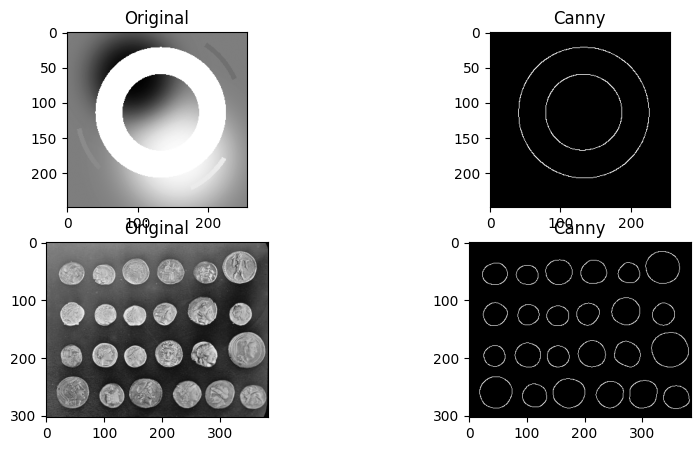

In [87]:
canny_circlegrad = feature.canny(circlegrad, sigma=3, low_threshold=0.01, high_threshold=0.2)
canny_coins = feature.canny(coins, sigma=5, low_threshold=0.01, high_threshold=0.2)

fig, ax = plt.subplots(2, 2, figsize=(10, 5))
ax[0, 0].imshow(circlegrad, cmap='gray')
ax[0, 0].set_title('Original')
ax[0, 1].imshow(canny_circlegrad, cmap='gray')
ax[0, 1].set_title('Canny')
ax[1, 0].imshow(coins, cmap='gray')
ax[1, 0].set_title('Original')
ax[1, 1].imshow(canny_coins, cmap='gray')
ax[1, 1].set_title('Canny')

plt.show()

- **Aclaraciones**:

    - Los parámetros elegidos son aquellos que probando varias combinaciones, ofrecen buenos resultados, podría haber otras muchas combinaciones que también lo hagan. Podemos llegar a bordes muy similares combinando diferentes suavizados con diferentes umbrales. Es más, se pueden obtener resultados muy parecidos si hacemos un suavizado con sigmas diferentes pero luego determinamos los umbrales de forma que los bordes finos detectados con un sigmo pequeño sean eliminados.
    
    - Simplemente probando valores es imposible determinar "la mejor" combinación, podemos obtener unos valores que se adaptan a lo que buscamos.

    - Por la forma de obtener estos valores, es importante comentar que no son umbrales generalizables a otras imágenes con otras características.

    - La sensibilidad del algoritmo a los parámetros de entrada provoca que obtener estos valores sea dificil para optimizar el resultado.

### 7. Segmentación

#### Ejercicio 7.1.- Umbralización global

 En las imágenes *data.text()* y *data.page()* queremos separar el texto del fondo.

 1. Visualice el histograma de las imágenes.

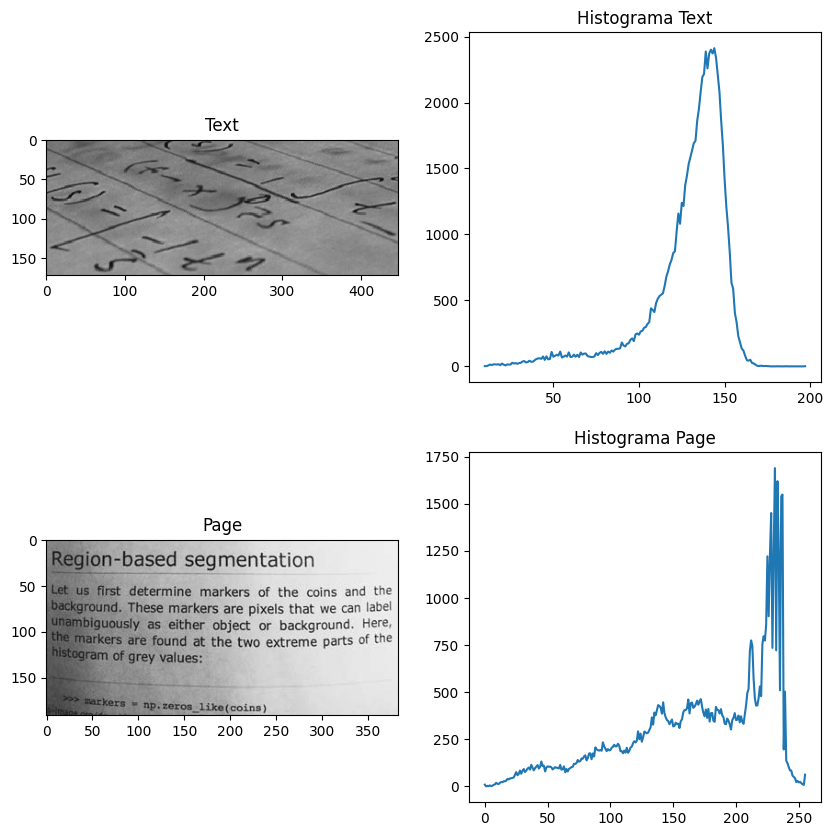

In [43]:
text = data.text()
page = data.page()

hist_text, bins_text = exposure.histogram(text)
hist_page, bins_page = exposure.histogram(page)

# Mostramos las imágenes y sus histogramas
fig, ax = plt.subplots(2, 2, figsize=(10, 10))
ax[0, 0].imshow(text, cmap='gray', vmin=0, vmax=255)
ax[0, 0].set_title('Text')
ax[0, 1].plot(bins_text, hist_text)
ax[0, 1].set_title('Histograma Text')
ax[1, 0].imshow(page, cmap='gray', vmin=0, vmax=255)
ax[1, 0].set_title('Page')
ax[1, 1].plot(bins_page, hist_page)
ax[1, 1].set_title('Histograma Page')
plt.show()

2. Obtenga un umbral global mediante los siguientes métodos, y represente estos umbrales sobre el histograma (e.g. con lineas verticales de varios colores).

- **Método de Otsu**. `threshold_otsu`

- **Método del triángulo**: `threshold_triangle`

- **Método de ISODATA**: `threshold_isodata`
 
- **Método manual**: Usando un umbral global ajustado a mano por usted.

Umbrales
Otsu Text: 109
Otsu Page: 157
Triángulo Text: 104
Triángulo Page: 206
ISODATA Text: 108
ISODATA Page: 157


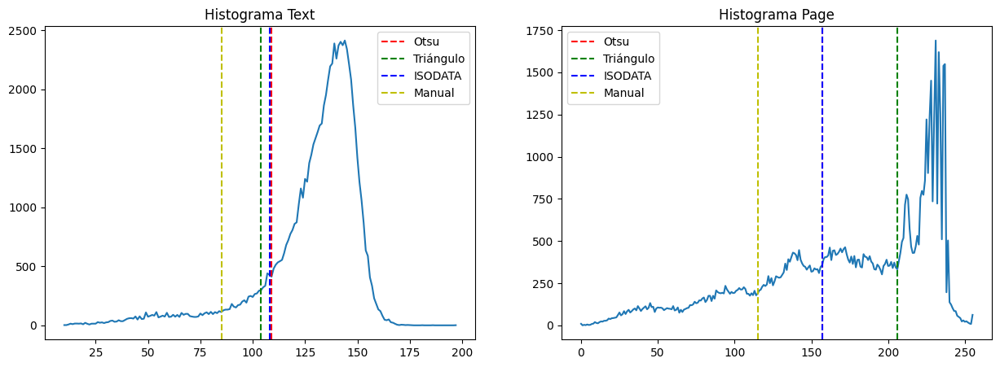

In [44]:
# Calculamos el umbral de Otsu
text_otsu = threshold_otsu(text)
page_otsu = threshold_otsu(page)
# Calculamos el umbral del triángulo
text_triangle = threshold_triangle(text)
page_triangle = threshold_triangle(page)
# Calculamos el umbral de ISODATA
text_isodata = threshold_isodata(text)
page_isodata = threshold_isodata(page)
# Calculamos el umbral manual
text_manual = 85
page_manual = 115

# Imprimimos los umbrales
print('Umbrales')
print('Otsu Text:', text_otsu)
print('Otsu Page:', page_otsu)
print('Triángulo Text:', text_triangle)
print('Triángulo Page:', page_triangle)
print('ISODATA Text:', text_isodata)
print('ISODATA Page:', page_isodata)

# Mostramos el histograma y los umbrales
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
ax[0].plot(bins_text, hist_text)
ax[0].set_title('Histograma Text')
ax[0].axvline(text_otsu, color='r', linestyle='--', label='Otsu')
ax[0].axvline(text_triangle, color='g', linestyle='--', label='Triángulo')
ax[0].axvline(text_isodata, color='b', linestyle='--', label='ISODATA')
ax[0].axvline(text_manual, color='y', linestyle='--', label='Manual')
ax[0].legend()
ax[1].plot(bins_page, hist_page)
ax[1].set_title('Histograma Page')
ax[1].axvline(page_otsu, color='r', linestyle='--', label='Otsu')
ax[1].axvline(page_triangle, color='g', linestyle='--', label='Triángulo')
ax[1].axvline(page_isodata, color='b', linestyle='--', label='ISODATA')
ax[1].axvline(page_manual, color='y', linestyle='--', label='Manual')
ax[1].legend()
plt.show()

- **Aclaración**: 

    En el caso de la imagen _page_, el umbral de Otsu coincide con el de ISODATA, y en la representación solo se visualiza la línea azul.

- **Conclusión (nota teórica)**:

    Todos los métodos implementados de umbralización global se basan en la idea de separar el fondo del objeto trabajando con el histograma de la imagen. La idea es encontrar un umbral que separe los píxeles del fondo de los píxeles del objeto (en este caso el texto).

    - El método de Otsu busca el umbral que minimiza la suma de las varianzas de las dos clases.

    - En el método del triángulo, es el punto de máxima distancia entre el histograma y la línea que une los extremos del histograma (valor mínimo y máximo).

    - El método ISODATA funciona buscando un umbral que sea el promedio entre las medias de los píxeles por debajo y por encima de dicho umbral, hasta que el valor se estabiliza.

    - Para el método manual, se ha elegido un valor a la vista del histograma. En este caso no parece haber 2 picos claros o algo que nos pueda ayudar a elegir un umbral global. 
    Este valor se ha modificado a mano tras la visualización de las imágenes binarias para obtener una segmentación que discrimine bien el texto del fondo.

3. Visualice la segmentación resultante con cada uno de estos umbrales globales

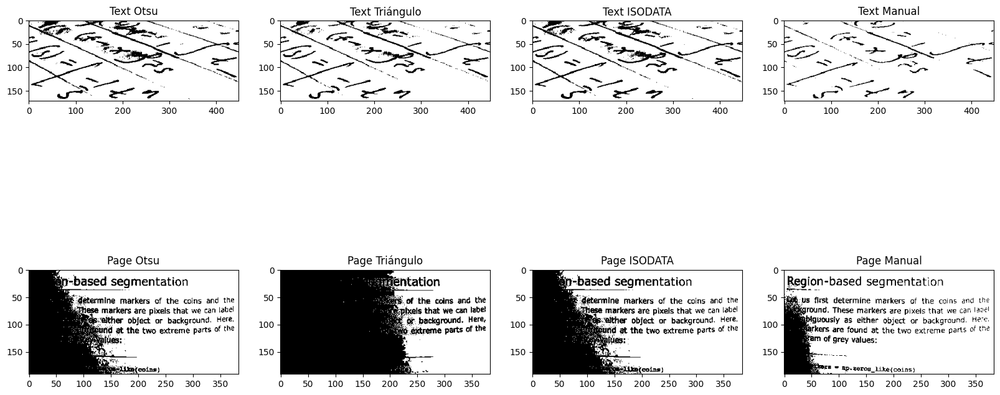

In [4]:
# Visualizamos la segmentación resultante con cada umbral
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
ax[0, 0].imshow(text > text_otsu, cmap='gray') # Si es mayor que el umbral, lo pintamos de blanco (True), será fondo
ax[0, 0].set_title('Text Otsu')
ax[0, 1].imshow(text > text_triangle, cmap='gray')
ax[0, 1].set_title('Text Triángulo')
ax[0, 2].imshow(text > text_isodata, cmap='gray')
ax[0, 2].set_title('Text ISODATA')
ax[0, 3].imshow(text > text_manual, cmap='gray')
ax[0, 3].set_title('Text Manual')
ax[1, 0].imshow(page > page_otsu, cmap='gray')
ax[1, 0].set_title('Page Otsu')
ax[1, 1].imshow(page > page_triangle, cmap='gray')
ax[1, 1].set_title('Page Triángulo')
ax[1, 2].imshow(page > page_isodata, cmap='gray')
ax[1, 2].set_title('Page ISODATA')
ax[1, 3].imshow(page > page_manual, cmap='gray')
ax[1, 3].set_title('Page Manual')
plt.show()

- **Aclaración**: 

    La segmentación de la imagen no es más que la separación en dos clases (texto y fondo) de la imagen original dividiendo la imagen en dos partes, una con los píxeles que superan el umbral y otra con los que no lo superan.

    Para la representación de esta segmentación se utiliza una imagen binaria, poniendo a 0 (negro) la clase que no supera el umbral y a 1 (blanco) la que sí lo supera. En este caso, el fondo es la clase que supera el umbral y se visualiza como blanco, y la clase segmentada que se refiere al texto se vizualiza como negro.

Discuta la conveniencia o no de cada uno de estos métodos para la segmentación de las imágenes.

- **Conclusión:**

    - En la imagen de _text_, a la vista de la imagen tras la clasificación binaria, el mejor resultado parece el del método de triángulo. Con el método manual tambien se obtiene un resultado bueno adaptando el valor. 
    
        En la imagen original, aunque la gran mayoría de valores de intensidad se acumulan en un rango pequeño, vemos como el texto es mas oscuro que el fondo, por lo que el uso de un umbral general no parece una mala opción.

    - Por el contrario, en la imagen de _page_ la elección de un umbral global es muy complicada. Casi todos los métodos dan un mal resultado ya que la imagen original tiene una zona más sombreada (oscura) y otra más iluminada (clara), y no es posible localizar un valor en el cual dividir el histograma de forma que a la izquierda queden aquellos píxeles referidos al texto y a la derecha los referidos al fondo.

        Con el método manual se logra un resultado aceptable, pero no es el mejor. En este caso, la elección de un umbral global no parece la mejor opción ya que como vimos teoricamente, da problemas en imágenes con iluminación no constante. Quizás una segmentación local podría ser más adecuada.

#### Ejercicio 7.2.- Umbralización adaptativa (local)

Calcule mapas de umbrales locales usando la función `treshold_local` para segmentar las imágenes *data.page()*, donde queremos separar el texto del fondo, y *butterfly.png* (en escala de grises), donde queremos segmentar la mariposa. Visualice los resultados. Compare los métodos `mean`,`median`, y `threshold_ostu`(usando `generic` y pasando la función como parámetro). ¿Cómo influye el parámetro de tamaño de bloque en el resultado?

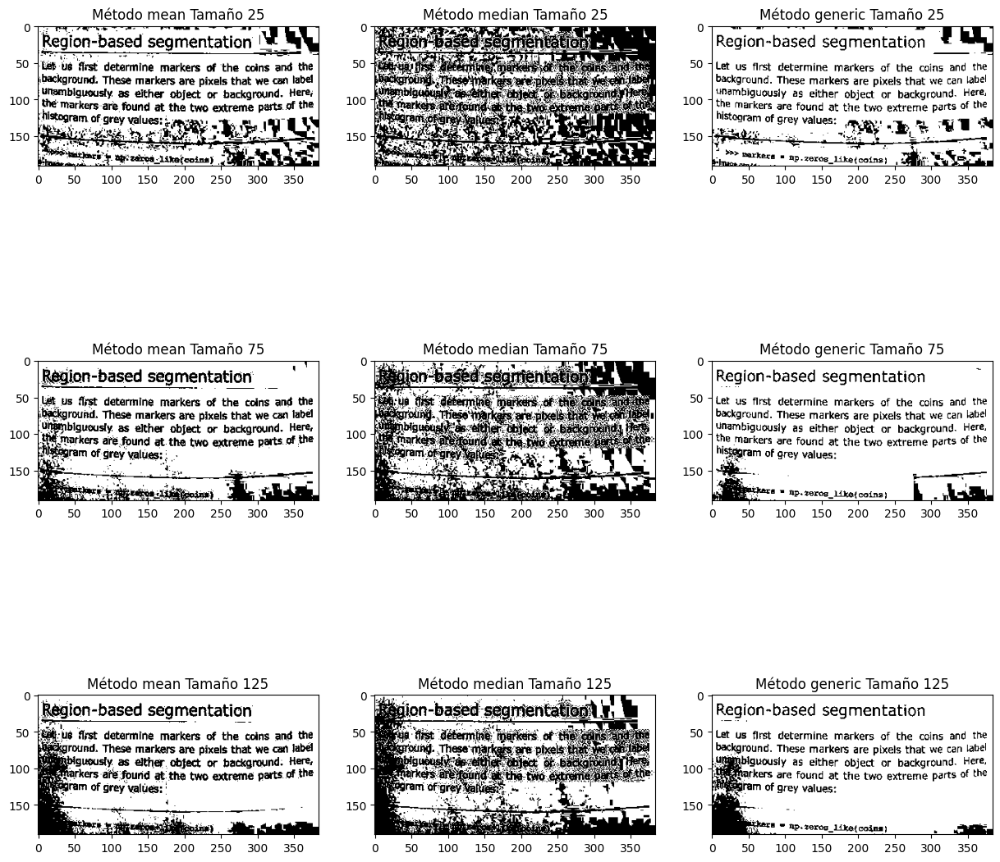

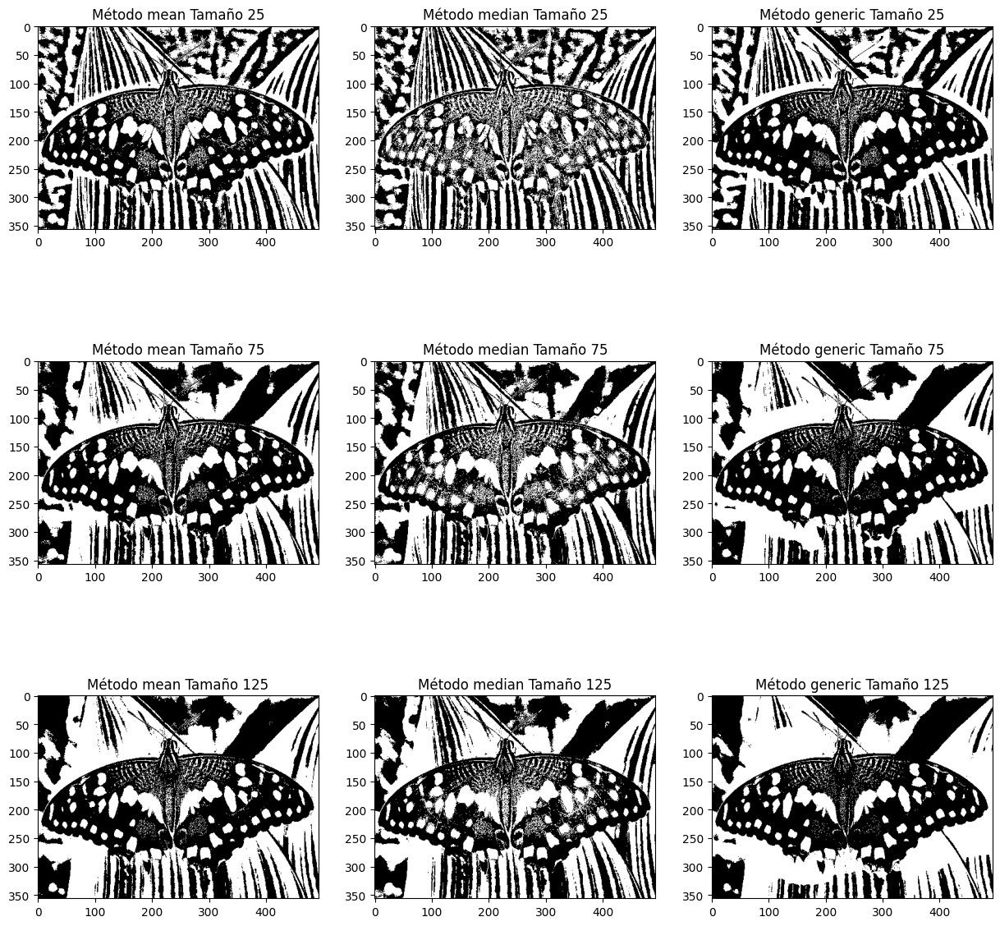

In [5]:
page = data.page()
butterfly = io.imread('butterfly.jpg', as_gray=True)

metodos = ['mean', 'median', 'generic']

# Tamaños de bloque
sizes = [25, 75, 125]

# Umbrales locales
def umbrales_locales(image, sizes, metodos):
    fig, ax = plt.subplots(len(sizes), len(metodos), figsize=(15, 15))
    for i, size in enumerate(sizes):
        for j, metodo in enumerate(metodos):
            if metodo == 'generic':
                umbral = threshold_local(image, block_size=size, method=metodo, param=threshold_otsu)
            else:
                umbral = threshold_local(image, block_size=size, method=metodo)

            ax[i, j].imshow(image > umbral, cmap='gray') # Si es mayor que el umbral, lo pintamos de blanco (True), será fondo
            ax[i, j].set_title('Método ' + metodo + ' Tamaño ' + str(size))
    plt.show()

# Aplicamos los umbrales locales a la imagen page
umbrales_locales(page, sizes, metodos)
# Aplicamos los umbrales locales a la imagen butterfly
umbrales_locales(butterfly, sizes, metodos)

- **Conclusión:**

    - La umbralización local nos ayuda a conseguir resultados algo mejores con la imagen de _page_ que como comentamos antes, tiene una iluminación desigual. El método de otsu para la determinación de los umbrales y el método mean son los que mejores resultados ofrecen. Por supuesto hay que tener mucho cuidado con que, al trabajar sobre histogramas locales pueden aparecer efectos de ruído no deseados.

    - Para la imagen de _butterfly_, la caracterísitca de que la propia mariposa tiene zonas negras y blancas provoca que la segmentación de fondo y animal sea muy complicada. Aunque ninguno de los métodos ofrece una buena segmentación, el método de otsu con un tamaño de bloque grande parece la mejor opción.

    El parámetro *block_size* determina el numero de píxeles que se utilizará para calcular cada uno de los umbrales locales. Si este valor es pequeño, se obtiene umbrales con pocos píxeles por lo que los resultados son más localizados y teniendo en cuenta que simplemente se clasifica cada bloque en imagen-fondo o texto-fondo, se pueden obtener ruídos no deseados. Si el valor es muy grande, la segmentación se hace en zonas más grandes de forma que es más similar a la umbralización global.

#### Ejercicio 7.3.- Análisis de componentes conexas

 La función `data.binary_blobs` permite generar imágenes aleatorias similares a la de la Figura 4. Las usaremos como imágenes de entrada, variando los parámetros *blob_size_fraction* y *volume_fraction*.

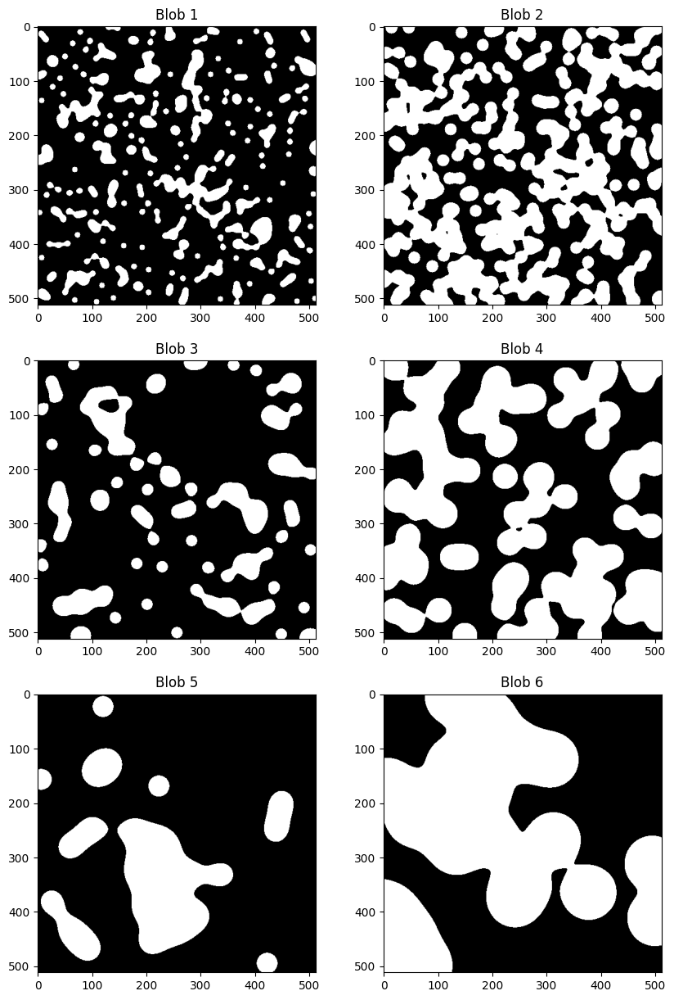

In [50]:
image_blob1 = data.binary_blobs(length=512, blob_size_fraction=0.05, volume_fraction=0.2)
image_blob2 = data.binary_blobs(length=512, blob_size_fraction=0.05, volume_fraction=0.5)
image_blob3 = data.binary_blobs(length=512, blob_size_fraction=0.1, volume_fraction=0.2)
image_blob4 = data.binary_blobs(length=512, blob_size_fraction=0.1, volume_fraction=0.5)
image_blob5 = data.binary_blobs(length=512, blob_size_fraction=0.2, volume_fraction=0.2)
image_blob6 = data.binary_blobs(length=512, blob_size_fraction=0.2, volume_fraction=0.5)

images = [image_blob1, image_blob2, image_blob3, image_blob4, image_blob5, image_blob6]

# Mostramos las imágenes
fig, ax = plt.subplots(3, 2, figsize=(10, 15))
for i, image in enumerate(images):
    ax[i//2, i%2].imshow(image, cmap='gray')
    ax[i//2, i%2].set_title('Blob ' + str(i+1))
plt.show()

- **Aclaración**: 

    - `blob_size_fraction`: Define el tamaño aproximado de cada blob como fracción del tamaño total de la imagen. Un valor pequeño significa que los blobs serán pequeños y un valor grande significa que los blobs serán grandes.

    - `volume_fraction`: Indica qué proporción de la imagen estará cubierta por blobs (zonas con valor 1).

    En la primera fila de imágenes se representan blobs pequeños cubriendo el 20% y el 50% respectivamente. En la segunda fila el tamaño de los blobs es más grande y cubren las mismas proporciones y en la tercera y última fila los blobs son de gran tamaño y cubren el 20% y el 50%.

Sobre estas imágenes:

1. Use la función `measure.label`, para etiquetar cada una de las componentes conexas en la imagen, y visualicelas de forma que cada objeto aparezca de un color o nivel de gris apreciablemente diferente

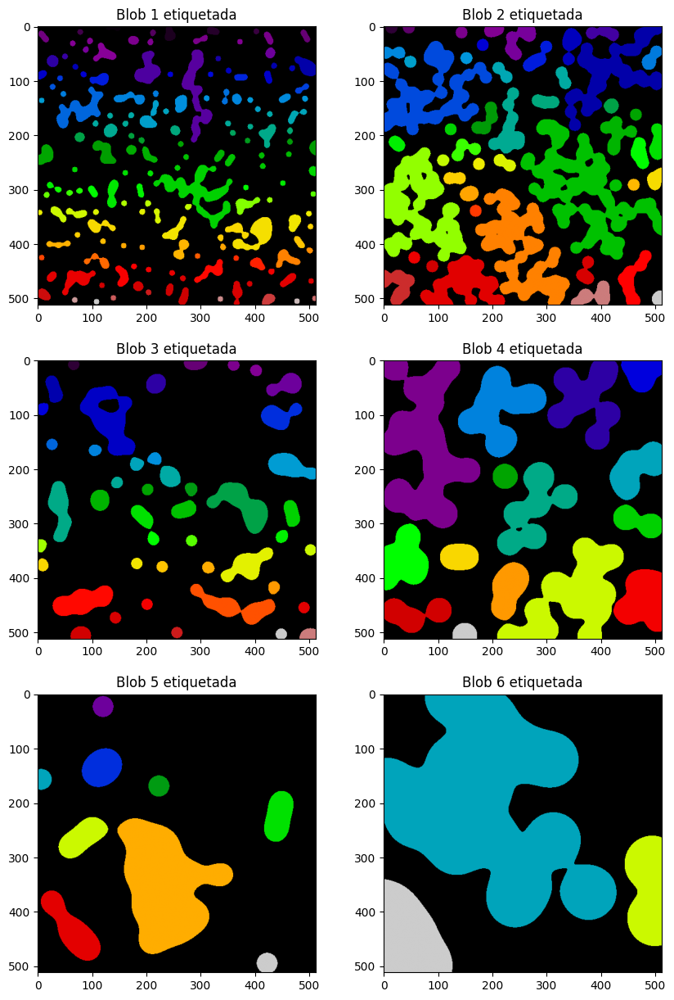

In [51]:
# Etiquetamos las imágenes
labels = [measure.label(image) for image in images]

# Mostramos las imágenes etiquetadas
fig, ax = plt.subplots(3, 2, figsize=(10, 15))
for i, label in enumerate(labels):
    # Creamos un colormap con tantos colores como etiquetas y fondo negro
    ax[i//2, i%2].imshow(label, cmap='nipy_spectral')
    ax[i//2, i%2].set_title('Blob ' + str(i+1) + ' etiquetada')
plt.show()

- **Aclaración**: 

    En las primeras imagenes, al tener un tamaño de blob muy pequeño, tenemos una gran cantidad de blobs y por lo tanto la imagen resultante tiene un gran número de etiquetas. Aunque parece que varios se representan con el mismo color, esto se debe a que hay muchas etiquetas y estamos trabajando con un espacio de color continuo por lo que los colores son muy parecidos entre ellos.

    Cuando el número de blobs es más reducido se ve bien como cada uno es etiquetado de forma diferente y por lo tanto se ve cada uno de los blobs con un color diferente.

2. Con el resultado de la función anterior, y haciendo uso de la función `measure.regionprops`, imprima por pantalla el número de componentes conexas, así como la media y desviación típica de sus áreas.

In [52]:
for i, label in enumerate(labels):
    # Obtenemos las propiedades de las regiones
    props = measure.regionprops(label)
    
    # Calculamos el número de componentes conexas
    num_componentes = len(props)
    
    # Calculamos el área de cada componente
    areas = [prop.area for prop in props]
    
    # Calculamos la media y desviación típica de las áreas
    media_area = round(np.mean(areas),3)
    desviacion_area = round(np.std(areas),3)
    
    print('Imagen blob ' + str(i+1) + ':')
    print(' - Número de componentes conexas: ' + str(num_componentes))
    print(' - Media de áreas: ' + str(media_area))
    print(' - Desviación típica de áreas: ' + str(desviacion_area))
    print('')

Imagen blob 1:
 - Número de componentes conexas: 161
 - Media de áreas: 325.646
 - Desviación típica de áreas: 572.908

Imagen blob 2:
 - Número de componentes conexas: 47
 - Media de áreas: 2788.766
 - Desviación típica de áreas: 5097.877

Imagen blob 3:
 - Número de componentes conexas: 45
 - Media de áreas: 1165.089
 - Desviación típica de áreas: 1437.446

Imagen blob 4:
 - Número de componentes conexas: 15
 - Media de áreas: 8738.133
 - Desviación típica de áreas: 7457.334

Imagen blob 5:
 - Número de componentes conexas: 9
 - Media de áreas: 5825.444
 - Desviación típica de áreas: 8687.018

Imagen blob 6:
 - Número de componentes conexas: 3
 - Media de áreas: 43690.667
 - Desviación típica de áreas: 42832.594



- **Conclusión**: 

    - Conforme se aumentan los valores de los parámetros, el número de componentes conexas disminuye. En la primera fila, con blobs pequeños, el número de componentes es muy alto (más de 150 en la imagen 1) y en la última fila, con blobs grandes, el número de componentes es muy bajo.

    - La media de las áreas nos da una idea del tamaño de los blobs en cada una de las imágenes.

    - La desviación típica nos indica la variabilidad de los tamaños de los blobs, es decir, si todos los blobs son del mismo tamaño o si hay una gran variabilidad entre ellos. Un valor grande de desviación típica indica que los tamaños son muy diferentes (obviamente esta medida depende de la escala, si los blobs son grandes la desviación típica tenderá a ser mayor que si son pequeños).